# 1. Nodule Dataset

## Summary
 
加載掃描並轉換為Hu
通過標準化處理圖像，然後去除肺組織以外的所有東西
[[通過從list3.2 csv文件加載結節坐標並在該坐標上使用cellmagicwand工具來生成結節掩模

In [108]:
#EDIT HERE##############################

#File paths
metadatapath="D:/Downloads/ALL_CANCER_NODULE_DETECTION_PROJECT_1/LungNoduleDetectionClassification-master/LIDC/LIDC-IDRI_MetaData.csv"
list32path="D:/Downloads/ALL_CANCER_NODULE_DETECTION_PROJECT_1/LungNoduleDetectionClassification-master/LIDC/list3.2.csv"
DOIfolderpath='D:/Downloads/ALL_CANCER_NODULE_DETECTION_PROJECT_1/LungNoduleDetectionClassification-master/LIDC/DOI/'
datafolder='D:/Downloads/ALL_CANCER_NODULE_DETECTION_PROJECT_1/LungNoduleDetectionClassification-master/processeddata'

########################################

import cell_magic_wand as cmw
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import dicom
import os
import scipy.ndimage
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import time

from skimage import measure, morphology
#from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from sklearn.cluster import KMeans
from skimage.transform import resize
from skimage.draw import circle

#Load metadata
meta=pd.read_csv(metadatapath)
# 丟掉不是CT類型的
meta=meta.drop(meta[meta['Modality']!='CT'].index)
meta=meta.reset_index()

#Load nodules locations
nodulelocations=pd.read_csv(list32path)


# 總長度為1018
print(len(meta))

#Get folder names of CT data for each patient
# 原本長度為1018, 需縮減
# patients=[DOIfolderpath+meta['Patient Id'][i] for i in range(len(meta))]
patients=[DOIfolderpath+meta['Patient Id'][i] for i in range(len(meta))]
datfolder=[]

# patients 是檔案路徑

# 獲取 nodulelocations['scan'], 排除重複值
scan_number = list(nodulelocations['scan'].unique())
#print(scan_number[69])

meta_2 = 20
# 原本長度為1018, 需縮減
# for i in range(0,len(meta)-1):
for i in range(0,100):
    for path in os.listdir(patients[i]):
        # 如果符合此路徑底下
        # 原本 if os.path.exists(patients[i]+'/'+path+'/'+meta['Series UID'][i]):
        # 提取'Series UID'後五字作為資料夾搜尋條件
        if os.path.exists(patients[i]+'/'+path+'/'+str(scan_number[i])+"-"+str(meta['Series UID'][i][-5:-1]) + str(meta['Series UID'][i][-1])):
            # 原 datfolder.append(patients[i]+'/'+path+'/'+meta['Series UID'][i])
            datfolder.append(patients[i]+'/'+path+'/'+str(scan_number[i])+"-"+str(meta['Series UID'][i][-5:-1]) + str(meta['Series UID'][i][-1]))
            # 印出路徑( 檢查用 )
            #print(patients[i]) # 印出找到的資料夾
            #print(str(path))  # 印出找到的資料夾
            print(datfolder)
patients=datfolder
#patients

#Load nodules locations
#nodulelocations=pd.read_csv(list32path)

# transfer to dataframe
path_patients = pd.DataFrame(patients)
# find the LIDC number
path_patients.columns = ['path']
path_patients["path"].str.split("/").str.get(6).str.title().head(100)

# 印出行數
#path_patients.shape

1018
['D:/Downloads/ALL_CANCER_NODULE_DETECTION_PROJECT_1/LungNoduleDetectionClassification-master/LIDC/DOI/LIDC-IDRI-0001/01-01-2000-30178/3000566-03192']
['D:/Downloads/ALL_CANCER_NODULE_DETECTION_PROJECT_1/LungNoduleDetectionClassification-master/LIDC/DOI/LIDC-IDRI-0001/01-01-2000-30178/3000566-03192', 'D:/Downloads/ALL_CANCER_NODULE_DETECTION_PROJECT_1/LungNoduleDetectionClassification-master/LIDC/DOI/LIDC-IDRI-0002/01-01-2000-98329/3000522-04919']
['D:/Downloads/ALL_CANCER_NODULE_DETECTION_PROJECT_1/LungNoduleDetectionClassification-master/LIDC/DOI/LIDC-IDRI-0001/01-01-2000-30178/3000566-03192', 'D:/Downloads/ALL_CANCER_NODULE_DETECTION_PROJECT_1/LungNoduleDetectionClassification-master/LIDC/DOI/LIDC-IDRI-0002/01-01-2000-98329/3000522-04919', 'D:/Downloads/ALL_CANCER_NODULE_DETECTION_PROJECT_1/LungNoduleDetectionClassification-master/LIDC/DOI/LIDC-IDRI-0003/01-01-2000-94866/3000611-03264']
['D:/Downloads/ALL_CANCER_NODULE_DETECTION_PROJECT_1/LungNoduleDetectionClassification-maste

0     Lidc-Idri-0001
1     Lidc-Idri-0002
2     Lidc-Idri-0003
3     Lidc-Idri-0004
4     Lidc-Idri-0005
5     Lidc-Idri-0006
6     Lidc-Idri-0007
7     Lidc-Idri-0008
8     Lidc-Idri-0009
9     Lidc-Idri-0010
10    Lidc-Idri-0011
11    Lidc-Idri-0012
12    Lidc-Idri-0013
13    Lidc-Idri-0014
14    Lidc-Idri-0015
15    Lidc-Idri-0016
16    Lidc-Idri-0017
17    Lidc-Idri-0018
18    Lidc-Idri-0019
19    Lidc-Idri-0020
20    Lidc-Idri-0021
21    Lidc-Idri-0022
22    Lidc-Idri-0023
23    Lidc-Idri-0024
24    Lidc-Idri-0025
25    Lidc-Idri-0026
26    Lidc-Idri-0027
27    Lidc-Idri-0028
28    Lidc-Idri-0029
29    Lidc-Idri-0030
           ...      
70    Lidc-Idri-0071
71    Lidc-Idri-0072
72    Lidc-Idri-0073
73    Lidc-Idri-0074
74    Lidc-Idri-0075
75    Lidc-Idri-0076
76    Lidc-Idri-0077
77    Lidc-Idri-0078
78    Lidc-Idri-0079
79    Lidc-Idri-0080
80    Lidc-Idri-0081
81    Lidc-Idri-0082
82    Lidc-Idri-0083
83    Lidc-Idri-0084
84    Lidc-Idri-0085
85    Lidc-Idri-0086
86    Lidc-Id

In [109]:
# 印出所有 number
scan_number = list(nodulelocations["scan"].unique())
scan_number

[3000566,
 3000522,
 3000611,
 3000534,
 3000548,
 3000556,
 3000631,
 3000549,
 3000538,
 3000518,
 3000559,
 3000561,
 3000551,
 3000562,
 3000610,
 3000580,
 3000613,
 3000550,
 3000523,
 3000525,
 3000570,
 3000630,
 3000628,
 3000557,
 3000524,
 3000519,
 3000614,
 3000563,
 3000545,
 3000576,
 3000608,
 3000537,
 3000546,
 3000516,
 3000582,
 3000521,
 3000573,
 3000554,
 3000517,
 3000578,
 3000568,
 3000579,
 3000629,
 3000571,
 3000547,
 3000577,
 3000552,
 3000624,
 3000627,
 3000572,
 3000609,
 3000625,
 3000615,
 3000565,
 3000581,
 3000535,
 3000514,
 3000626,
 3000564,
 3000575,
 3000560,
 3000558,
 3000555,
 3000612,
 3000536,
 5576,
 3000708,
 4,
 3079,
 3000667,
 3000071,
 3000072,
 3000698,
 3000704,
 30083,
 3000734,
 3000706,
 3165,
 3278,
 3000733,
 3000649,
 3000701,
 3000646,
 3211,
 30084,
 5604,
 3000640,
 3000088,
 3000707,
 3000090,
 3000091,
 3000774,
 3000688,
 5587,
 5610,
 3000693,
 3000738,
 3094,
 3000655,
 3000100,
 3192,
 3000670,
 5519,
 5597,
 30006

In [110]:
# Load the scans in given folder path
# 將掃描加載到給定的文件夾路徑中
# code sourced from https://www.kaggle.com/gzuidhof/full-preprocessing-tutorial
def load_scan(path):
    slices = [dicom.read_file(path + '/' + s, force=True) for s in os.listdir(path) if s.endswith('.dcm')]
    #print(str(slices))
    
    slices.sort(key = lambda x: float(x.ImagePositionPatient[2]), reverse=True)
    try:
        slice_thickness = np.abs(slices[0].ImagePositionPatient[2] - slices[1].ImagePositionPatient[2])
    except:
        slice_thickness = np.abs(slices[0].SliceLocation - slices[1].SliceLocation)
        
    for s in slices:
        s.SliceThickness = slice_thickness
        
    return slices

# convert to ndarray
# 取得pixel換成Hu值, 並轉換為ndarray
def get_pixels_hu(slices):
    image = np.stack([s.pixel_array for s in slices])
    # Convert to int16 (from sometimes int16), 
    # should be possible as values should always be low enough (<32k)
    image = image.astype(np.int16)

    # Set outside-of-scan pixels to 0
    # The intercept is usually -1024, so air is approximately 0
    image[image == -2000] = 0
    
    # Convert to Hounsfield units (HU)
    for slice_number in range(len(slices)):
        
        intercept = slices[slice_number].RescaleIntercept
        slope = slices[slice_number].RescaleSlope
        
        if slope != 1:
            image[slice_number] = slope * image[slice_number].astype(np.float64)
            image[slice_number] = image[slice_number].astype(np.int16)
            
        image[slice_number] += np.int16(intercept)
    
    return np.array(image, dtype=np.int16)

def largest_label_volume(im, bg=-1):
    vals, counts = np.unique(im, return_counts=True)

    counts = counts[vals != bg]
    vals = vals[vals != bg]

    if len(counts) > 0:
        return vals[np.argmax(counts)]
    else:
        return None
    
def segment_lung_mask(image, fill_lung_structures=True, dilate=False):
    
    # not actually binary, but 1 and 2. 
    # 0 is treated as background, which we do not want
    binary_image = np.array(image > -320, dtype=np.int8)+1
    labels = measure.label(binary_image)
    
    # Pick the pixel in the very corner to determine which label is air.
    #   Improvement: Pick multiple background labels from around the patient
    #   More resistant to "trays" on which the patient lays cutting the air 
    #   around the person in half
    background_label = labels[0,0,0]
    
    #Fill the air around the person
    binary_image[background_label == labels] = 2
    
    # Method of filling the lung structures (that is superior to something like 
    # morphological closing)
    if fill_lung_structures==True:
        # For every slice we determine the largest solid structure
        for i, axial_slice in enumerate(binary_image):
            axial_slice = axial_slice - 1
            labeling = measure.label(axial_slice)
            l_max = largest_label_volume(labeling, bg=0)
            
            if l_max is not None: #This slice contains some lung
                binary_image[i][labeling != l_max] = 1

    
    binary_image -= 1 #Make the image actual binary
    binary_image = 1-binary_image # Invert it, lungs are now 1
    
    # Remove other air pockets insided body
    labels = measure.label(binary_image, background=0)
    l_max = largest_label_volume(labels, bg=0)
    if l_max is not None: # There are air pockets
        binary_image[labels != l_max] = 0
    
    if dilate==True:
        for i in range(binary_image.shape[0]):
            binary_image[i]=morphology.dilation(binary_image[i],np.ones([10,10]))
    return binary_image

# 依序讀入 patients(LIDC-IDRI_MetaData.csv), nodulelocations(list3.2.csv)
1.獲取 CT所在資料夾路徑(patients['N']), 另存成first_patient  
2.從first_patient中get所有切片的Hounsfield Units (HU), 另存成first_patient_pixels  
3.印出 Hounsfield Units (HU) 分佈    
4.獲取 結節所在之切片位置(first_patient_pixels['N']), 其中'N'代表第幾張切片(From nodulelocations['slice no.'-1]['N'])  
5.獲取 結節所在之X,Y位置(From (nodulelocations['x loc.']['N'], nodulelocations['y loc.']['N']))  
6.繪製箭頭 arrowprops=dict(arrowstyle="->")  
7.印出圖片

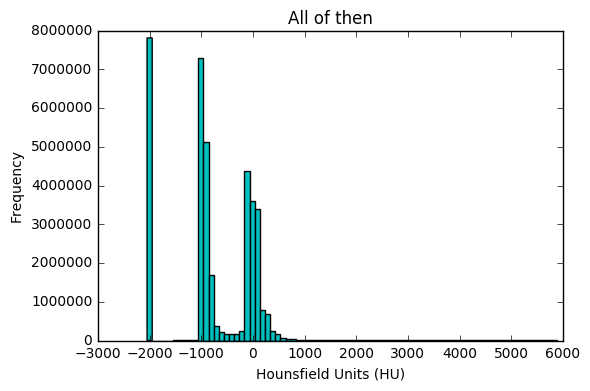

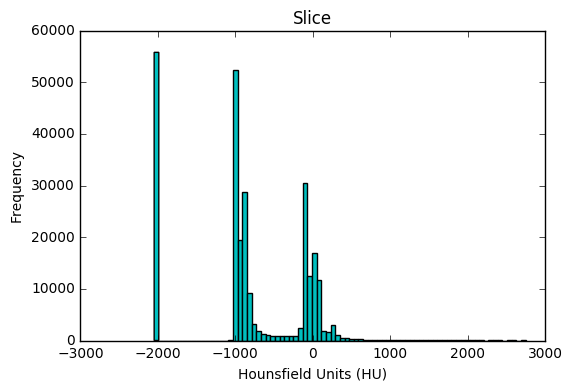

present = 3000566, next = 3000522
different number! 3000566
Lidc-Idri- 1
Slice no. 42
x = 317, y = 367


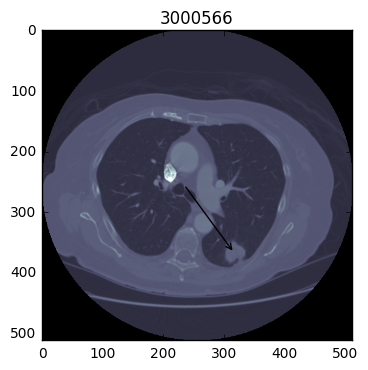

present = 3000522, next = 3000611
different number! 3000522
Lidc-Idri- 2
Slice no. 76
x = 345, y = 361


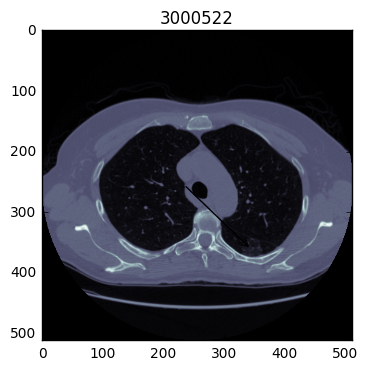

present = 3000611, next = 3000611
same number! 3000611
Lidc-Idri- 3
Slice no. 56
x = 308, y = 198


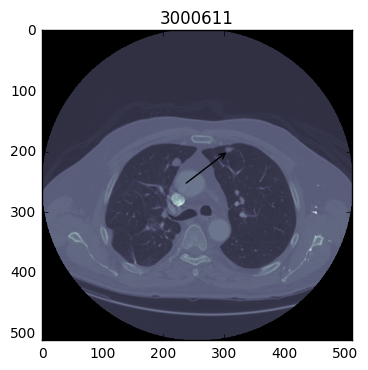

present = 3000611, next = 3000611
same number! 3000611
Lidc-Idri- 3
Slice no. 55
x = 221, y = 219


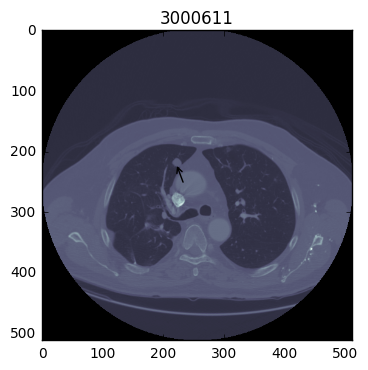

present = 3000611, next = 3000611
same number! 3000611
Lidc-Idri- 3
Slice no. 64
x = 367, y = 350


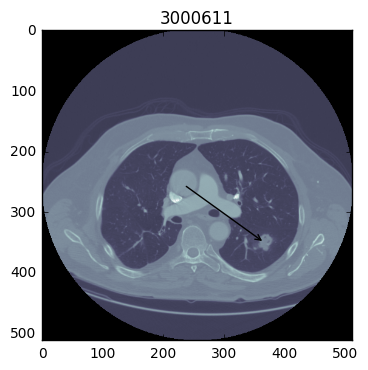

present = 3000611, next = 3000534
different number! 3000611
Lidc-Idri- 3
Slice no. 73
x = 369, y = 347


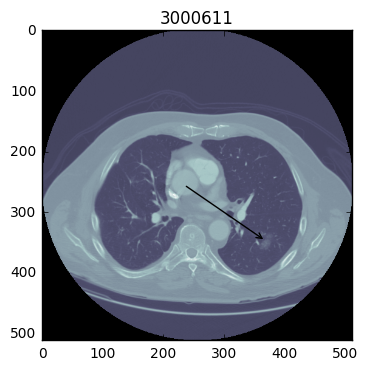

present = 3000534, next = 3000548
different number! 3000534
Lidc-Idri- 4
Slice no. 164
x = 142, y = 323


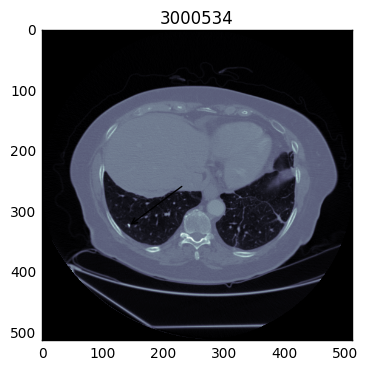

present = 3000548, next = 3000548
same number! 3000548
Lidc-Idri- 5
Slice no. 52
x = 313, y = 407


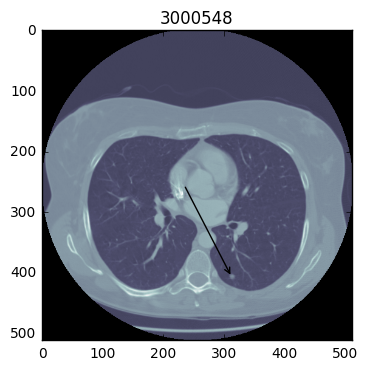

present = 3000548, next = 3000548
same number! 3000548
Lidc-Idri- 5
Slice no. 55
x = 127, y = 398


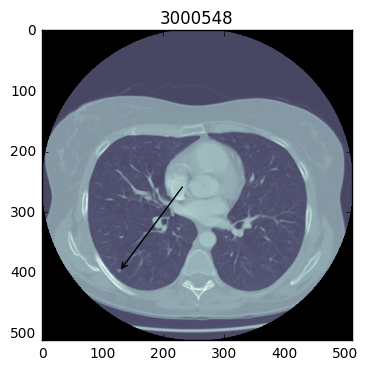

present = 3000548, next = 3000556
different number! 3000548
Lidc-Idri- 5
Slice no. 44
x = 407, y = 377


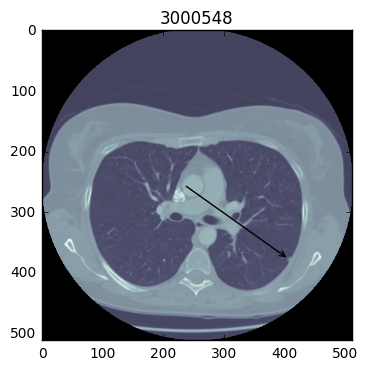

present = 3000556, next = 3000556
same number! 3000556
Lidc-Idri- 6
Slice no. 62
x = 363, y = 354


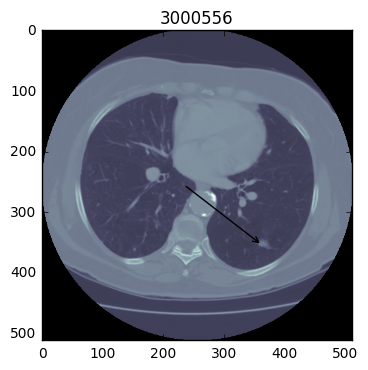

present = 3000556, next = 3000556
same number! 3000556
Lidc-Idri- 6
Slice no. 78
x = 191, y = 340


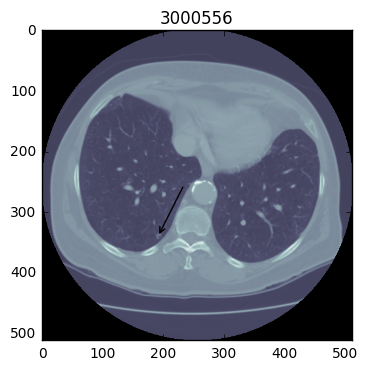

present = 3000556, next = 3000556
same number! 3000556
Lidc-Idri- 6
Slice no. 64
x = 392, y = 333


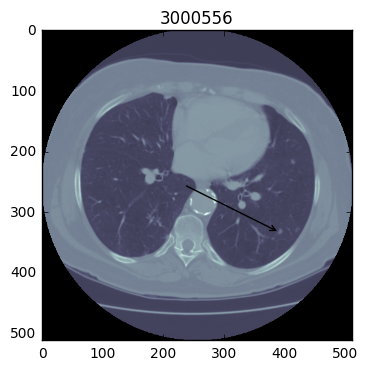

present = 3000556, next = 3000631
different number! 3000556
Lidc-Idri- 6
Slice no. 48
x = 371, y = 357


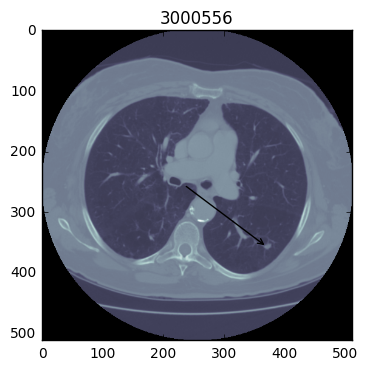

present = 3000631, next = 3000631
same number! 3000631
Lidc-Idri- 7
Slice no. 19
x = 293, y = 266


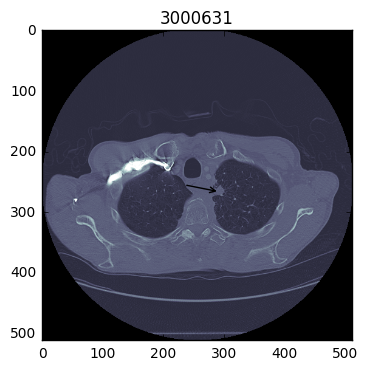

present = 3000631, next = 3000549
different number! 3000631
Lidc-Idri- 7
Slice no. 36
x = 194, y = 290


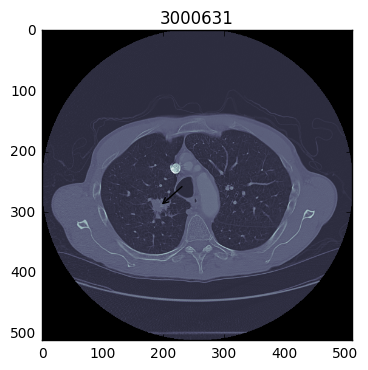

present = 3000549, next = 3000549
same number! 3000549
Lidc-Idri- 8
Slice no. 61
x = 123, y = 290


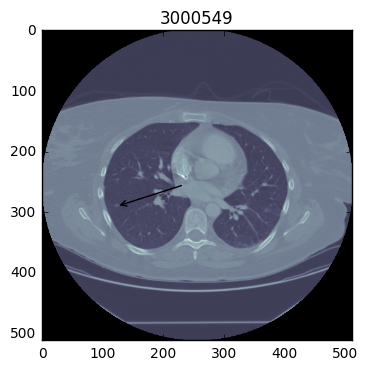

present = 3000549, next = 3000538
different number! 3000549
Lidc-Idri- 8
Slice no. 44
x = 369, y = 270


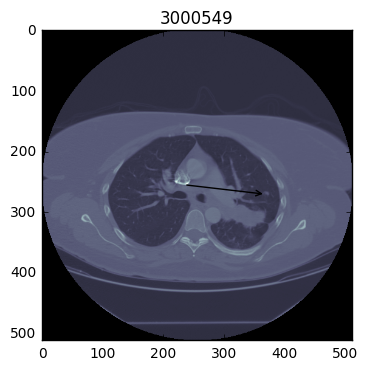

present = 3000538, next = 3000538
same number! 3000538
Lidc-Idri- 9
Slice no. 88
x = 304, y = 324


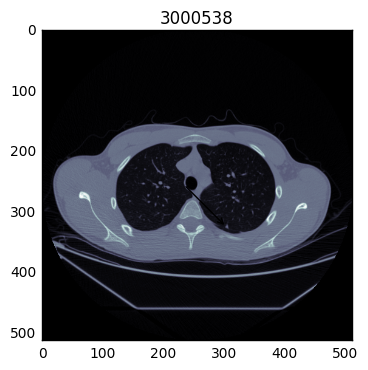

present = 3000538, next = 3000518
different number! 3000538
Lidc-Idri- 9
Slice no. 152
x = 202, y = 334


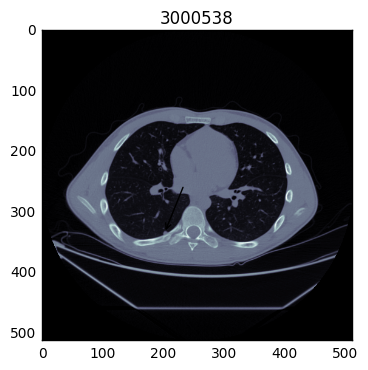

present = 3000518, next = 3000518
same number! 3000518
Lidc-Idri- 10
Slice no. 182
x = 345, y = 195


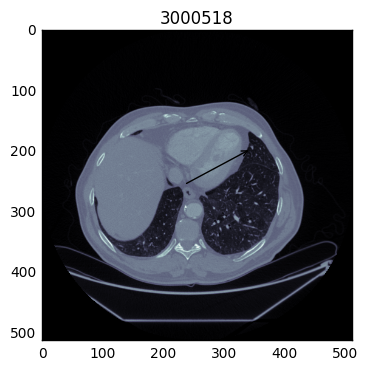

present = 3000518, next = 3000518
same number! 3000518
Lidc-Idri- 10
Slice no. 66
x = 300, y = 320


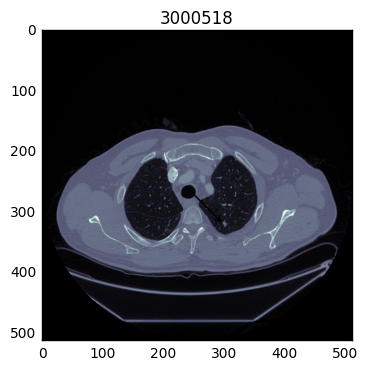

present = 3000518, next = 3000559
different number! 3000518
Lidc-Idri- 10
Slice no. 208
x = 279, y = 355


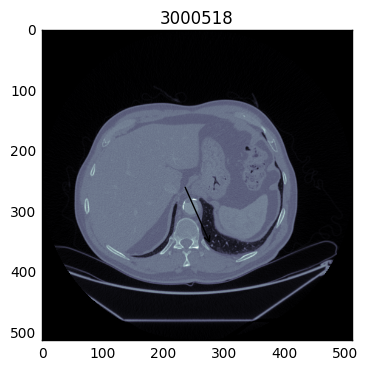

present = 3000559, next = 3000559
same number! 3000559
Lidc-Idri- 11
Slice no. 66
x = 306, y = 330


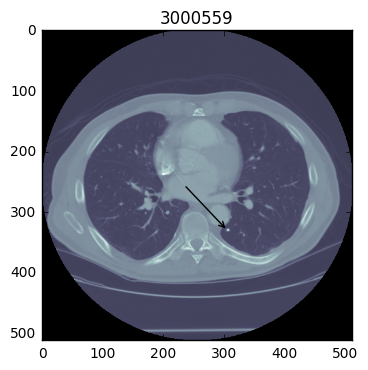

present = 3000559, next = 3000559
same number! 3000559
Lidc-Idri- 11
Slice no. 79
x = 68, y = 285


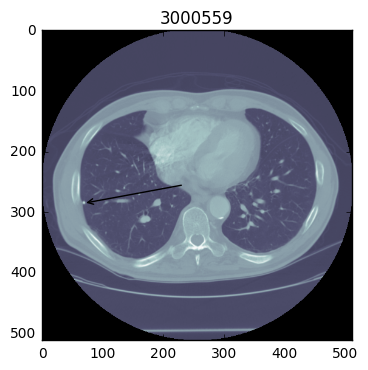

present = 3000559, next = 3000559
same number! 3000559
Lidc-Idri- 11
Slice no. 23
x = 189, y = 198


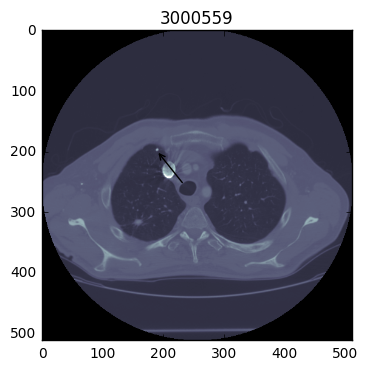

present = 3000559, next = 3000559
same number! 3000559
Lidc-Idri- 11
Slice no. 68
x = 400, y = 189


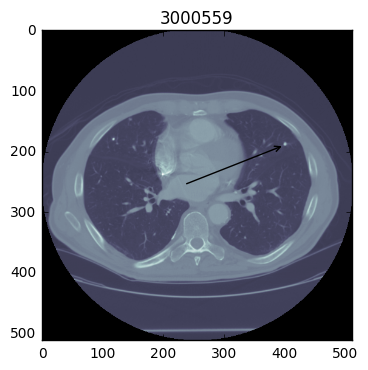

present = 3000559, next = 3000559
same number! 3000559
Lidc-Idri- 11
Slice no. 23
x = 158, y = 317


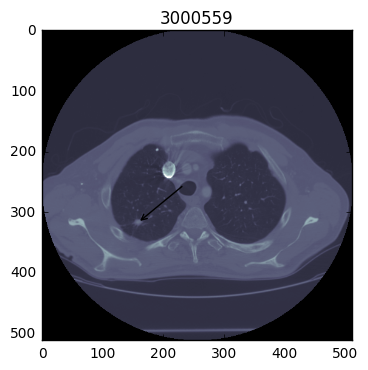

present = 3000559, next = 3000559
same number! 3000559
Lidc-Idri- 11
Slice no. 98
x = 111, y = 331


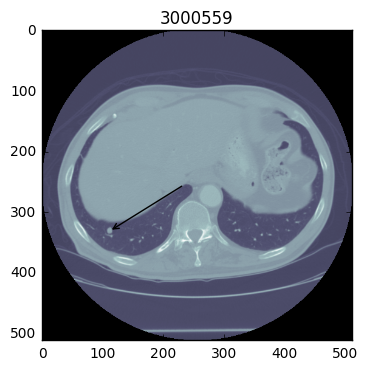

present = 3000559, next = 3000559
same number! 3000559
Lidc-Idri- 11
Slice no. 69
x = 144, y = 148


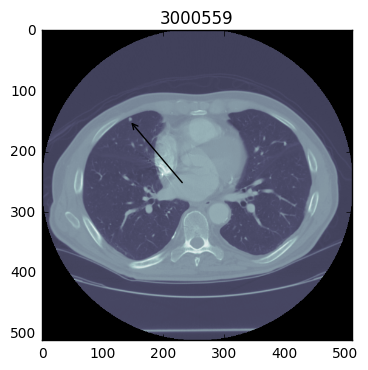

present = 3000559, next = 3000559
same number! 3000559
Lidc-Idri- 11
Slice no. 92
x = 357, y = 272


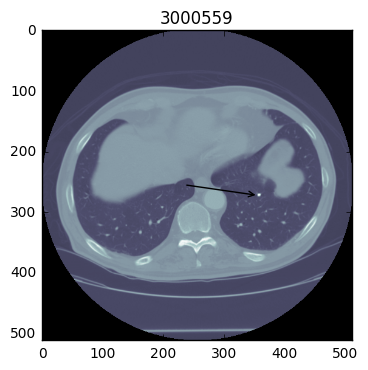

present = 3000559, next = 3000559
same number! 3000559
Lidc-Idri- 11
Slice no. 82
x = 361, y = 142


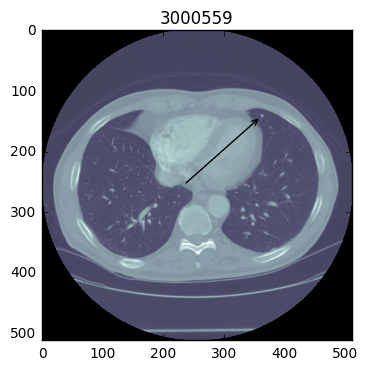

present = 3000559, next = 3000561
different number! 3000559
Lidc-Idri- 11
Slice no. 33
x = 330, y = 361


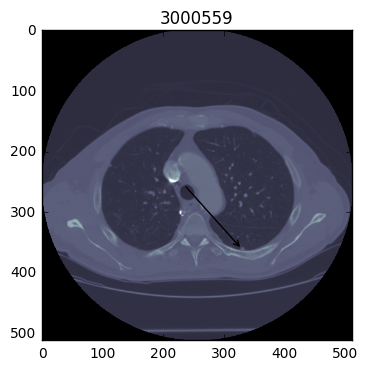

present = 3000561, next = 3000561
same number! 3000561
Lidc-Idri- 12
Slice no. 50
x = 371, y = 214


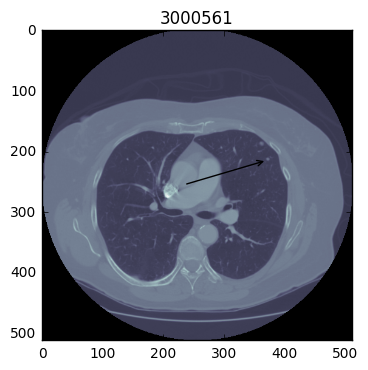

present = 3000561, next = 3000561
same number! 3000561
Lidc-Idri- 12
Slice no. 48
x = 335, y = 194


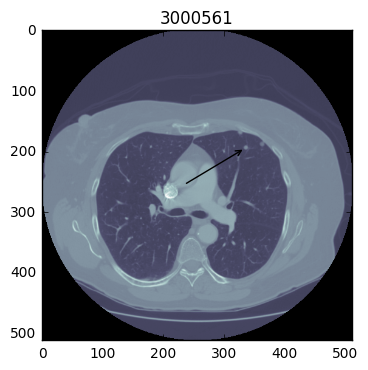

present = 3000561, next = 3000561
same number! 3000561
Lidc-Idri- 12
Slice no. 48
x = 326, y = 170


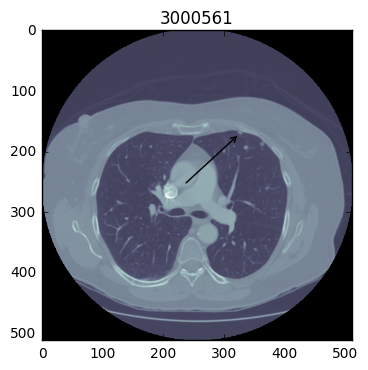

present = 3000561, next = 3000561
same number! 3000561
Lidc-Idri- 12
Slice no. 49
x = 361, y = 188


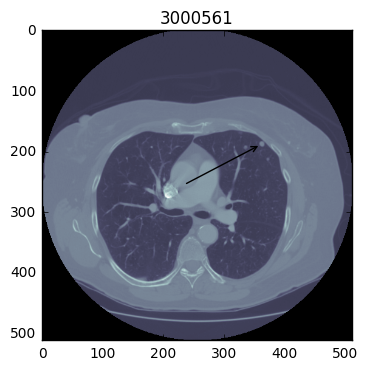

present = 3000561, next = 3000561
same number! 3000561
Lidc-Idri- 12
Slice no. 70
x = 164, y = 366


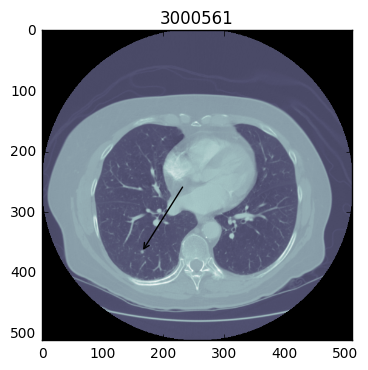

present = 3000561, next = 3000561
same number! 3000561
Lidc-Idri- 12
Slice no. 56
x = 314, y = 200


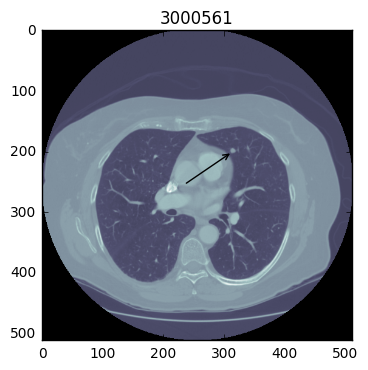

present = 3000561, next = 3000561
same number! 3000561
Lidc-Idri- 12
Slice no. 63
x = 387, y = 296


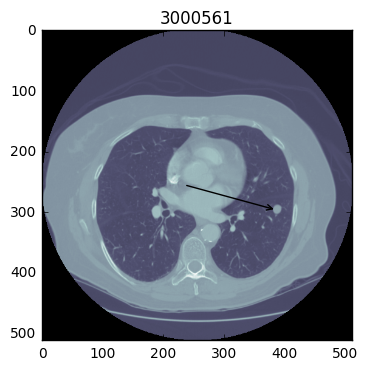

present = 3000561, next = 3000561
same number! 3000561
Lidc-Idri- 12
Slice no. 44
x = 162, y = 374


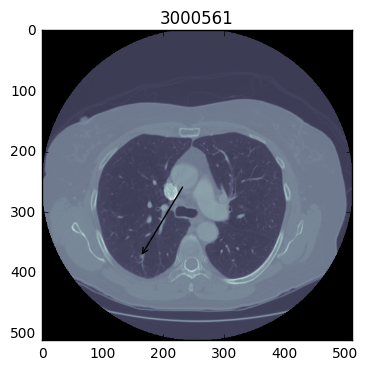

present = 3000561, next = 3000561
same number! 3000561
Lidc-Idri- 12
Slice no. 82
x = 135, y = 205


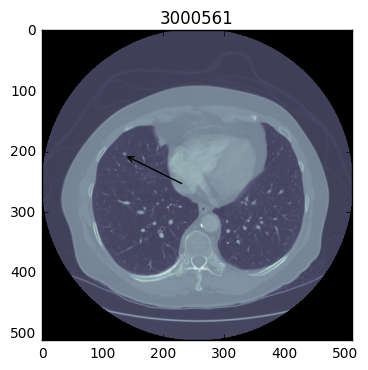

present = 3000561, next = 3000561
same number! 3000561
Lidc-Idri- 12
Slice no. 74
x = 390, y = 216


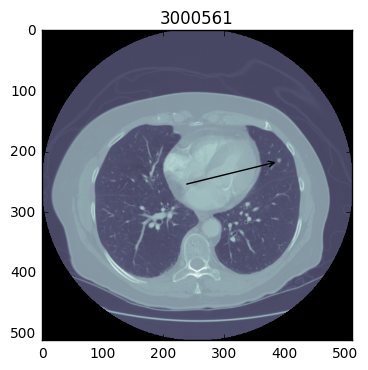

present = 3000561, next = 3000561
same number! 3000561
Lidc-Idri- 12
Slice no. 60
x = 365, y = 216


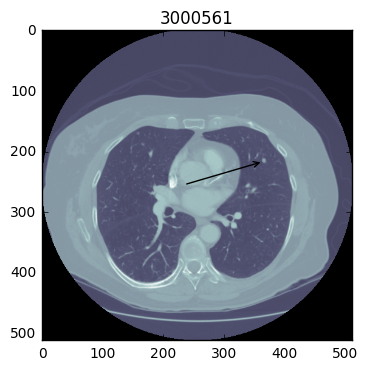

present = 3000561, next = 3000551
different number! 3000561
Lidc-Idri- 12
Slice no. 61
x = 158, y = 171


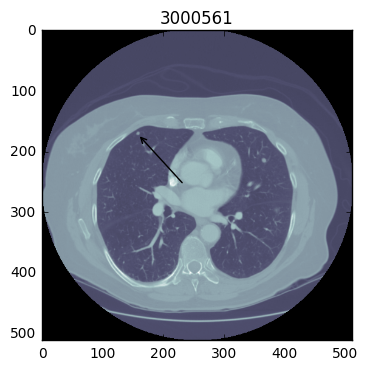

present = 3000551, next = 3000551
same number! 3000551
Lidc-Idri- 13
Slice no. 33
x = 191, y = 145


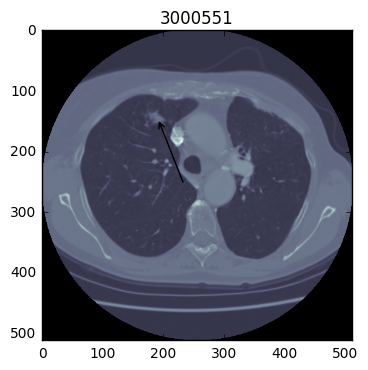

present = 3000551, next = 3000551
same number! 3000551
Lidc-Idri- 13
Slice no. 86
x = 313, y = 293


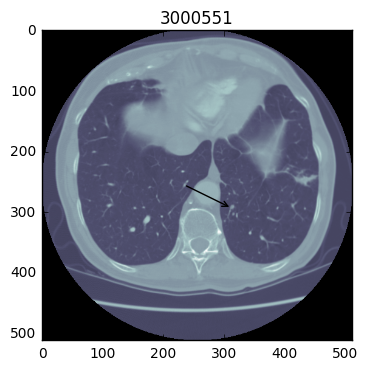

present = 3000551, next = 3000562
different number! 3000551
Lidc-Idri- 13
Slice no. 40
x = 178, y = 182


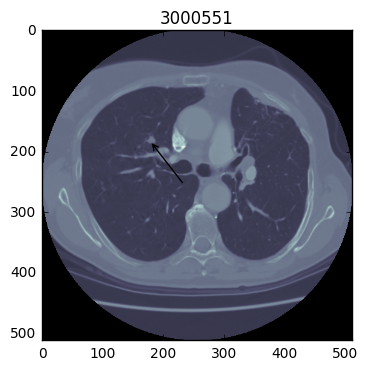

present = 3000562, next = 3000610
different number! 3000562
Lidc-Idri- 14
Slice no. 39
x = 357, y = 276


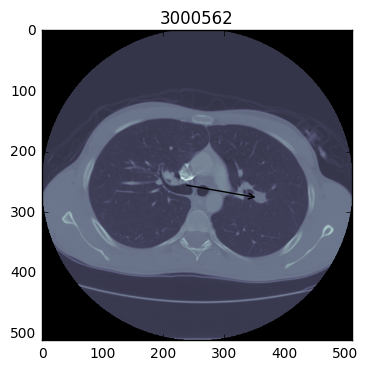

present = 3000610, next = 3000580
different number! 3000610
Lidc-Idri- 15
Slice no. 29
x = 315, y = 254


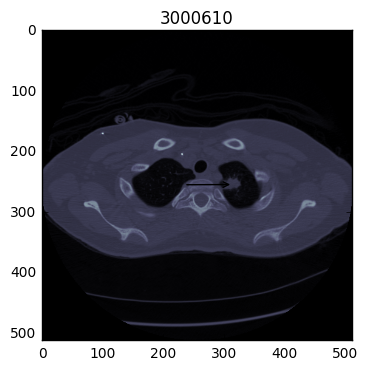

present = 3000580, next = 3000580
same number! 3000580
Lidc-Idri- 16
Slice no. 59
x = 425, y = 239


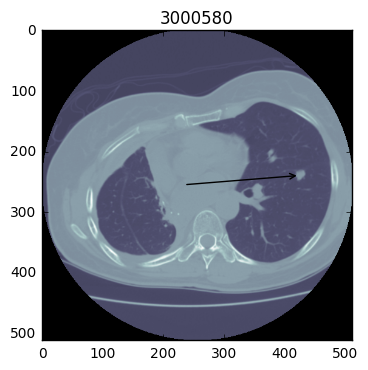

present = 3000580, next = 3000580
same number! 3000580
Lidc-Idri- 16
Slice no. 31
x = 141, y = 283


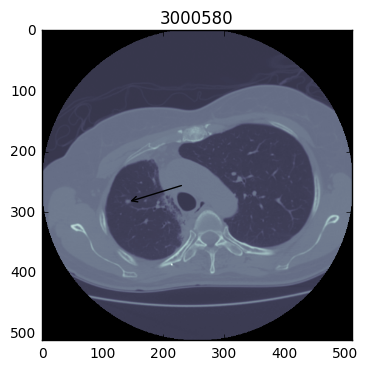

present = 3000580, next = 3000580
same number! 3000580
Lidc-Idri- 16
Slice no. 44
x = 379, y = 194


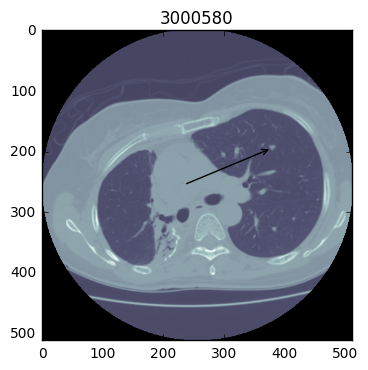

present = 3000580, next = 3000580
same number! 3000580
Lidc-Idri- 16
Slice no. 66
x = 438, y = 182


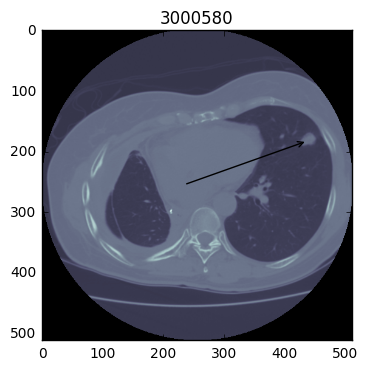

present = 3000580, next = 3000580
same number! 3000580
Lidc-Idri- 16
Slice no. 11
x = 341, y = 276


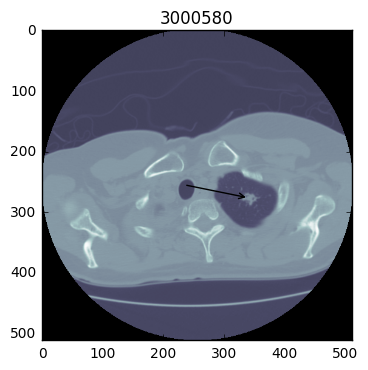

present = 3000580, next = 3000613
different number! 3000580
Lidc-Idri- 16
Slice no. 50
x = 430, y = 342


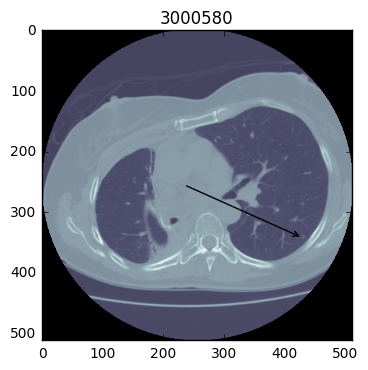

present = 3000613, next = 3000550
different number! 3000613
Lidc-Idri- 17
Slice no. 75
x = 313, y = 337


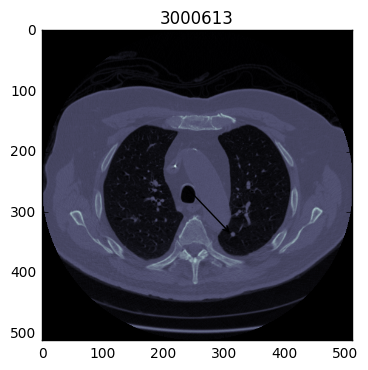

present = 3000550, next = 3000550
same number! 3000550
Lidc-Idri- 18
Slice no. 17
x = 364, y = 310


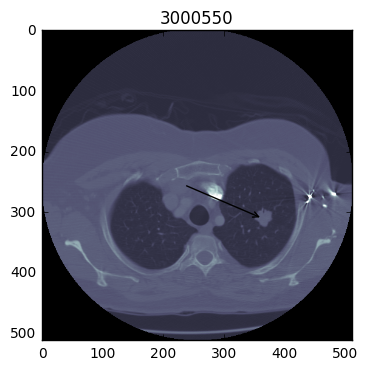

present = 3000550, next = 3000550
same number! 3000550
Lidc-Idri- 18
Slice no. 66
x = 91, y = 295


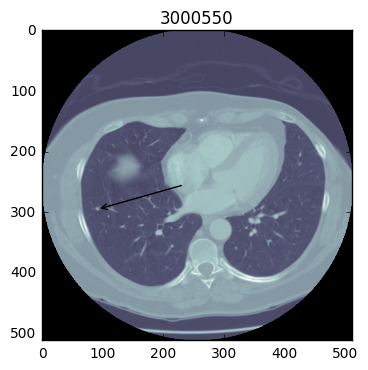

present = 3000550, next = 3000550
same number! 3000550
Lidc-Idri- 18
Slice no. 46
x = 379, y = 227


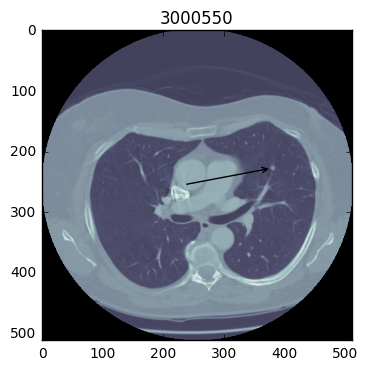

present = 3000550, next = 3000523
different number! 3000550
Lidc-Idri- 18
Slice no. 50
x = 439, y = 281


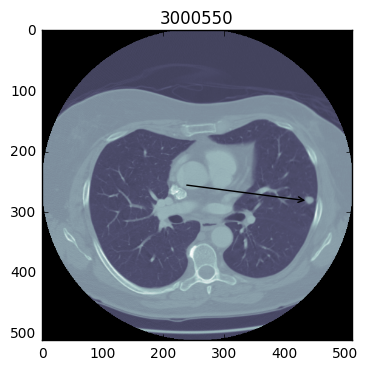

present = 3000523, next = 3000525
different number! 3000523
Lidc-Idri- 19
Slice no. 39
x = 180, y = 267


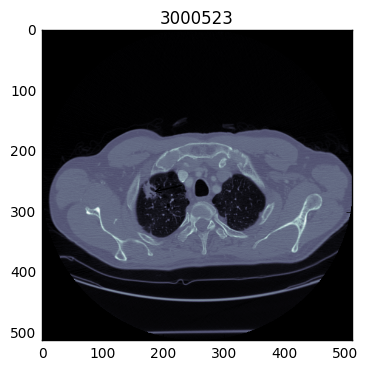

present = 3000525, next = 3000525
same number! 3000525
Lidc-Idri- 20
Slice no. 65
x = 316, y = 275


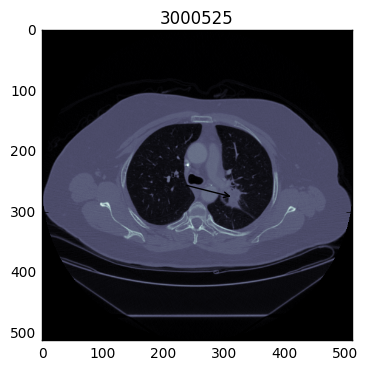

present = 3000525, next = 3000570
different number! 3000525
Lidc-Idri- 20
Slice no. 33
x = 310, y = 219


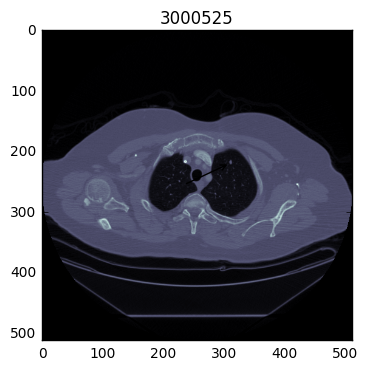

present = 3000570, next = 3000570
same number! 3000570
Lidc-Idri- 21
Slice no. 86
x = 352, y = 360


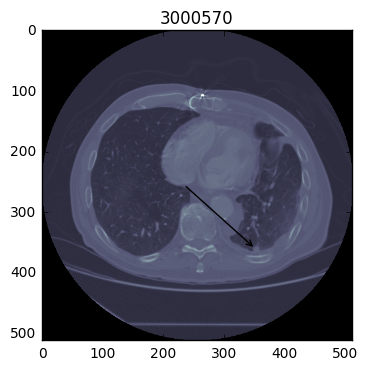

present = 3000570, next = 3000570
same number! 3000570
Lidc-Idri- 21
Slice no. 98
x = 390, y = 286


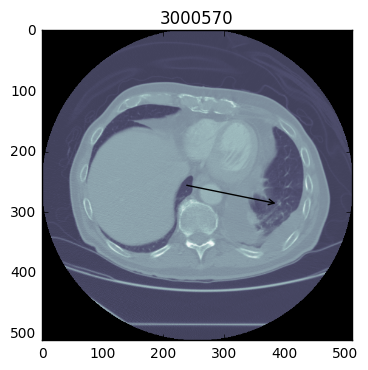

present = 3000570, next = 3000630
different number! 3000570
Lidc-Idri- 21
Slice no. 21
x = 180, y = 289


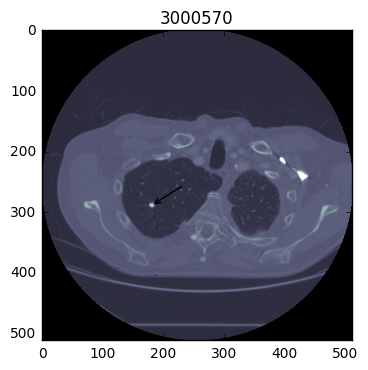

present = 3000630, next = 3000628
different number! 3000630
Lidc-Idri- 22
Slice no. 27
x = 201, y = 391


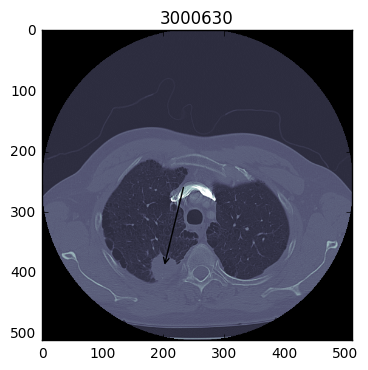

present = 3000628, next = 3000557
different number! 3000628
Lidc-Idri- 23
Slice no. 18
x = 317, y = 235


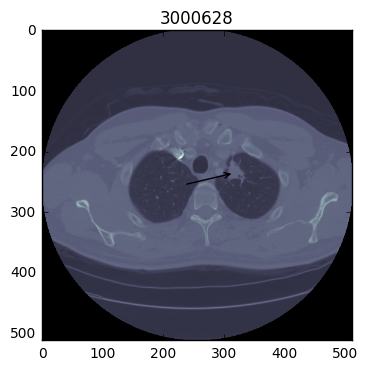

present = 3000557, next = 3000557
same number! 3000557
Lidc-Idri- 24
Slice no. 48
x = 353, y = 271


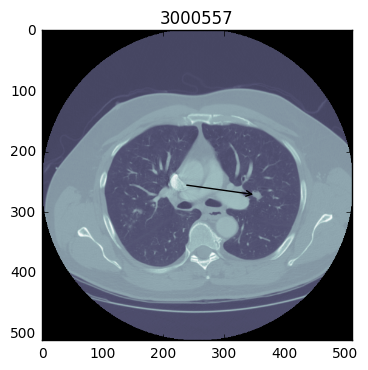

present = 3000557, next = 3000557
same number! 3000557
Lidc-Idri- 24
Slice no. 60
x = 167, y = 167


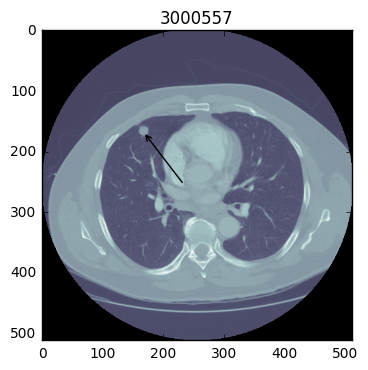

present = 3000557, next = 3000557
same number! 3000557
Lidc-Idri- 24
Slice no. 80
x = 365, y = 134


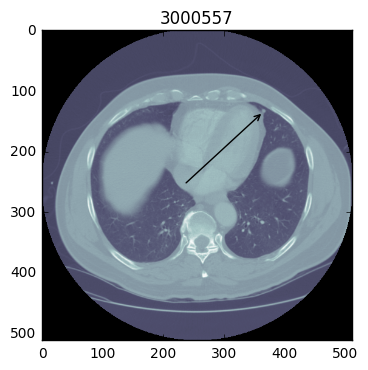

present = 3000557, next = 3000524
different number! 3000557
Lidc-Idri- 24
Slice no. 45
x = 331, y = 364


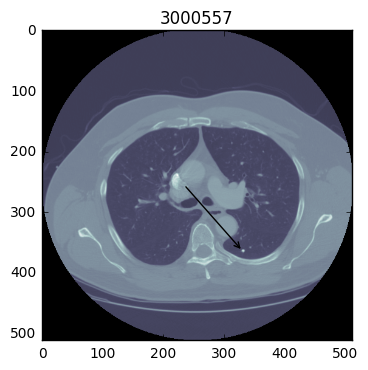

present = 3000524, next = 3000519
different number! 3000524
Lidc-Idri- 25
Slice no. 40
x = 195, y = 300


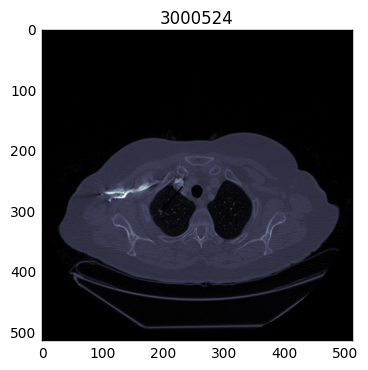

present = 3000519, next = 3000519
same number! 3000519
Lidc-Idri- 26
Slice no. 167
x = 96, y = 306


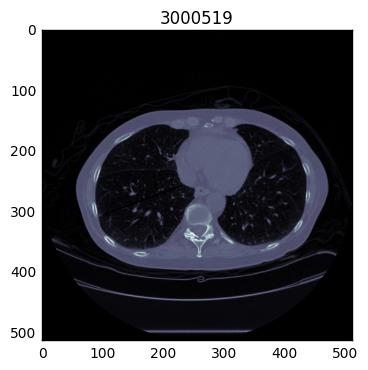

present = 3000519, next = 3000614
different number! 3000519
Lidc-Idri- 26
Slice no. 95
x = 385, y = 195


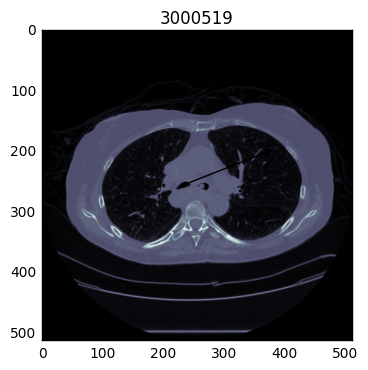

present = 3000614, next = 3000614
same number! 3000614
Lidc-Idri- 27
Slice no. 49
x = 112, y = 204


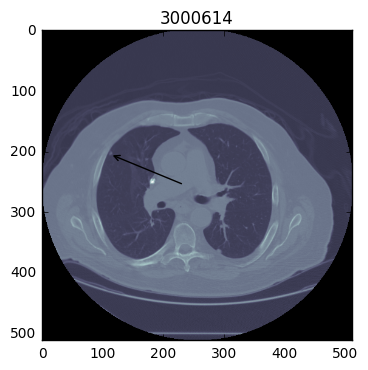

present = 3000614, next = 3000614
same number! 3000614
Lidc-Idri- 27
Slice no. 41
x = 329, y = 263


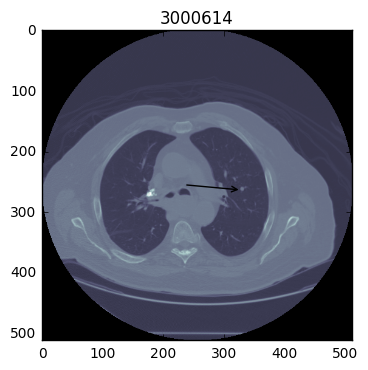

present = 3000614, next = 3000614
same number! 3000614
Lidc-Idri- 27
Slice no. 14
x = 158, y = 293


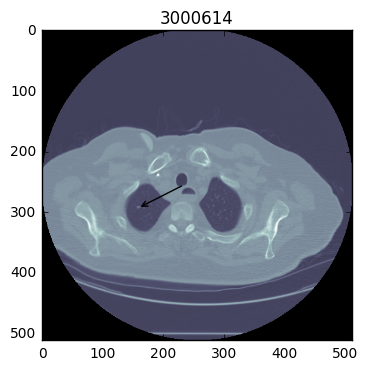

present = 3000614, next = 3000614
same number! 3000614
Lidc-Idri- 27
Slice no. 49
x = 291, y = 365


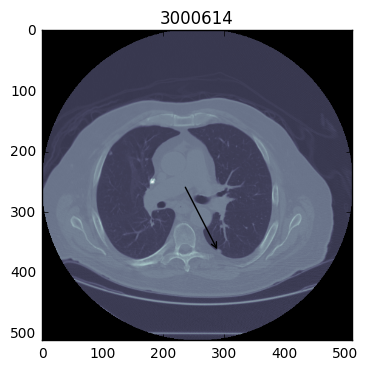

present = 3000614, next = 3000614
same number! 3000614
Lidc-Idri- 27
Slice no. 24
x = 297, y = 237


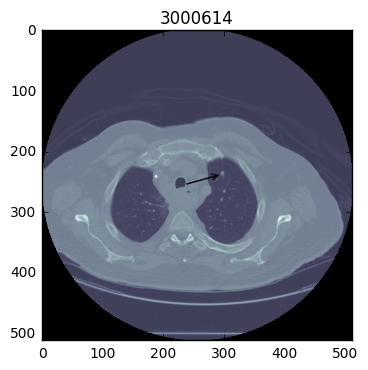

present = 3000614, next = 3000614
same number! 3000614
Lidc-Idri- 27
Slice no. 55
x = 358, y = 282


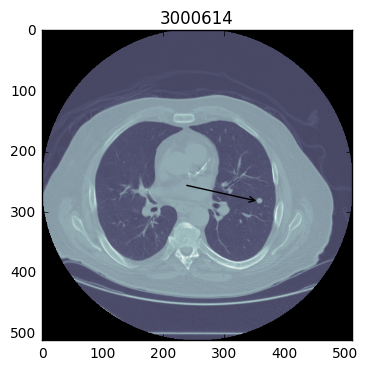

present = 3000614, next = 3000563
different number! 3000614
Lidc-Idri- 27
Slice no. 20
x = 322, y = 335


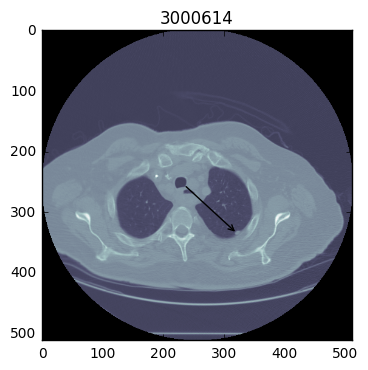

present = 3000563, next = 3000545
different number! 3000563
Lidc-Idri- 28
Slice no. -1
x = 0, y = 0


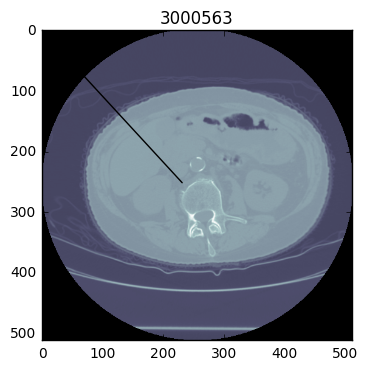

present = 3000545, next = 3000576
different number! 3000545
Lidc-Idri- 29
Slice no. 93
x = 317, y = 283


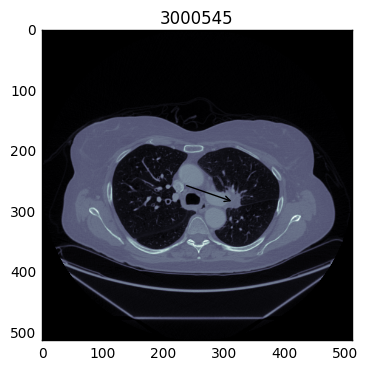

present = 3000576, next = 3000576
same number! 3000576
Lidc-Idri- 30
Slice no. 36
x = 227, y = 365


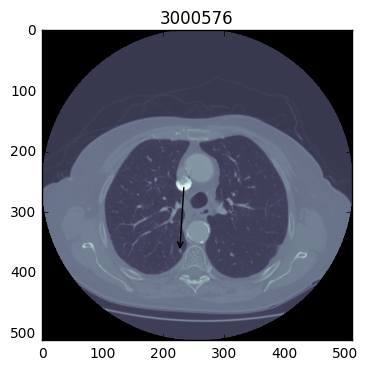

present = 3000576, next = 3000608
different number! 3000576
Lidc-Idri- 30
Slice no. 68
x = 412, y = 306


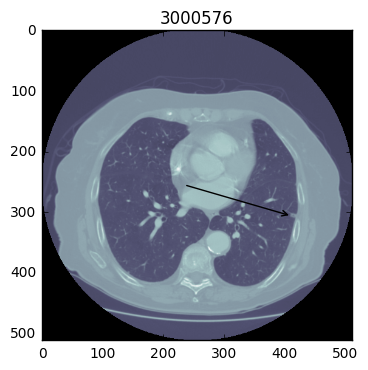

present = 3000608, next = 3000608
same number! 3000608
Lidc-Idri- 31
Slice no. 19
x = 186, y = 356


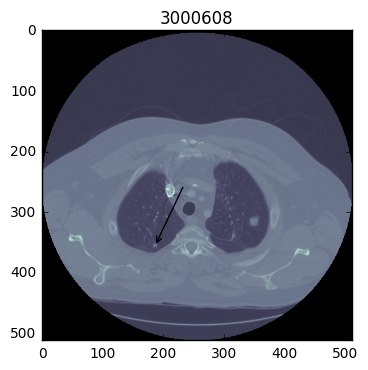

present = 3000608, next = 3000608
same number! 3000608
Lidc-Idri- 31
Slice no. 78
x = 172, y = 392


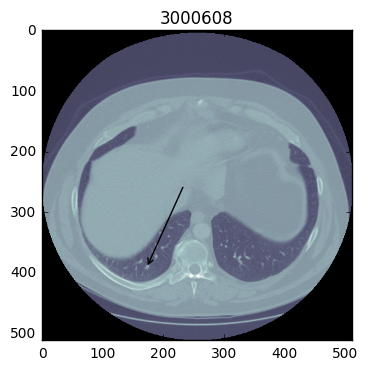

present = 3000608, next = 3000608
same number! 3000608
Lidc-Idri- 31
Slice no. 19
x = 348, y = 316


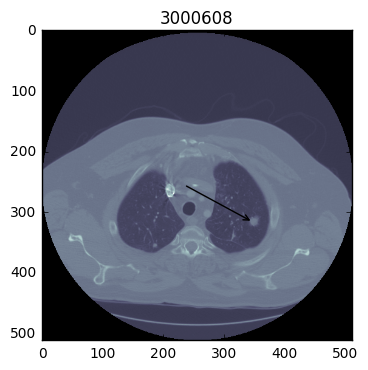

present = 3000608, next = 3000608
same number! 3000608
Lidc-Idri- 31
Slice no. 76
x = 367, y = 334


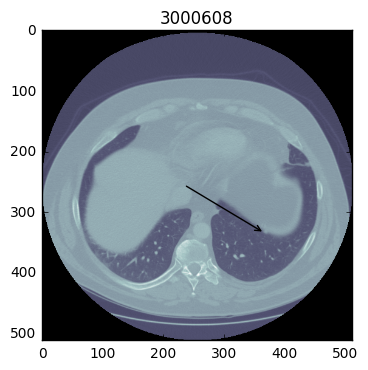

present = 3000608, next = 3000537
different number! 3000608
Lidc-Idri- 31
Slice no. 43
x = 155, y = 356


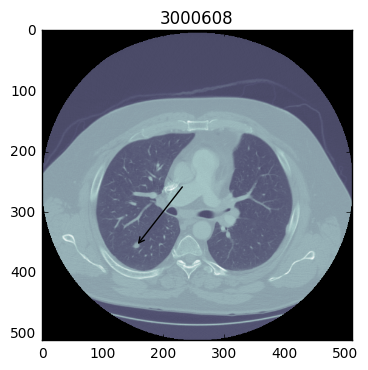

present = 3000537, next = 3000546
different number! 3000537
Lidc-Idri- 32
Slice no. -1
x = 0, y = 0


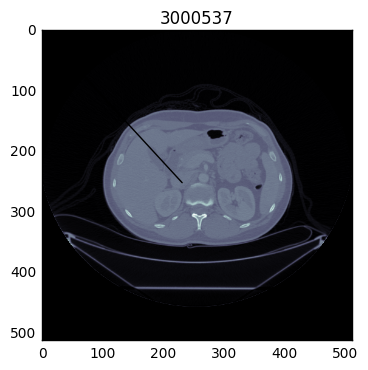

present = 3000546, next = 3000546
same number! 3000546
Lidc-Idri- 33
Slice no. 27
x = 280, y = 334


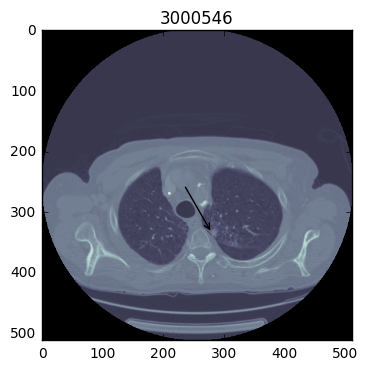

present = 3000546, next = 3000516
different number! 3000546
Lidc-Idri- 33
Slice no. 30
x = 383, y = 322


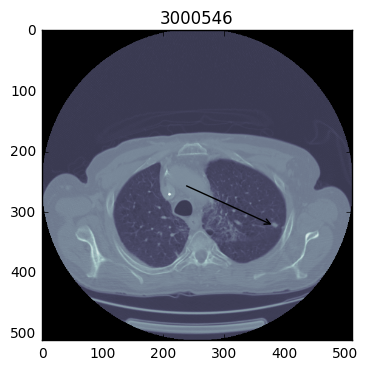

present = 3000516, next = 3000582
different number! 3000516
Lidc-Idri- 34
Slice no. 167
x = 455, y = 266


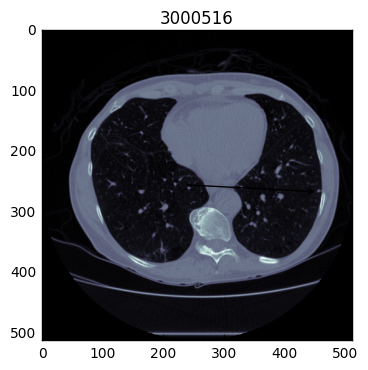

present = 3000582, next = 3000521
different number! 3000582
Lidc-Idri- 35
Slice no. 17
x = 299, y = 340


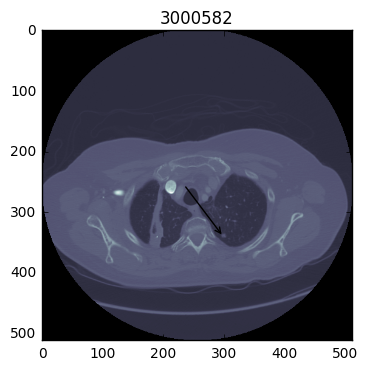

present = 3000521, next = 3000521
same number! 3000521
Lidc-Idri- 36
Slice no. 82
x = 182, y = 348


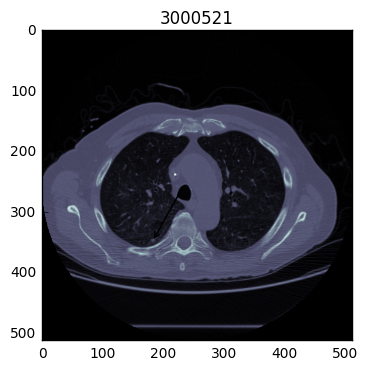

present = 3000521, next = 3000573
different number! 3000521
Lidc-Idri- 36
Slice no. 71
x = 141, y = 312


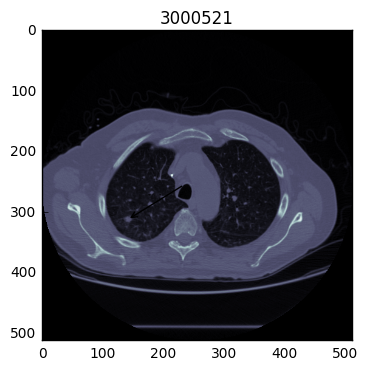

present = 3000573, next = 3000573
same number! 3000573
Lidc-Idri- 37
Slice no. 33
x = 377, y = 363


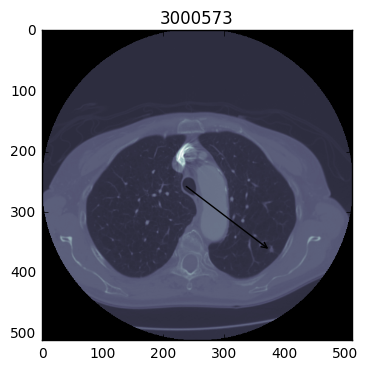

present = 3000573, next = 3000554
different number! 3000573
Lidc-Idri- 37
Slice no. 58
x = 407, y = 288


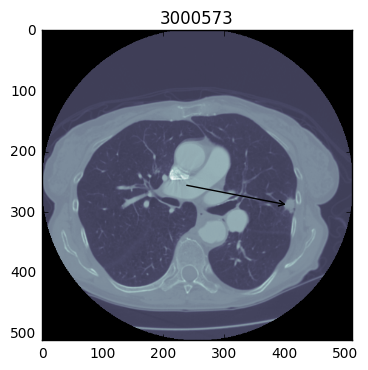

present = 3000554, next = 3000517
different number! 3000554
Lidc-Idri- 38
Slice no. 79
x = 424, y = 261


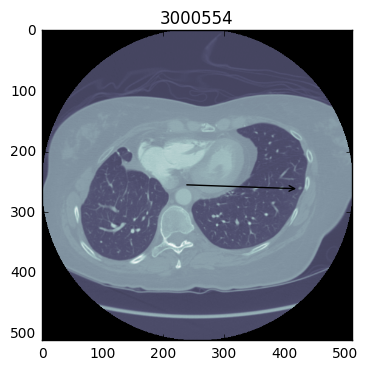

present = 3000517, next = 3000517
same number! 3000517
Lidc-Idri- 39
Slice no. 157
x = 145, y = 267


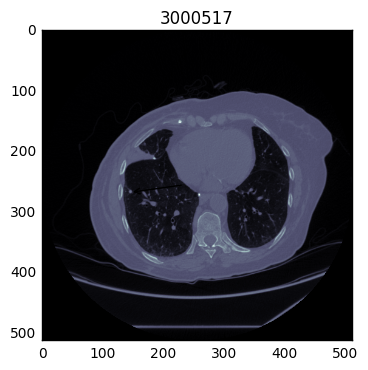

present = 3000517, next = 3000517
same number! 3000517
Lidc-Idri- 39
Slice no. 147
x = 252, y = 299


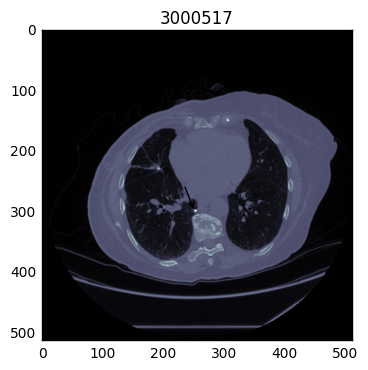

present = 3000517, next = 3000517
same number! 3000517
Lidc-Idri- 39
Slice no. 116
x = 238, y = 367


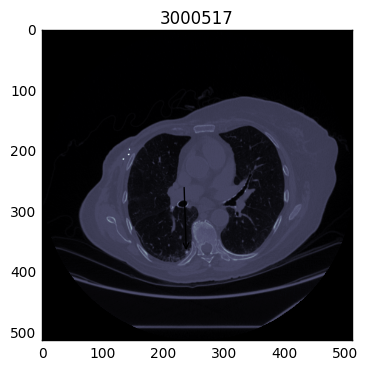

present = 3000517, next = 3000517
same number! 3000517
Lidc-Idri- 39
Slice no. 161
x = 151, y = 301


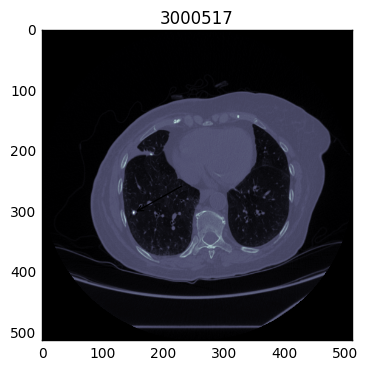

present = 3000517, next = 3000578
different number! 3000517
Lidc-Idri- 39
Slice no. 105
x = 207, y = 207


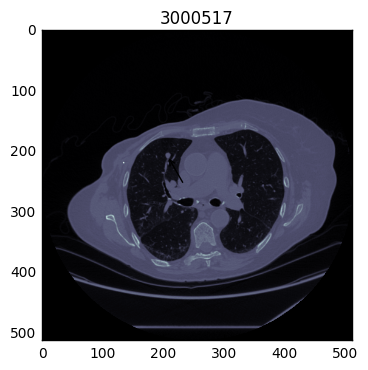

present = 3000578, next = 3000578
same number! 3000578
Lidc-Idri- 40
Slice no. 53
x = 120, y = 231


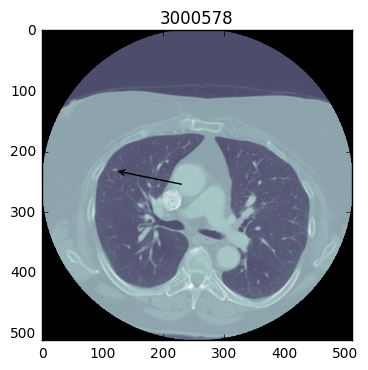

present = 3000578, next = 3000578
same number! 3000578
Lidc-Idri- 40
Slice no. 86
x = 170, y = 432


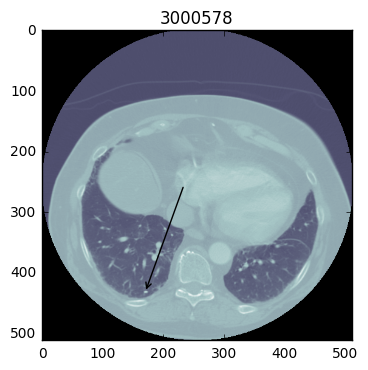

present = 3000578, next = 3000578
same number! 3000578
Lidc-Idri- 40
Slice no. 77
x = 100, y = 388


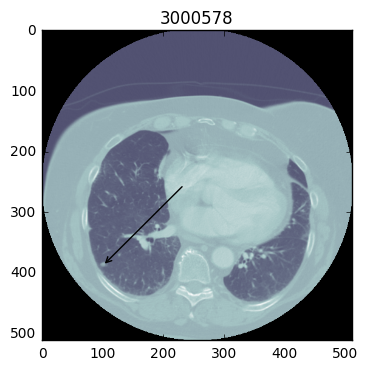

present = 3000578, next = 3000568
different number! 3000578
Lidc-Idri- 40
Slice no. 76
x = 127, y = 371


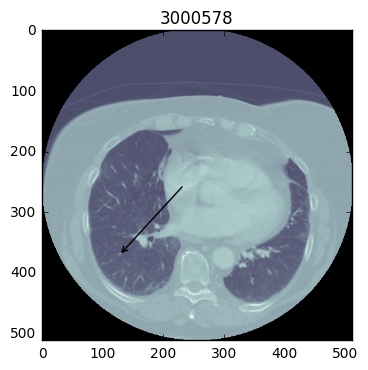

present = 3000568, next = 3000568
same number! 3000568
Lidc-Idri- 41
Slice no. 92
x = 320, y = 379


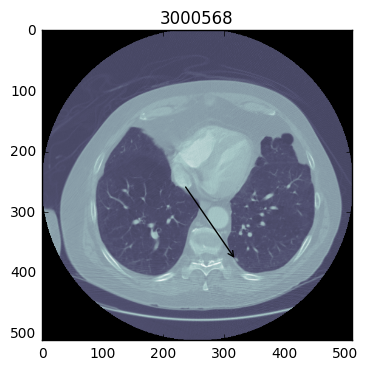

present = 3000568, next = 3000568
same number! 3000568
Lidc-Idri- 41
Slice no. 100
x = 321, y = 337


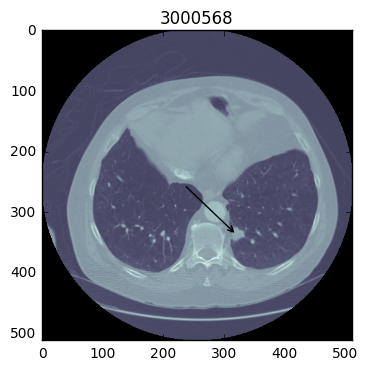

present = 3000568, next = 3000579
different number! 3000568
Lidc-Idri- 41
Slice no. 24
x = 313, y = 382


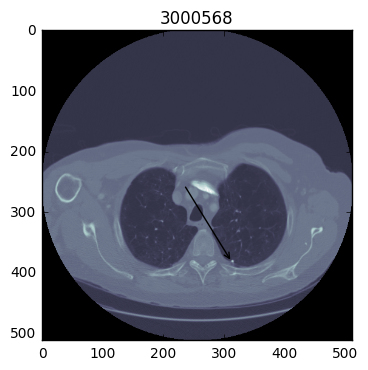

present = 3000579, next = 3000579
same number! 3000579
Lidc-Idri- 42
Slice no. 74
x = 358, y = 377


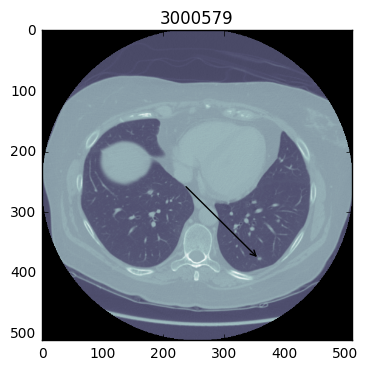

present = 3000579, next = 3000579
same number! 3000579
Lidc-Idri- 42
Slice no. 83
x = 161, y = 359


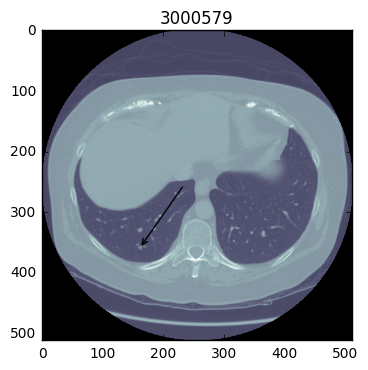

present = 3000579, next = 3000579
same number! 3000579
Lidc-Idri- 42
Slice no. 80
x = 301, y = 348


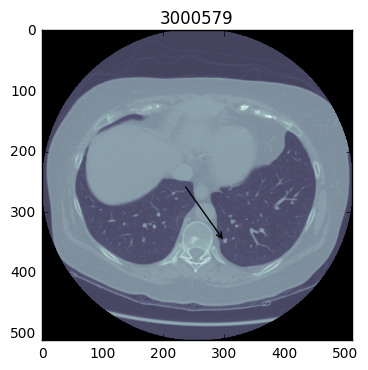

present = 3000579, next = 3000579
same number! 3000579
Lidc-Idri- 42
Slice no. 74
x = 178, y = 267


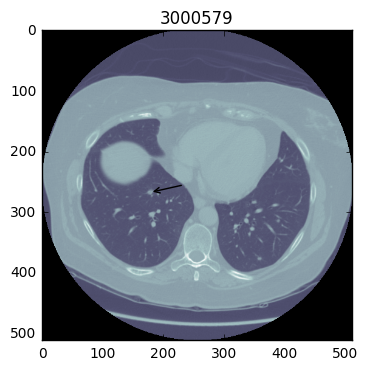

present = 3000579, next = 3000579
same number! 3000579
Lidc-Idri- 42
Slice no. 62
x = 158, y = 184


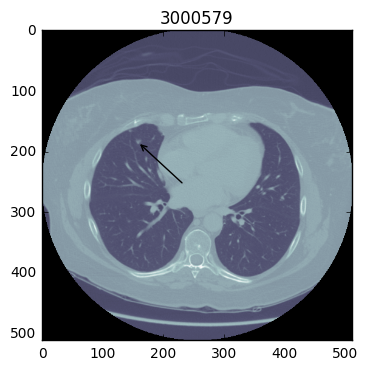

present = 3000579, next = 3000579
same number! 3000579
Lidc-Idri- 42
Slice no. 44
x = 288, y = 366


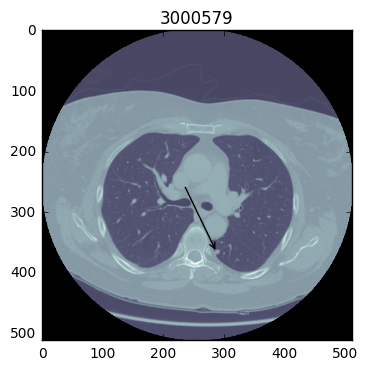

present = 3000579, next = 3000579
same number! 3000579
Lidc-Idri- 42
Slice no. 45
x = 158, y = 376


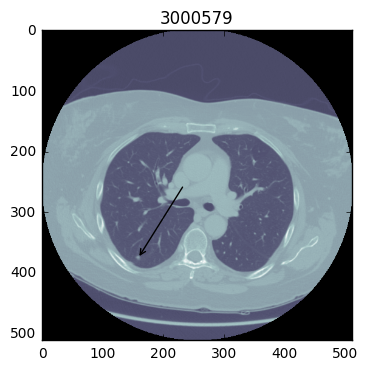

present = 3000579, next = 3000579
same number! 3000579
Lidc-Idri- 42
Slice no. 81
x = 413, y = 335


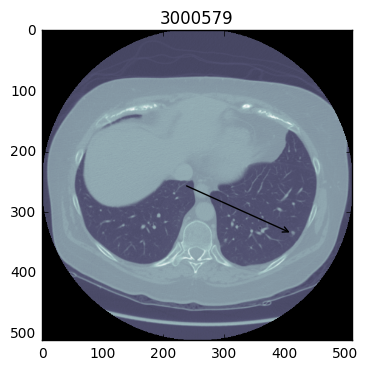

present = 3000579, next = 3000579
same number! 3000579
Lidc-Idri- 42
Slice no. 37
x = 399, y = 278


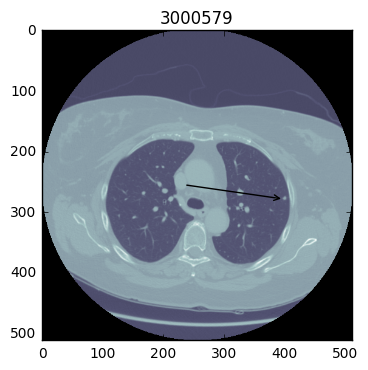

present = 3000579, next = 3000629
different number! 3000579
Lidc-Idri- 42
Slice no. 56
x = 318, y = 375


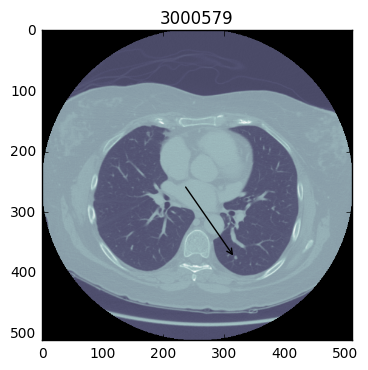

present = 3000629, next = 3000629
same number! 3000629
Lidc-Idri- 43
Slice no. 27
x = 136, y = 219


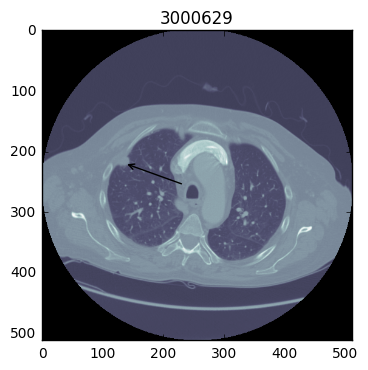

present = 3000629, next = 3000629
same number! 3000629
Lidc-Idri- 43
Slice no. 56
x = 401, y = 324


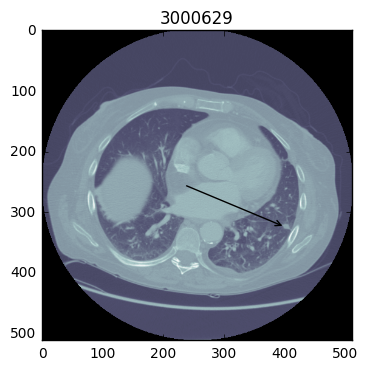

present = 3000629, next = 3000571
different number! 3000629
Lidc-Idri- 43
Slice no. 21
x = 139, y = 307


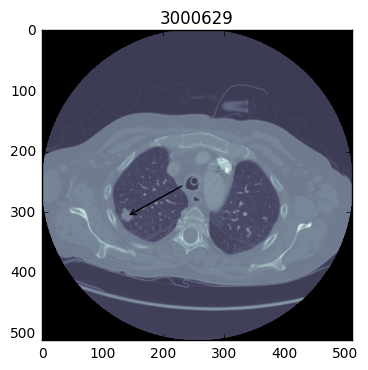

present = 3000571, next = 3000571
same number! 3000571
Lidc-Idri- 44
Slice no. 95
x = 146, y = 380


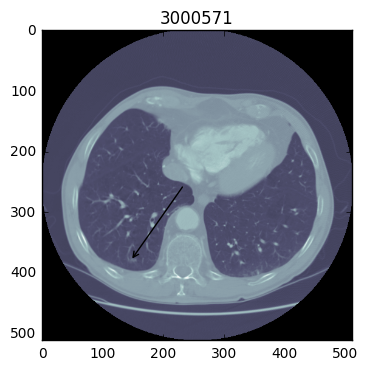

present = 3000571, next = 3000571
same number! 3000571
Lidc-Idri- 44
Slice no. 81
x = 138, y = 314


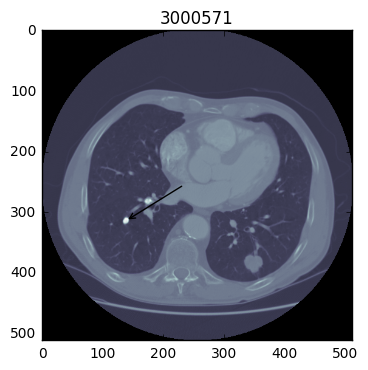

present = 3000571, next = 3000571
same number! 3000571
Lidc-Idri- 44
Slice no. 73
x = 105, y = 223


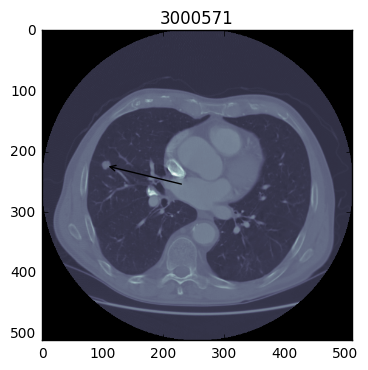

present = 3000571, next = 3000547
different number! 3000571
Lidc-Idri- 44
Slice no. 79
x = 346, y = 384


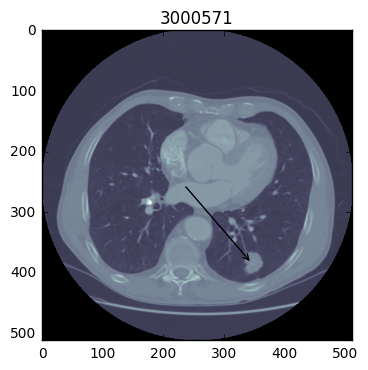

present = 3000547, next = 3000547
same number! 3000547
Lidc-Idri- 45
Slice no. 107
x = 359, y = 362


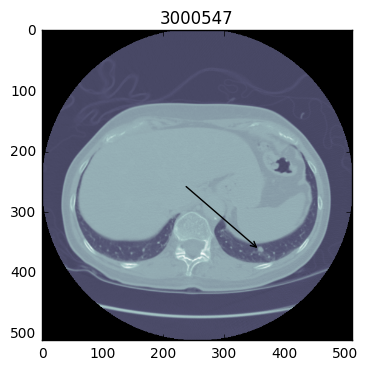

present = 3000547, next = 3000547
same number! 3000547
Lidc-Idri- 45
Slice no. 45
x = 280, y = 192


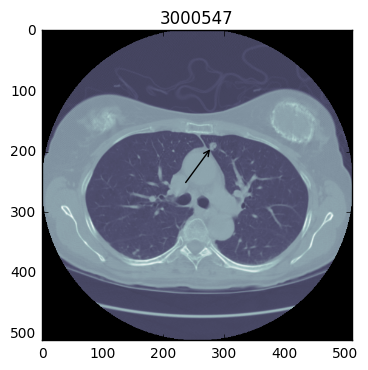

present = 3000547, next = 3000547
same number! 3000547
Lidc-Idri- 45
Slice no. 91
x = 172, y = 270


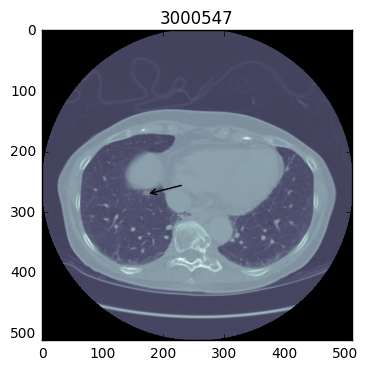

present = 3000547, next = 3000547
same number! 3000547
Lidc-Idri- 45
Slice no. 76
x = 119, y = 226


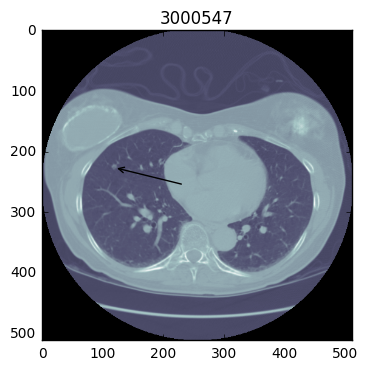

present = 3000547, next = 3000547
same number! 3000547
Lidc-Idri- 45
Slice no. 63
x = 111, y = 365


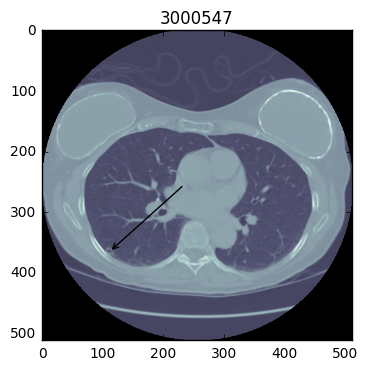

present = 3000547, next = 3000547
same number! 3000547
Lidc-Idri- 45
Slice no. 70
x = 85, y = 328


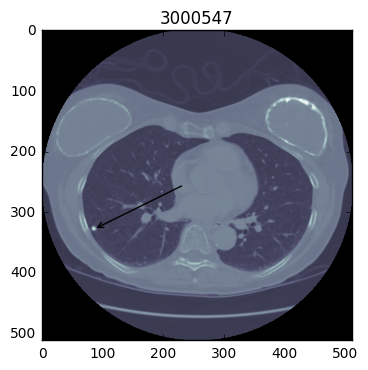

present = 3000547, next = 3000547
same number! 3000547
Lidc-Idri- 45
Slice no. 61
x = 209, y = 231


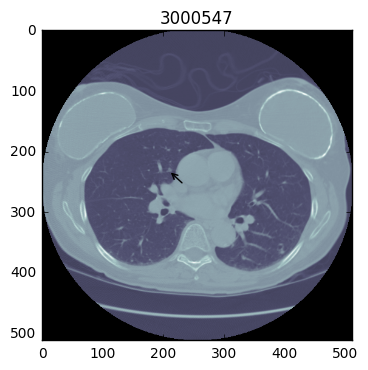

present = 3000547, next = 3000547
same number! 3000547
Lidc-Idri- 45
Slice no. 49
x = 302, y = 202


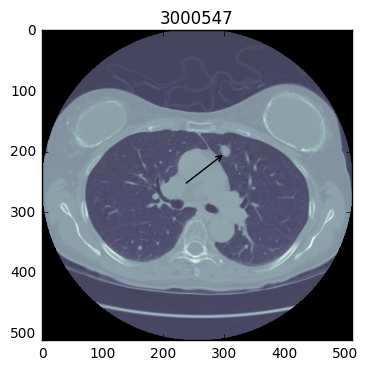

present = 3000547, next = 3000547
same number! 3000547
Lidc-Idri- 45
Slice no. 82
x = 333, y = 326


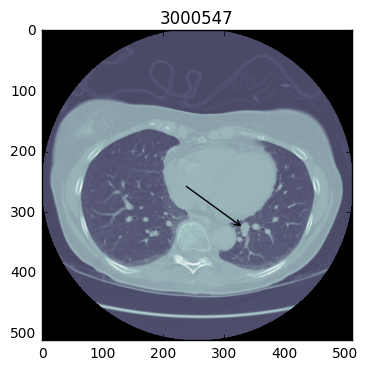

present = 3000547, next = 3000547
same number! 3000547
Lidc-Idri- 45
Slice no. 47
x = 160, y = 361


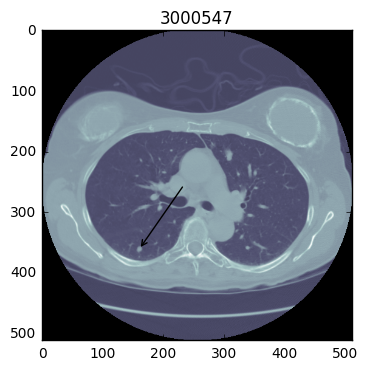

present = 3000547, next = 3000547
same number! 3000547
Lidc-Idri- 45
Slice no. 86
x = 337, y = 367


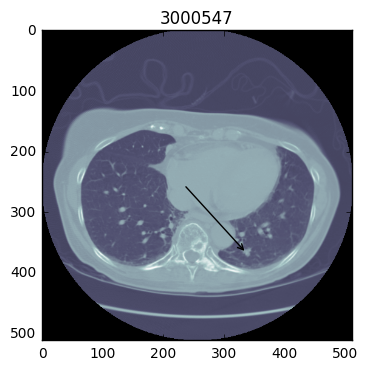

present = 3000547, next = 3000577
different number! 3000547
Lidc-Idri- 45
Slice no. 61
x = 392, y = 360


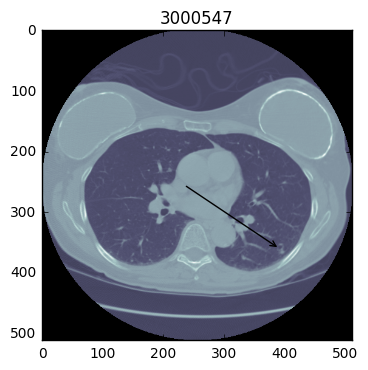

present = 3000577, next = 3000577
same number! 3000577
Lidc-Idri- 46
Slice no. 85
x = 79, y = 220


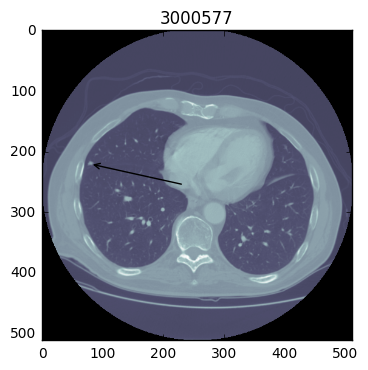

present = 3000577, next = 3000577
same number! 3000577
Lidc-Idri- 46
Slice no. 107
x = 61, y = 275


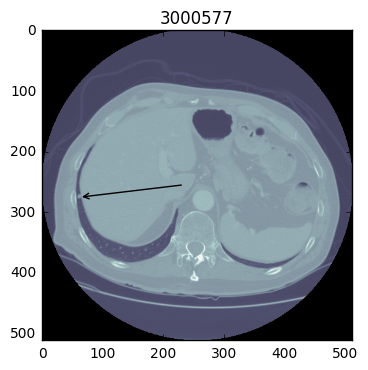

present = 3000577, next = 3000577
same number! 3000577
Lidc-Idri- 46
Slice no. 90
x = 147, y = 235


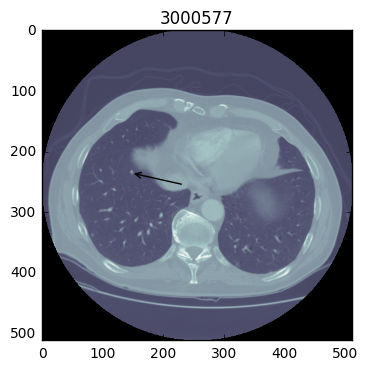

present = 3000577, next = 3000577
same number! 3000577
Lidc-Idri- 46
Slice no. 79
x = 376, y = 366


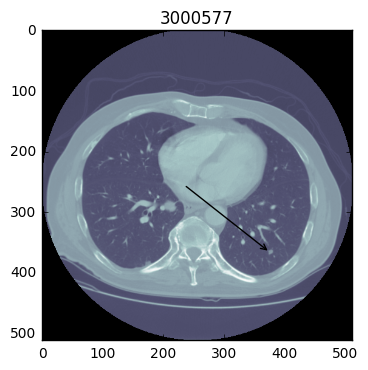

present = 3000577, next = 3000577
same number! 3000577
Lidc-Idri- 46
Slice no. 87
x = 430, y = 330


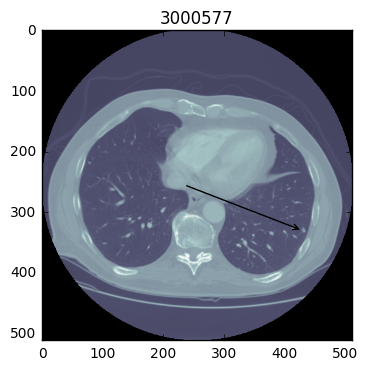

present = 3000577, next = 3000577
same number! 3000577
Lidc-Idri- 46
Slice no. 89
x = 82, y = 338


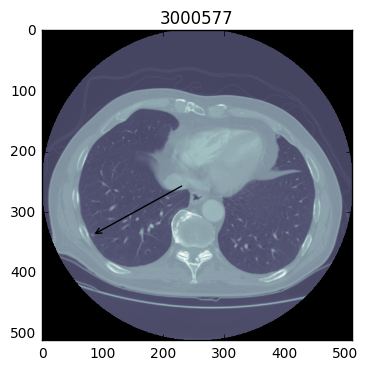

present = 3000577, next = 3000552
different number! 3000577
Lidc-Idri- 46
Slice no. 93
x = 83, y = 346


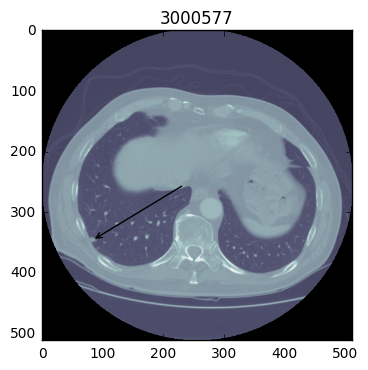

present = 3000552, next = 3000624
different number! 3000552
Lidc-Idri- 47
Slice no. 55
x = 142, y = 284


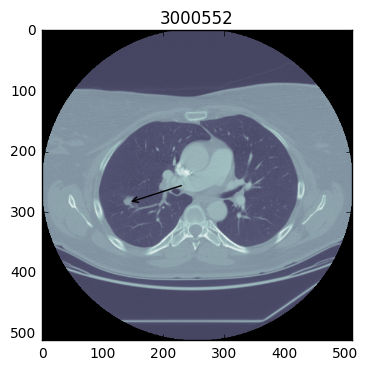

present = 3000624, next = 3000624
same number! 3000624
Lidc-Idri- 48
Slice no. 131
x = 175, y = 174


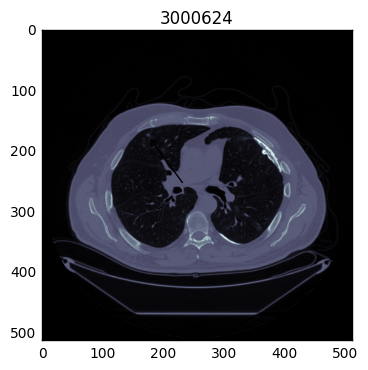

present = 3000624, next = 3000624
same number! 3000624
Lidc-Idri- 48
Slice no. 133
x = 354, y = 325


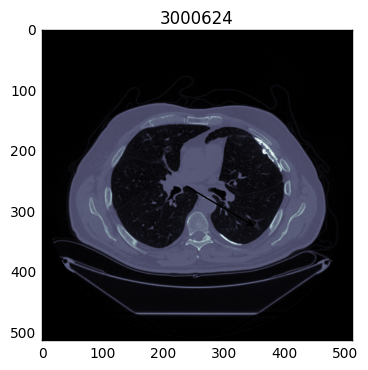

present = 3000624, next = 3000627
different number! 3000624
Lidc-Idri- 48
Slice no. 107
x = 169, y = 216


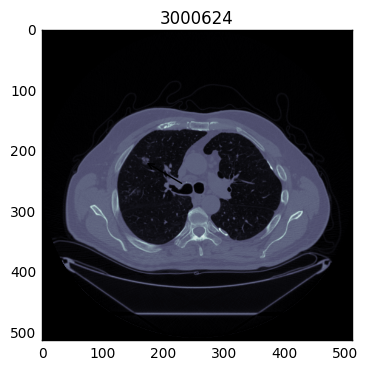

present = 3000627, next = 3000627
same number! 3000627
Lidc-Idri- 49
Slice no. 65
x = 118, y = 227


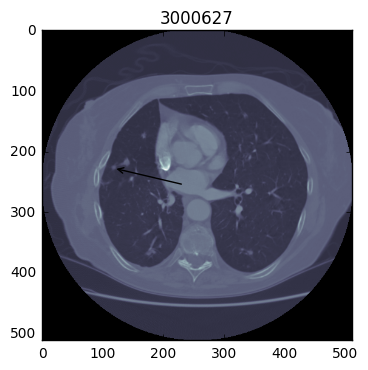

present = 3000627, next = 3000627
same number! 3000627
Lidc-Idri- 49
Slice no. 71
x = 320, y = 127


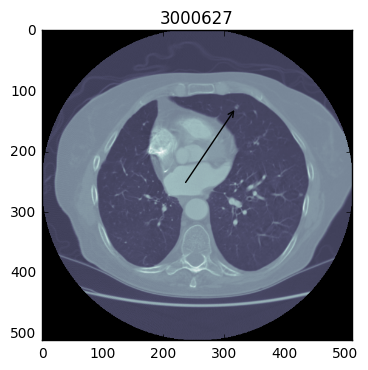

present = 3000627, next = 3000627
same number! 3000627
Lidc-Idri- 49
Slice no. 64
x = 178, y = 365


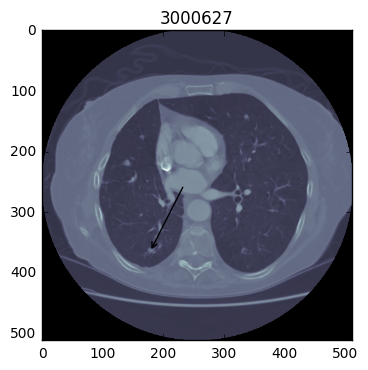

present = 3000627, next = 3000627
same number! 3000627
Lidc-Idri- 49
Slice no. 62
x = 345, y = 175


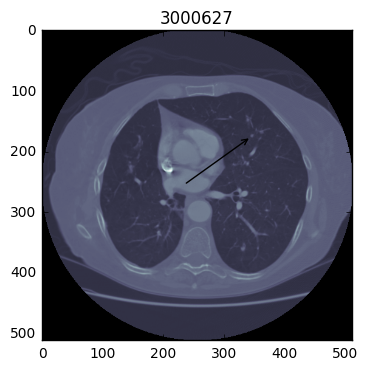

present = 3000627, next = 3000627
same number! 3000627
Lidc-Idri- 49
Slice no. 67
x = 326, y = 362


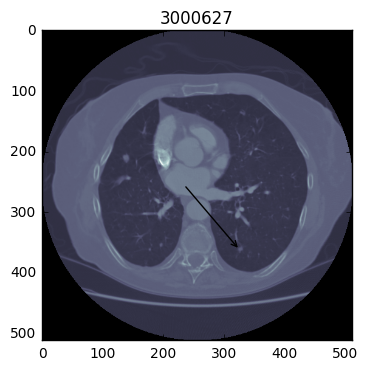

present = 3000627, next = 3000627
same number! 3000627
Lidc-Idri- 49
Slice no. 66
x = 138, y = 216


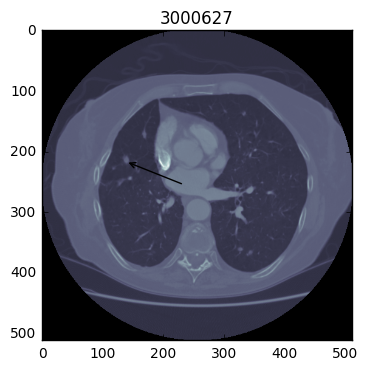

present = 3000627, next = 3000627
same number! 3000627
Lidc-Idri- 49
Slice no. 71
x = 426, y = 272


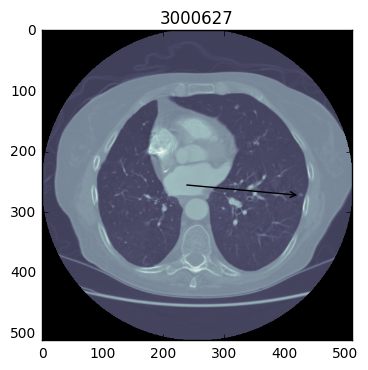

present = 3000627, next = 3000627
same number! 3000627
Lidc-Idri- 49
Slice no. 95
x = 123, y = 345


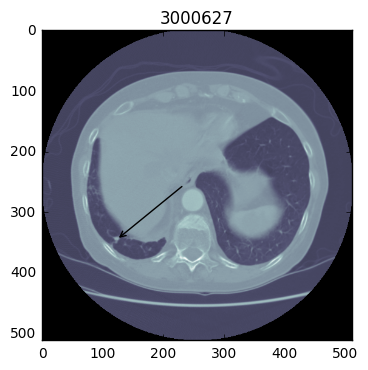

present = 3000627, next = 3000627
same number! 3000627
Lidc-Idri- 49
Slice no. 63
x = 361, y = 169


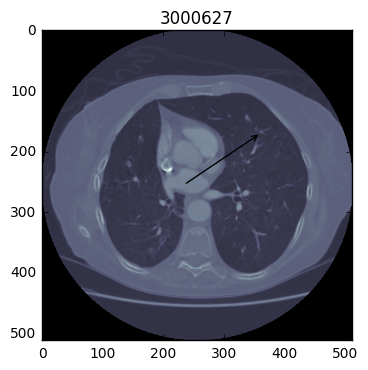

present = 3000627, next = 3000627
same number! 3000627
Lidc-Idri- 49
Slice no. 61
x = 331, y = 358


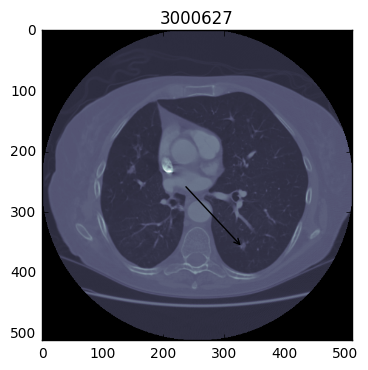

present = 3000627, next = 3000627
same number! 3000627
Lidc-Idri- 49
Slice no. 80
x = 355, y = 144


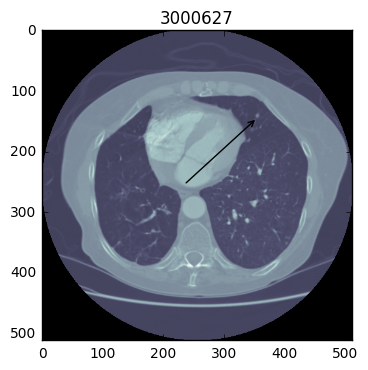

present = 3000627, next = 3000627
same number! 3000627
Lidc-Idri- 49
Slice no. 65
x = 343, y = 367


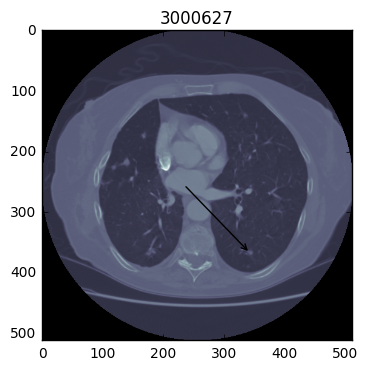

present = 3000627, next = 3000627
same number! 3000627
Lidc-Idri- 49
Slice no. 60
x = 170, y = 201


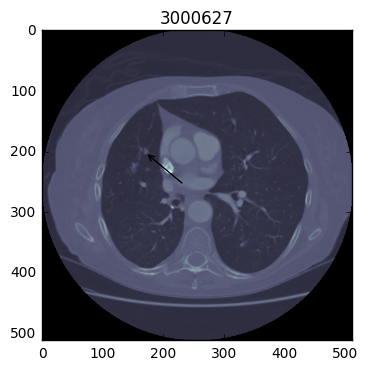

present = 3000627, next = 3000627
same number! 3000627
Lidc-Idri- 49
Slice no. 63
x = 337, y = 146


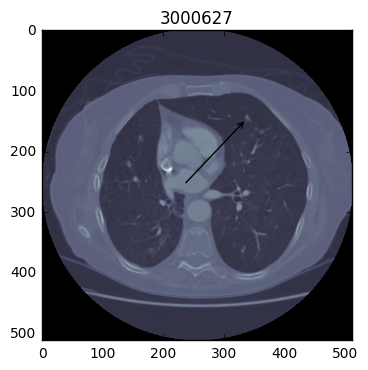

present = 3000627, next = 3000572
different number! 3000627
Lidc-Idri- 49
Slice no. 68
x = 361, y = 146


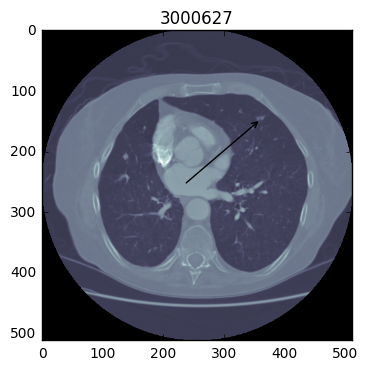

present = 3000572, next = 3000609
different number! 3000572
Lidc-Idri- 50
Slice no. 44
x = 173, y = 326


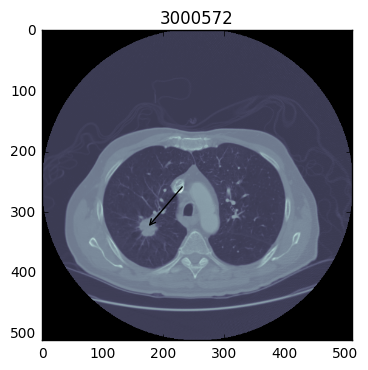

present = 3000609, next = 3000609
same number! 3000609
Lidc-Idri- 51
Slice no. 37
x = 338, y = 243


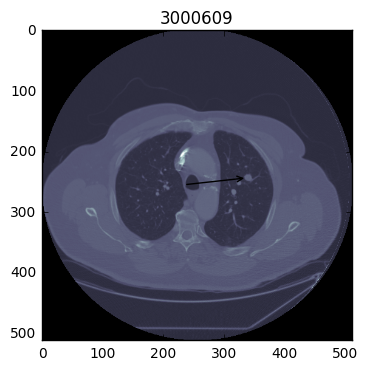

present = 3000609, next = 3000609
same number! 3000609
Lidc-Idri- 51
Slice no. 53
x = 164, y = 192


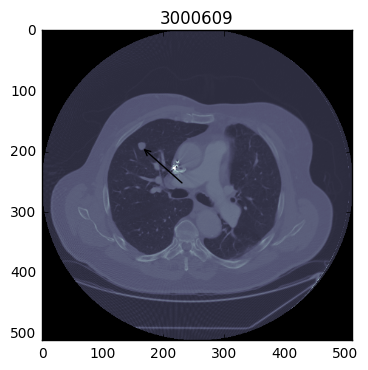

present = 3000609, next = 3000625
different number! 3000609
Lidc-Idri- 51
Slice no. 91
x = 101, y = 291


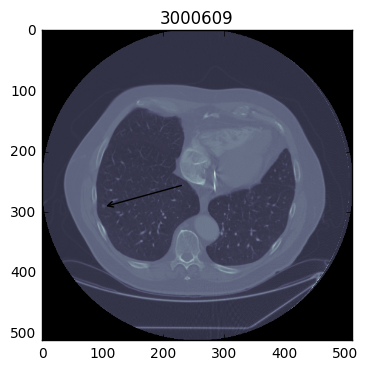

present = 3000625, next = 3000625
same number! 3000625
Lidc-Idri- 52
Slice no. 187
x = 348, y = 232


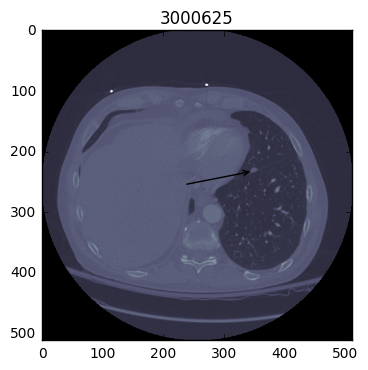

present = 3000625, next = 3000615
different number! 3000625
Lidc-Idri- 52
Slice no. 45
x = 154, y = 309


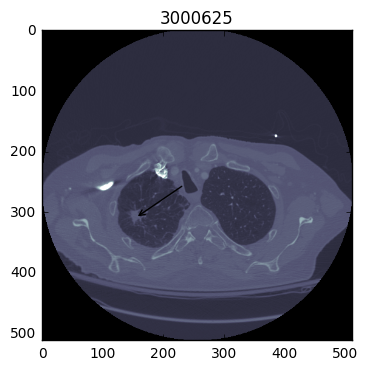

present = 3000615, next = 3000615
same number! 3000615
Lidc-Idri- 53
Slice no. 74
x = 412, y = 241


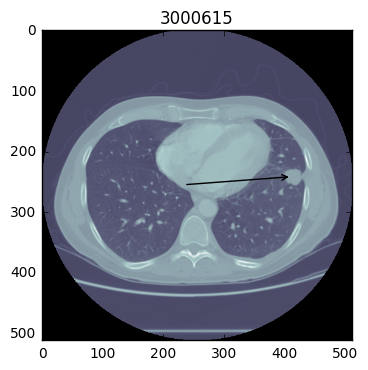

present = 3000615, next = 3000565
different number! 3000615
Lidc-Idri- 53
Slice no. 63
x = 197, y = 173


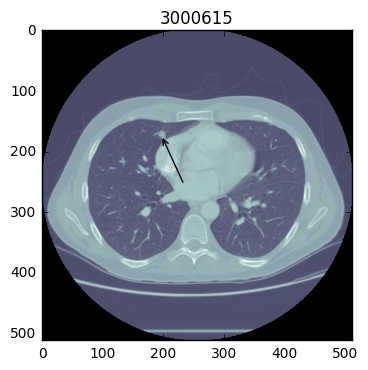

present = 3000565, next = 3000581
different number! 3000565
Lidc-Idri- 54
Slice no. 47
x = 402, y = 289


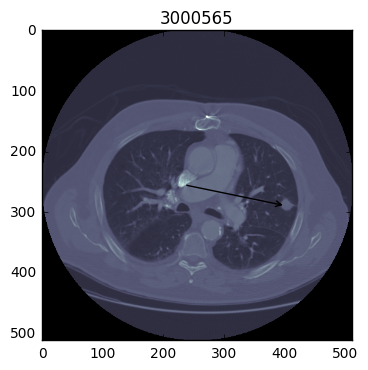

present = 3000581, next = 3000581
same number! 3000581
Lidc-Idri- 55
Slice no. 38
x = 231, y = 336


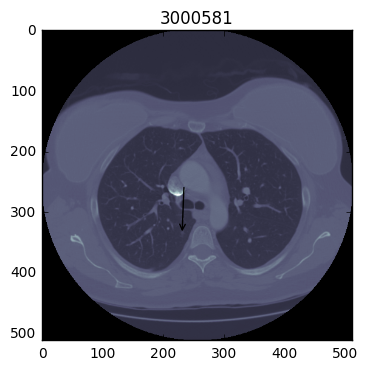

present = 3000581, next = 3000581
same number! 3000581
Lidc-Idri- 55
Slice no. 16
x = 313, y = 283


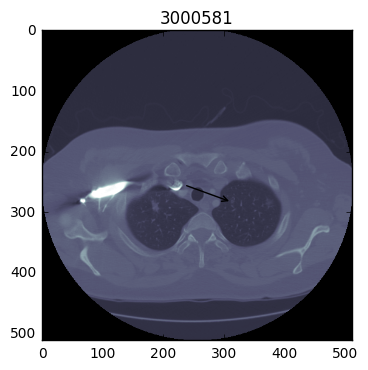

present = 3000581, next = 3000581
same number! 3000581
Lidc-Idri- 55
Slice no. 48
x = 345, y = 208


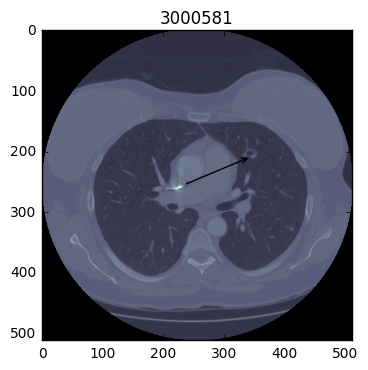

present = 3000581, next = 3000581
same number! 3000581
Lidc-Idri- 55
Slice no. 17
x = 186, y = 290


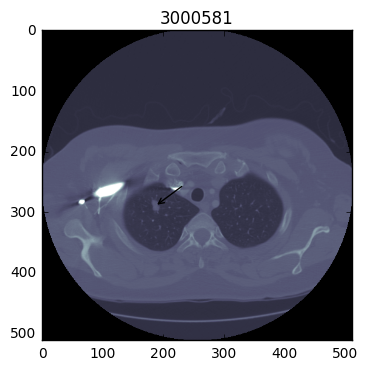

present = 3000581, next = 3000581
same number! 3000581
Lidc-Idri- 55
Slice no. 47
x = 410, y = 329


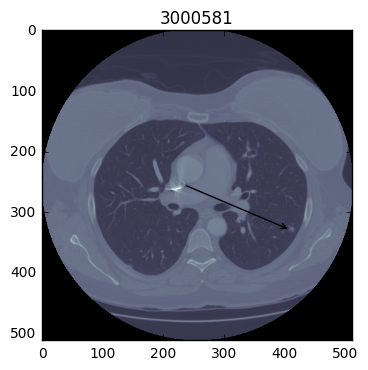

present = 3000581, next = 3000581
same number! 3000581
Lidc-Idri- 55
Slice no. 15
x = 375, y = 286


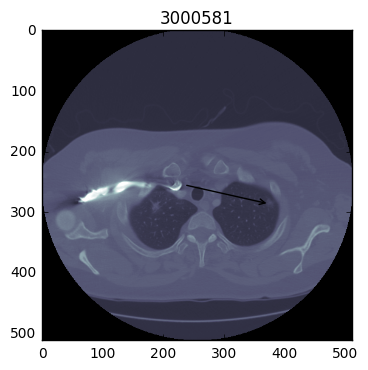

present = 3000581, next = 3000535
different number! 3000581
Lidc-Idri- 55
Slice no. 45
x = 382, y = 252


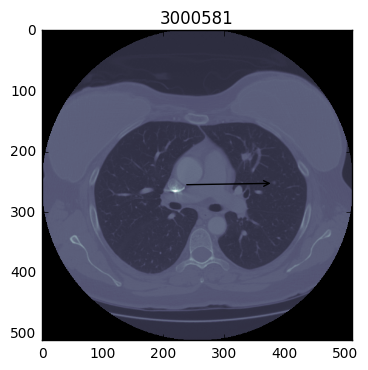

present = 3000535, next = 3000535
same number! 3000535
Lidc-Idri- 56
Slice no. 164
x = 305, y = 304


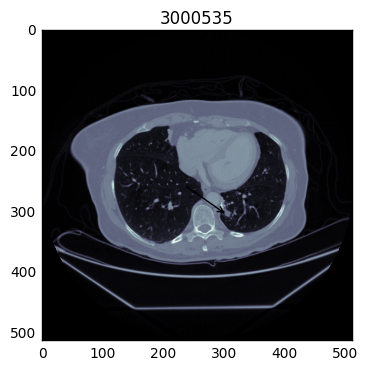

present = 3000535, next = 3000535
same number! 3000535
Lidc-Idri- 56
Slice no. 126
x = 149, y = 296


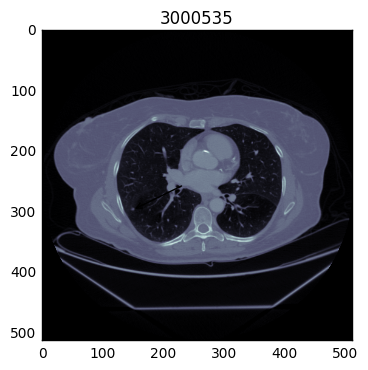

present = 3000535, next = 3000514
different number! 3000535
Lidc-Idri- 56
Slice no. 71
x = 363, y = 277


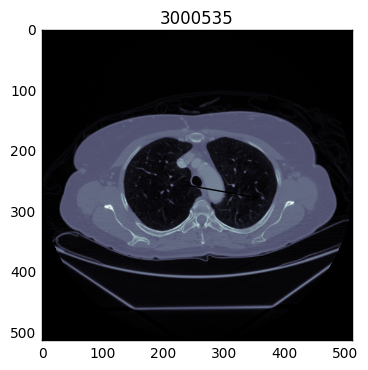

present = 3000514, next = 3000626
different number! 3000514
Lidc-Idri- 57
Slice no. 82
x = 344, y = 348


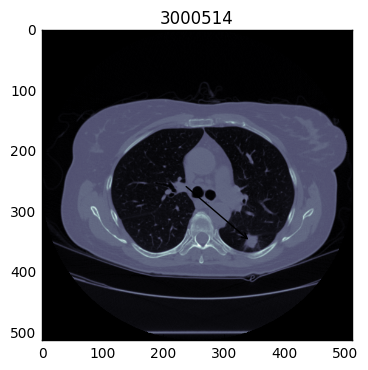

present = 3000626, next = 3000626
same number! 3000626
Lidc-Idri- 58
Slice no. 26
x = 370, y = 329


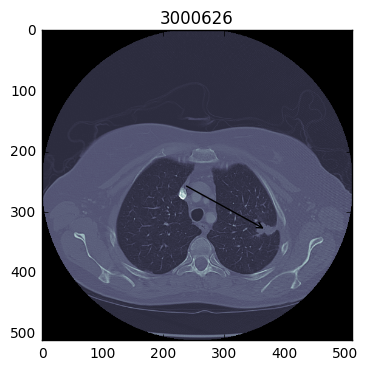

present = 3000626, next = 3000626
same number! 3000626
Lidc-Idri- 58
Slice no. 45
x = 164, y = 199


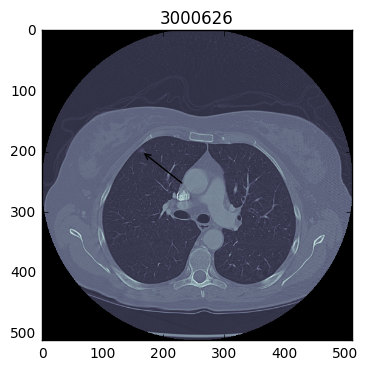

present = 3000626, next = 3000564
different number! 3000626
Lidc-Idri- 58
Slice no. 63
x = 366, y = 265


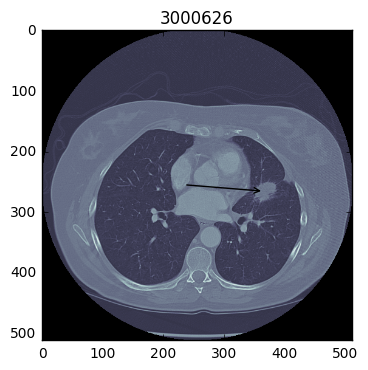

present = 3000564, next = 3000575
different number! 3000564
Lidc-Idri- 59
Slice no. 31
x = 324, y = 382


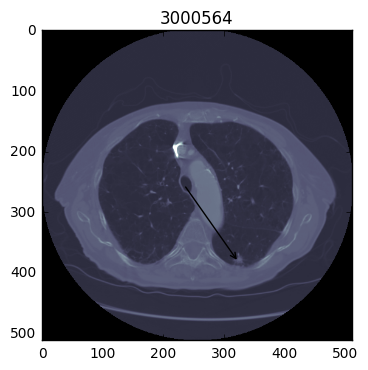

present = 3000575, next = 3000575
same number! 3000575
Lidc-Idri- 60
Slice no. 36
x = 388, y = 250


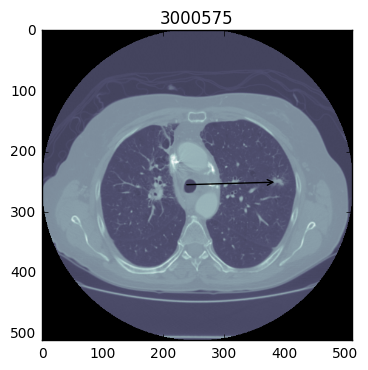

present = 3000575, next = 3000575
same number! 3000575
Lidc-Idri- 60
Slice no. 51
x = 398, y = 234


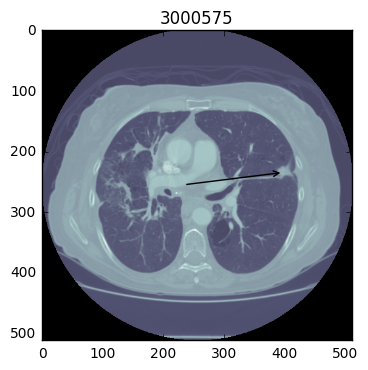

present = 3000575, next = 3000575
same number! 3000575
Lidc-Idri- 60
Slice no. 19
x = 172, y = 246


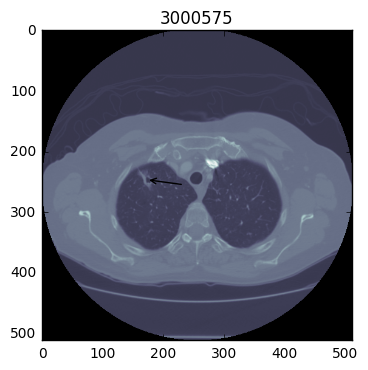

present = 3000575, next = 3000575
same number! 3000575
Lidc-Idri- 60
Slice no. 28
x = 344, y = 224


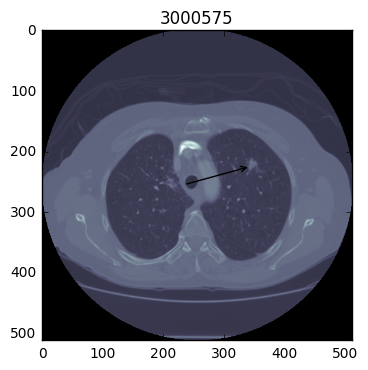

present = 3000575, next = 3000575
same number! 3000575
Lidc-Idri- 60
Slice no. 22
x = 185, y = 334


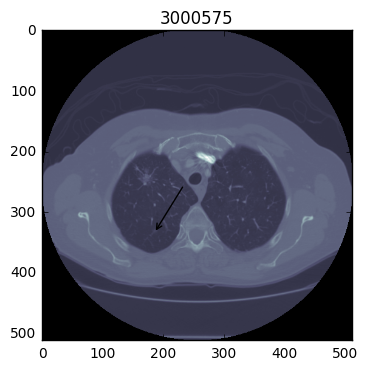

present = 3000575, next = 3000560
different number! 3000575
Lidc-Idri- 60
Slice no. 74
x = 384, y = 303


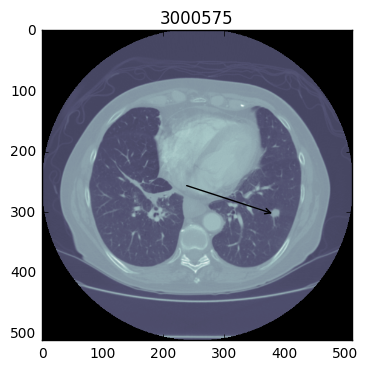

present = 3000560, next = 3000560
same number! 3000560
Lidc-Idri- 61
Slice no. 32
x = 332, y = 201


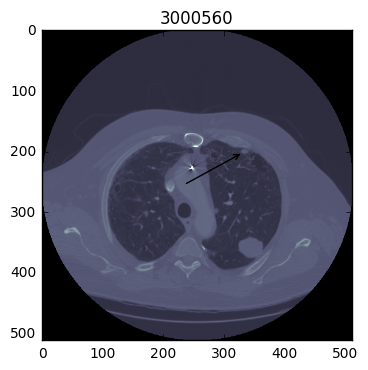

present = 3000560, next = 3000560
same number! 3000560
Lidc-Idri- 61
Slice no. 31
x = 341, y = 360


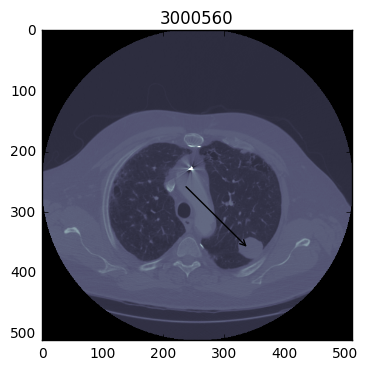

present = 3000560, next = 3000560
same number! 3000560
Lidc-Idri- 61
Slice no. 65
x = 242, y = 311


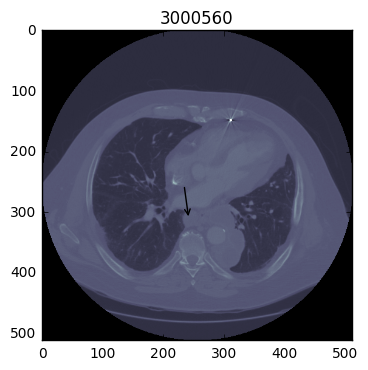

present = 3000560, next = 3000560
same number! 3000560
Lidc-Idri- 61
Slice no. 53
x = 397, y = 242


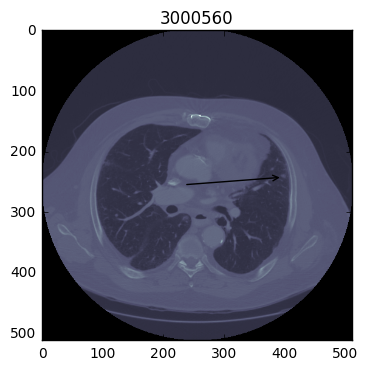

present = 3000560, next = 3000560
same number! 3000560
Lidc-Idri- 61
Slice no. 34
x = 286, y = 298


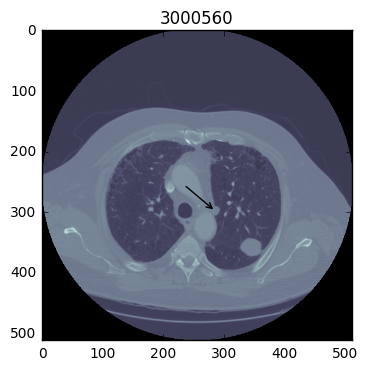

present = 3000560, next = 3000558
different number! 3000560
Lidc-Idri- 61
Slice no. 83
x = 383, y = 336


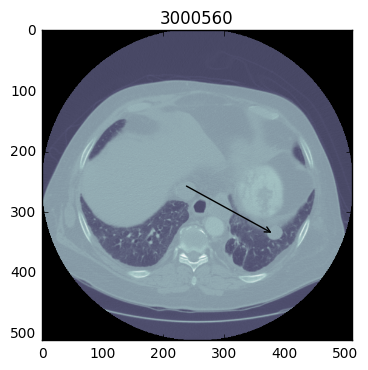

present = 3000558, next = 3000555
different number! 3000558
Lidc-Idri- 62
Slice no. -1
x = 0, y = 0


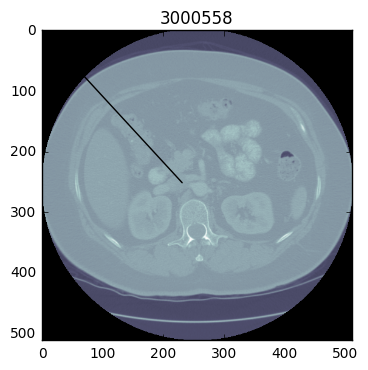

present = 3000555, next = 3000555
same number! 3000555
Lidc-Idri- 63
Slice no. 72
x = 122, y = 307


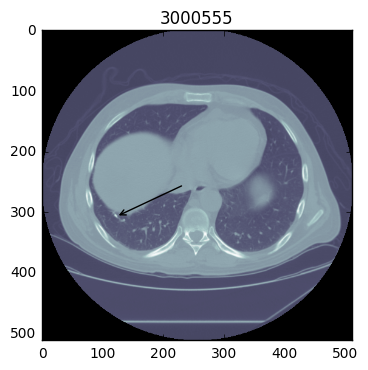

present = 3000555, next = 3000555
same number! 3000555
Lidc-Idri- 63
Slice no. 65
x = 187, y = 333


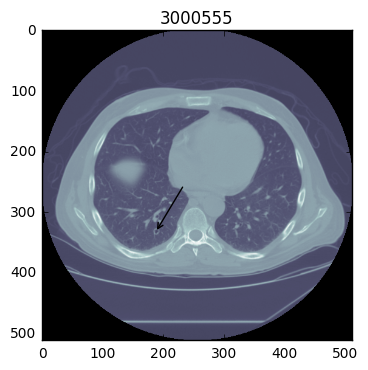

present = 3000555, next = 3000555
same number! 3000555
Lidc-Idri- 63
Slice no. 42
x = 219, y = 300


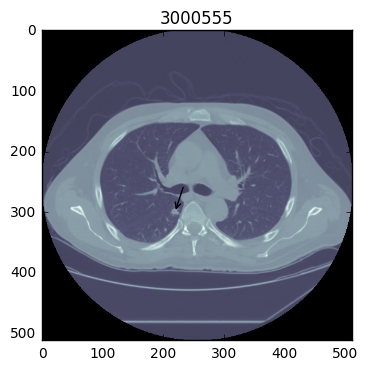

present = 3000555, next = 3000612
different number! 3000555
Lidc-Idri- 63
Slice no. 26
x = 133, y = 282


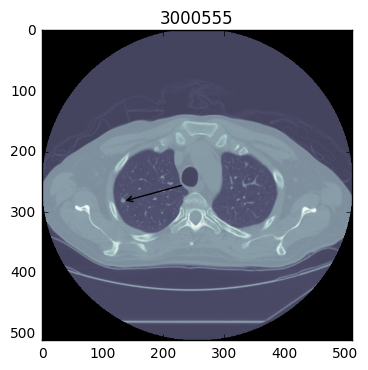

present = 3000612, next = 3000612
same number! 3000612
Lidc-Idri- 64
Slice no. 20
x = 196, y = 308


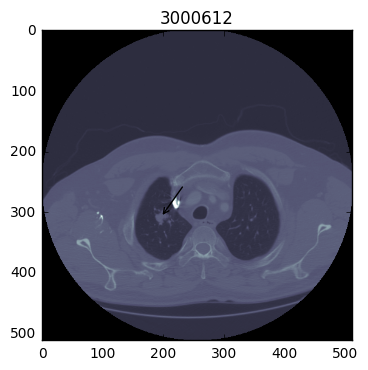

present = 3000612, next = 3000536
different number! 3000612
Lidc-Idri- 64
Slice no. 54
x = 398, y = 252


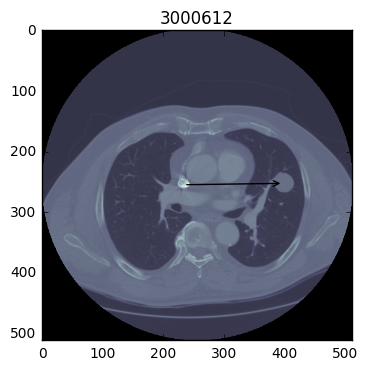

present = 3000536, next = 5576
different number! 3000536
Lidc-Idri- 65
Slice no. 146
x = 295, y = 376


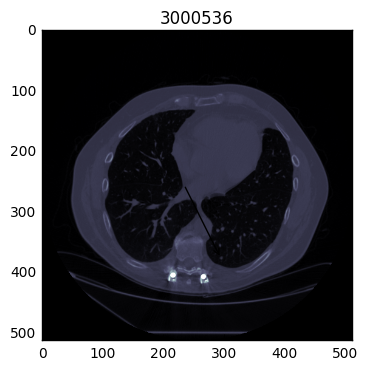

present = 5576, next = 5576
same number! 5576
Lidc-Idri- 66
Slice no. 69
x = 317, y = 332


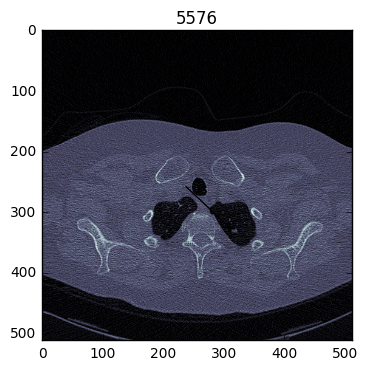

present = 5576, next = 5576
same number! 5576
Lidc-Idri- 66
Slice no. 283
x = 418, y = 370


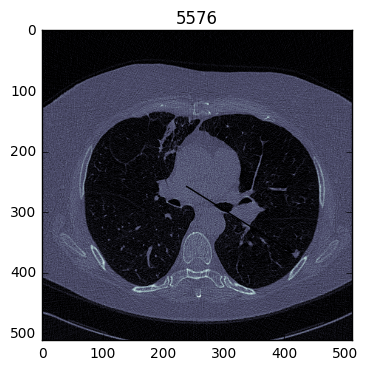

present = 5576, next = 3000708
different number! 5576
Lidc-Idri- 66
Slice no. 149
x = 194, y = 355


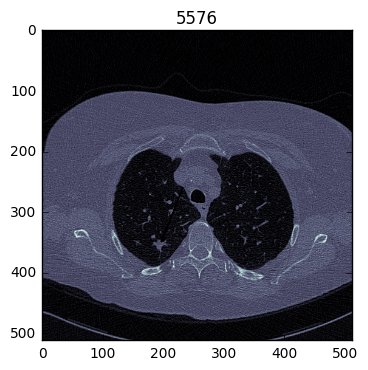

present = 3000708, next = 3000708
same number! 3000708
Lidc-Idri- 67
Slice no. 104
x = 256, y = 224


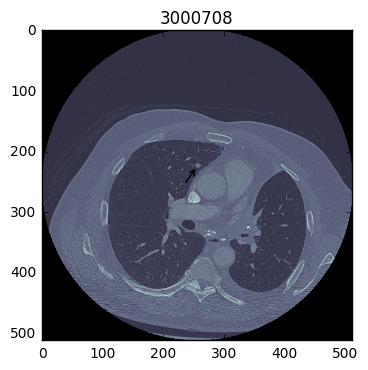

present = 3000708, next = 3000708
same number! 3000708
Lidc-Idri- 67
Slice no. 129
x = 428, y = 280


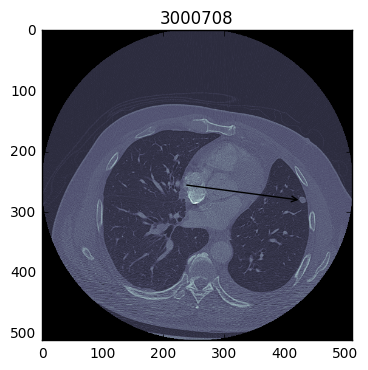

present = 3000708, next = 3000708
same number! 3000708
Lidc-Idri- 67
Slice no. 70
x = 418, y = 313


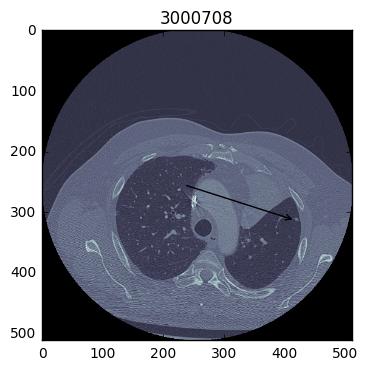

present = 3000708, next = 4
different number! 3000708
Lidc-Idri- 67
Slice no. 113
x = 420, y = 305


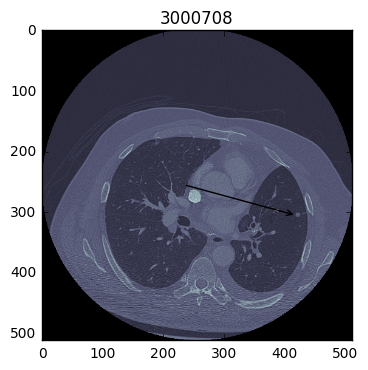

present = 4, next = 4
same number! 4
Lidc-Idri- 68
Slice no. 53
x = 410, y = 222


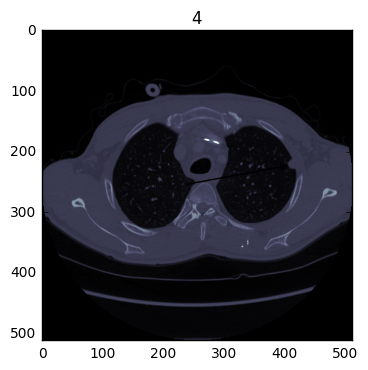

present = 4, next = 4
same number! 4
Lidc-Idri- 68
Slice no. 93
x = 102, y = 283


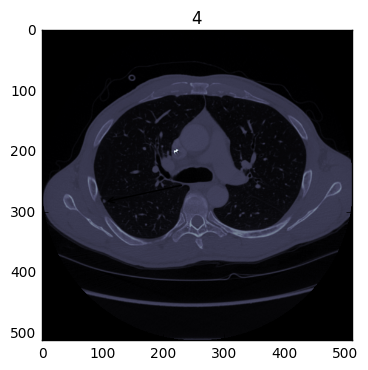

present = 4, next = 4
same number! 4
Lidc-Idri- 68
Slice no. 141
x = 324, y = 342


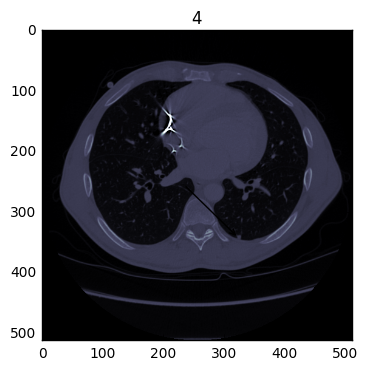

present = 4, next = 4
same number! 4
Lidc-Idri- 68
Slice no. 104
x = 178, y = 346


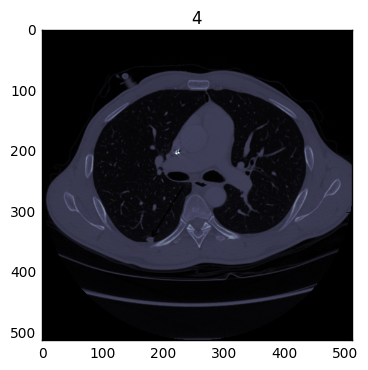

present = 4, next = 4
same number! 4
Lidc-Idri- 68
Slice no. 110
x = 412, y = 216


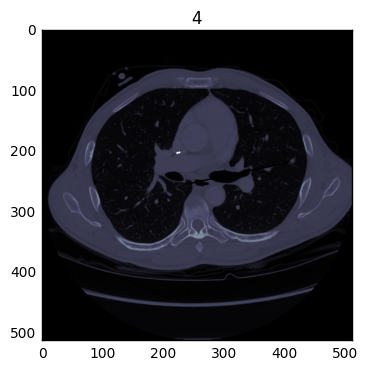

present = 4, next = 3079
different number! 4
Lidc-Idri- 68
Slice no. 45
x = 157, y = 204


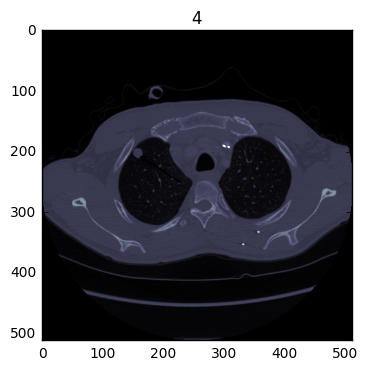

present = 3079, next = 3079
same number! 3079
Lidc-Idri- 69
Slice no. 83
x = 226, y = 339


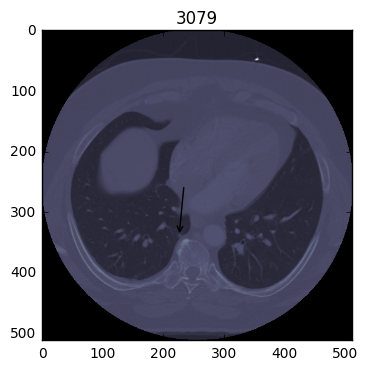

present = 3079, next = 3079
same number! 3079
Lidc-Idri- 69
Slice no. 95
x = 168, y = 369


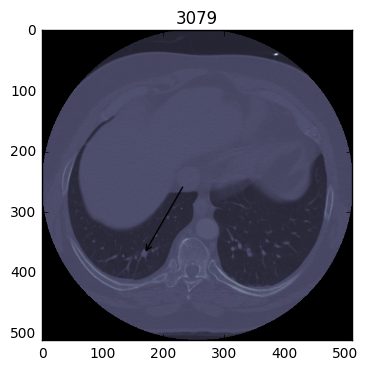

present = 3079, next = 3000667
different number! 3079
Lidc-Idri- 69
Slice no. 52
x = 125, y = 371


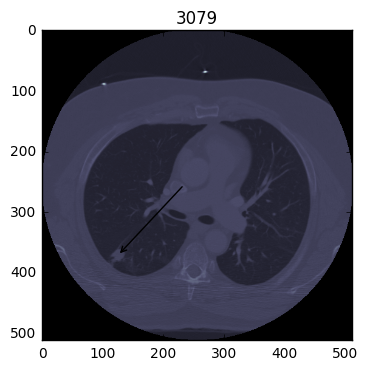

present = 3000667, next = 3000667
same number! 3000667
Lidc-Idri- 70
Slice no. 48
x = 181, y = 208


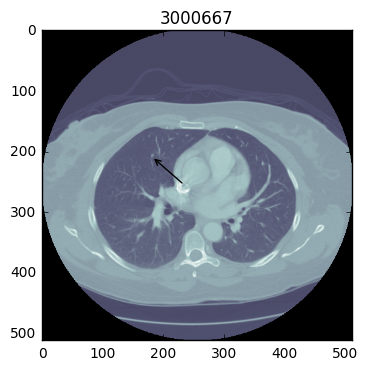

present = 3000667, next = 3000667
same number! 3000667
Lidc-Idri- 70
Slice no. 53
x = 376, y = 227


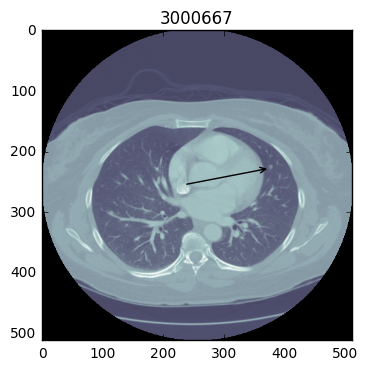

present = 3000667, next = 3000071
different number! 3000667
Lidc-Idri- 70
Slice no. 63
x = 130, y = 187


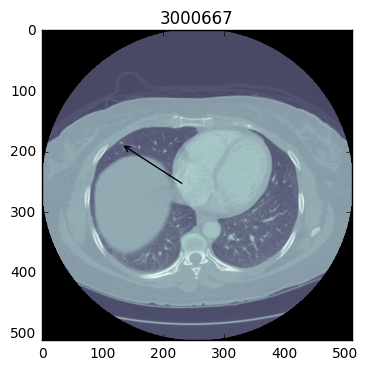

present = 3000071, next = 3000072
different number! 3000071
Lidc-Idri- 71
Slice no. -1
x = 0, y = 0


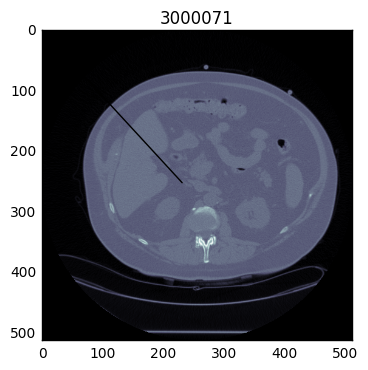

present = 3000072, next = 3000698
different number! 3000072
Lidc-Idri- 72
Slice no. 48
x = 179, y = 266


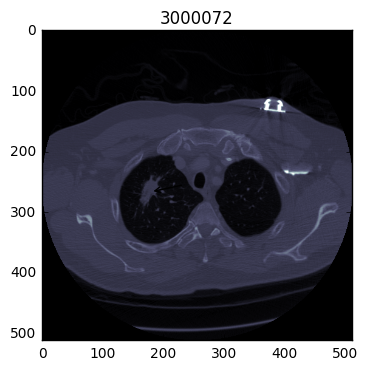

present = 3000698, next = 3000698
same number! 3000698
Lidc-Idri- 73
Slice no. 74
x = 306, y = 330


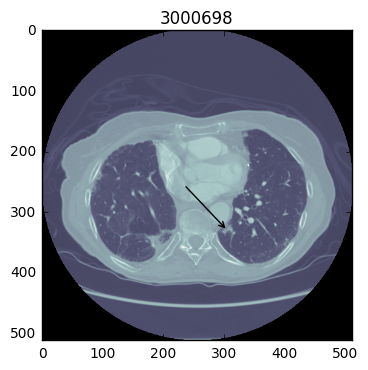

present = 3000698, next = 3000698
same number! 3000698
Lidc-Idri- 73
Slice no. 68
x = 324, y = 366


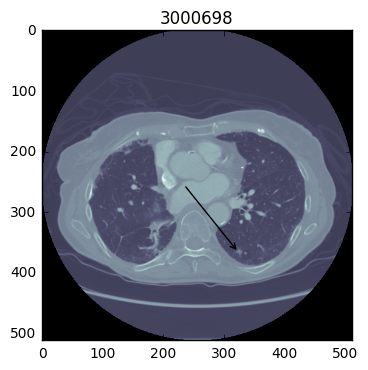

present = 3000698, next = 3000704
different number! 3000698
Lidc-Idri- 73
Slice no. 20
x = 339, y = 270


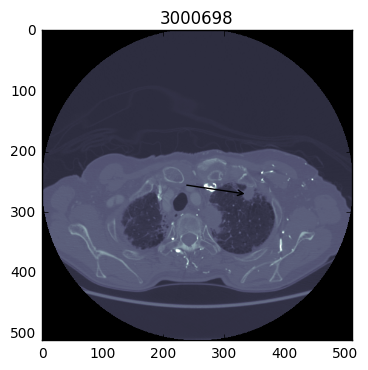

present = 3000704, next = 30083
different number! 3000704
Lidc-Idri- 74
Slice no. 28
x = 180, y = 241


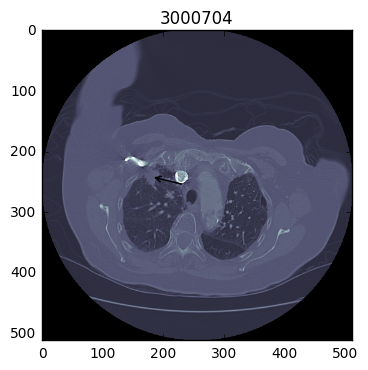

present = 30083, next = 30083
same number! 30083
Lidc-Idri- 75
Slice no. 36
x = 194, y = 253


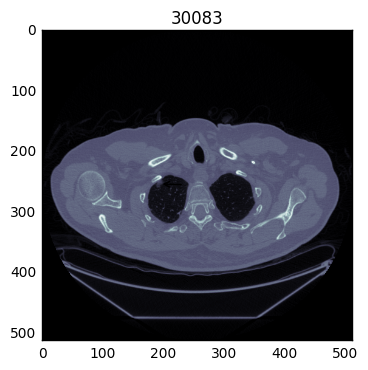

present = 30083, next = 30083
same number! 30083
Lidc-Idri- 75
Slice no. 77
x = 347, y = 312


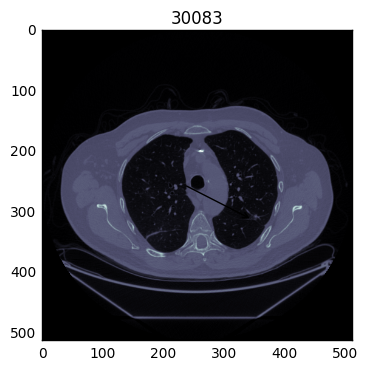

present = 30083, next = 30083
same number! 30083
Lidc-Idri- 75
Slice no. 95
x = 184, y = 320


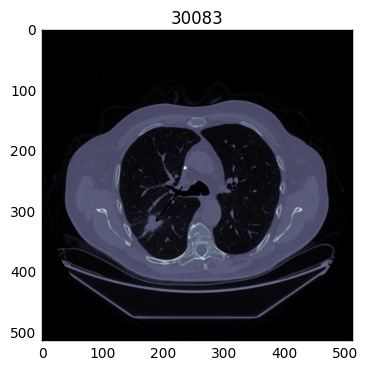

present = 30083, next = 3000734
different number! 30083
Lidc-Idri- 75
Slice no. 170
x = 312, y = 362


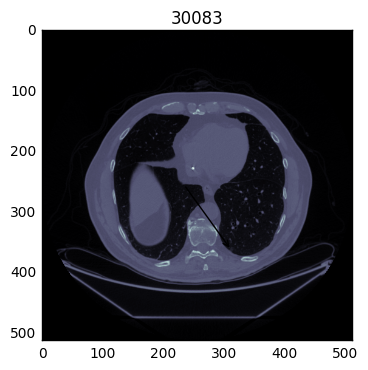

present = 3000734, next = 3000734
same number! 3000734
Lidc-Idri- 76
Slice no. 165
x = 88, y = 289


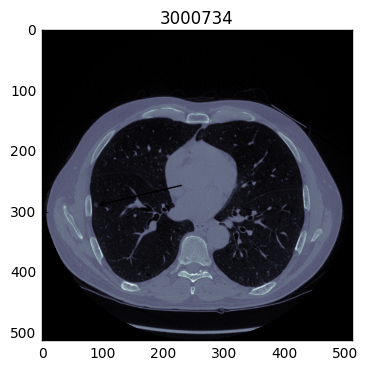

present = 3000734, next = 3000706
different number! 3000734
Lidc-Idri- 76
Slice no. 221
x = 74, y = 286


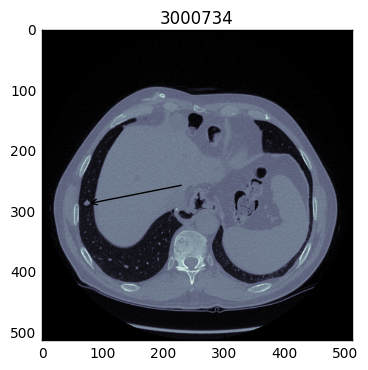

present = 3000706, next = 3000706
same number! 3000706
Lidc-Idri- 77
Slice no. 21
x = 382, y = 279


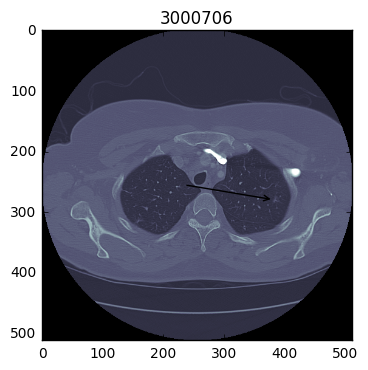

present = 3000706, next = 3165
different number! 3000706
Lidc-Idri- 77
Slice no. 57
x = 221, y = 290


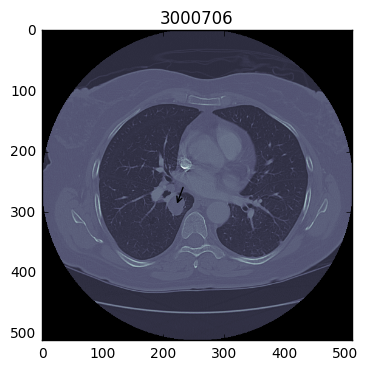

present = 3165, next = 3165
same number! 3165
Lidc-Idri- 78
Slice no. 40
x = 361, y = 170


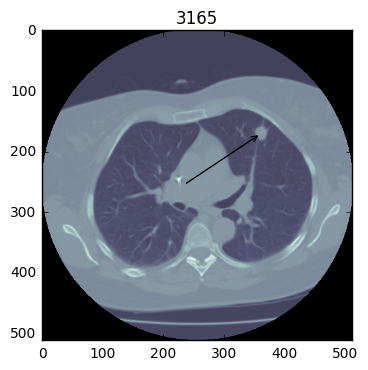

present = 3165, next = 3165
same number! 3165
Lidc-Idri- 78
Slice no. 61
x = 332, y = 313


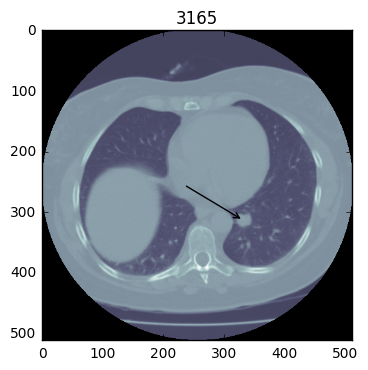

present = 3165, next = 3165
same number! 3165
Lidc-Idri- 78
Slice no. 18
x = 341, y = 245


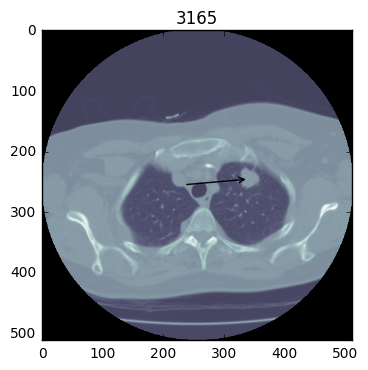

present = 3165, next = 3278
different number! 3165
Lidc-Idri- 78
Slice no. 39
x = 336, y = 349


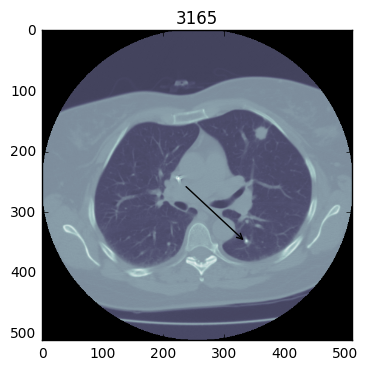

present = 3278, next = 3000733
different number! 3278
Lidc-Idri- 79
Slice no. 43
x = 361, y = 386


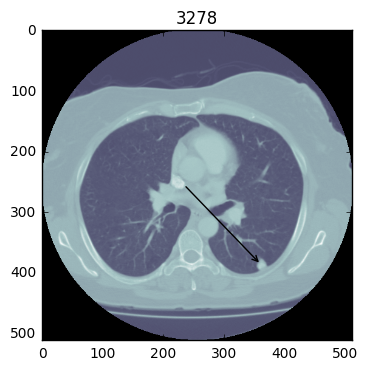

present = 3000733, next = 3000733
same number! 3000733
Lidc-Idri- 80
Slice no. 174
x = 212, y = 298


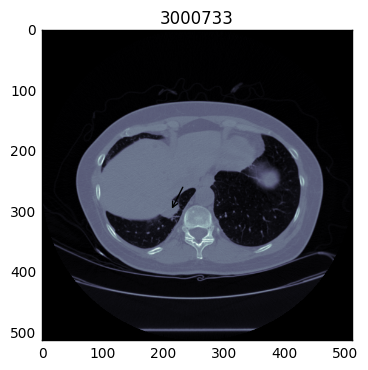

present = 3000733, next = 3000649
different number! 3000733
Lidc-Idri- 80
Slice no. 159
x = 208, y = 284


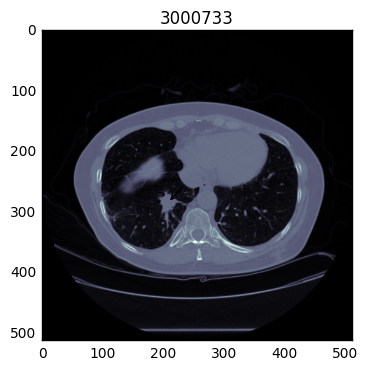

present = 3000649, next = 3000649
same number! 3000649
Lidc-Idri- 81
Slice no. 58
x = 161, y = 298


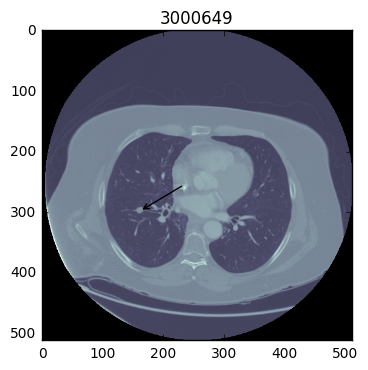

present = 3000649, next = 3000701
different number! 3000649
Lidc-Idri- 81
Slice no. 27
x = 136, y = 328


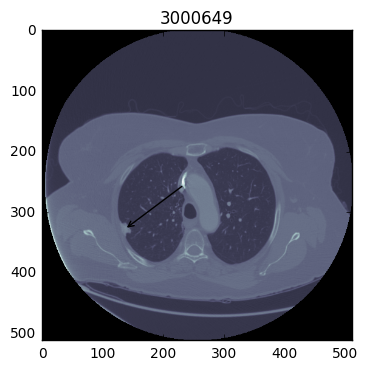

present = 3000701, next = 3000646
different number! 3000701
Lidc-Idri- 82
Slice no. 68
x = 108, y = 332


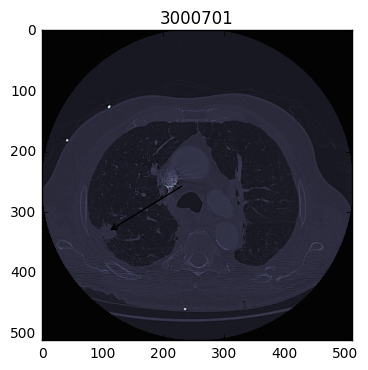

present = 3000646, next = 3000646
same number! 3000646
Lidc-Idri- 83
Slice no. 166
x = 311, y = 328


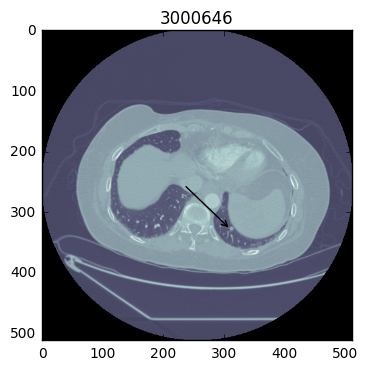

present = 3000646, next = 3211
different number! 3000646
Lidc-Idri- 83
Slice no. 101
x = 344, y = 352


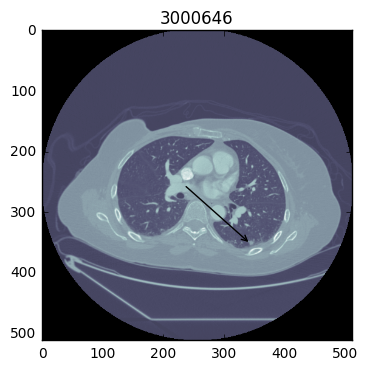

present = 3211, next = 3211
same number! 3211
Lidc-Idri- 84
Slice no. 41
x = 200, y = 339


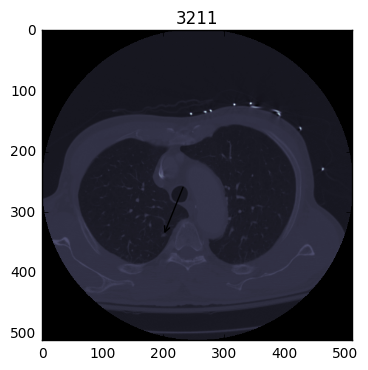

present = 3211, next = 3211
same number! 3211
Lidc-Idri- 84
Slice no. 126
x = 80, y = 165


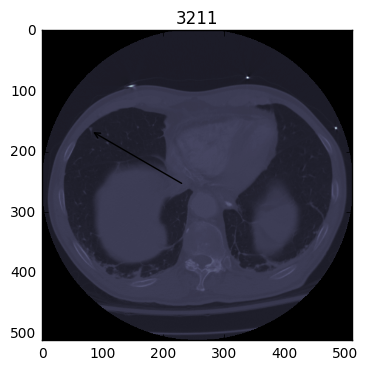

present = 3211, next = 3211
same number! 3211
Lidc-Idri- 84
Slice no. 48
x = 88, y = 250


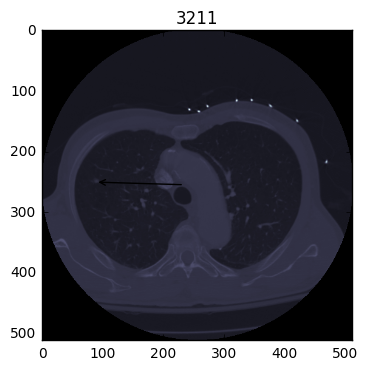

present = 3211, next = 3211
same number! 3211
Lidc-Idri- 84
Slice no. 110
x = 81, y = 361


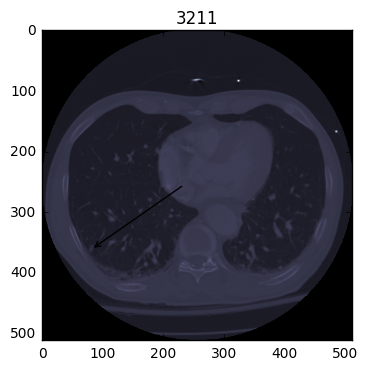

present = 3211, next = 3211
same number! 3211
Lidc-Idri- 84
Slice no. 109
x = 442, y = 291


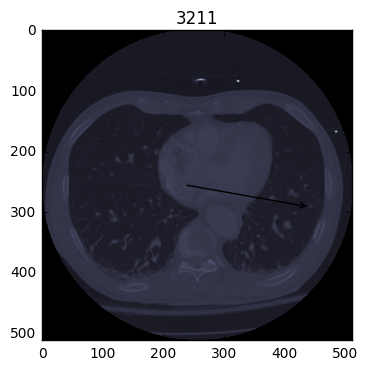

present = 3211, next = 30084
different number! 3211
Lidc-Idri- 84
Slice no. 50
x = 89, y = 301


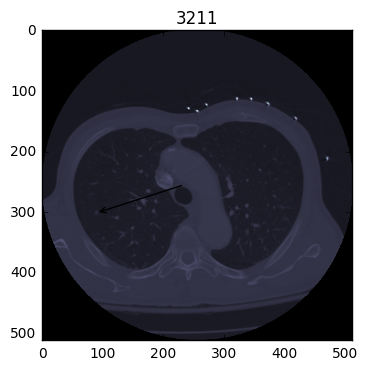

present = 30084, next = 30084
same number! 30084
Lidc-Idri- 85
Slice no. 125
x = 145, y = 202


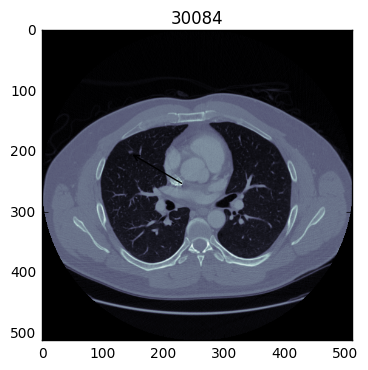

present = 30084, next = 5604
different number! 30084
Lidc-Idri- 85
Slice no. 84
x = 233, y = 315


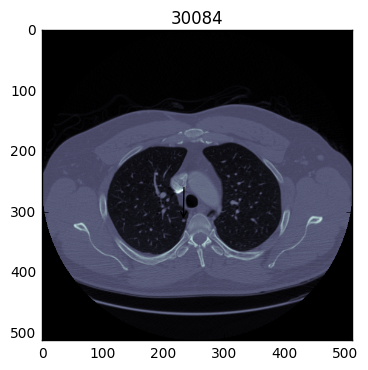

present = 5604, next = 3000640
different number! 5604
Lidc-Idri- 86
Slice no. 145
x = 429, y = 286


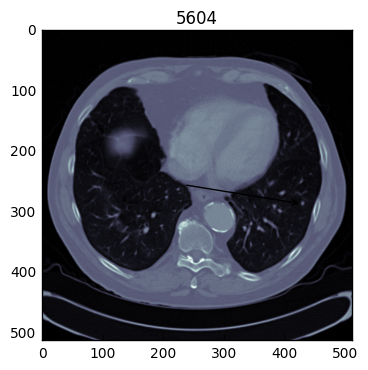

present = 3000640, next = 3000640
same number! 3000640
Lidc-Idri- 87
Slice no. 22
x = 186, y = 242


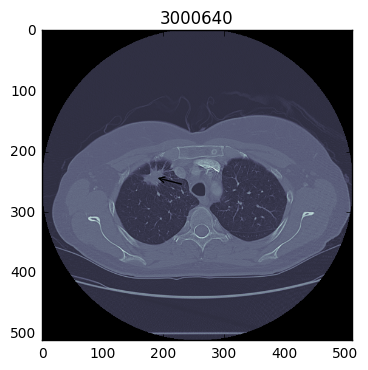

present = 3000640, next = 3000088
different number! 3000640
Lidc-Idri- 87
Slice no. 10
x = 344, y = 320


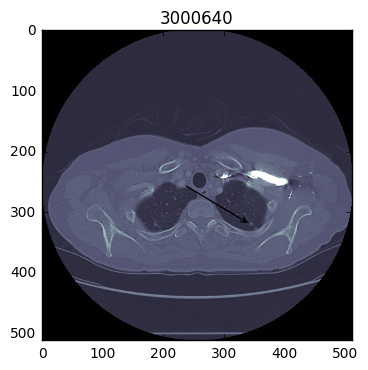

present = 3000088, next = 3000088
same number! 3000088
Lidc-Idri- 88
Slice no. 166
x = 390, y = 373


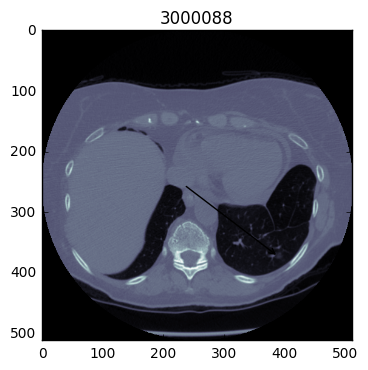

present = 3000088, next = 3000088
same number! 3000088
Lidc-Idri- 88
Slice no. 86
x = 155, y = 272


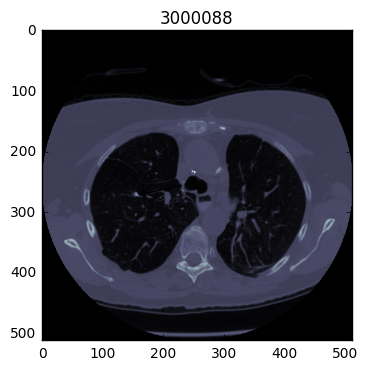

present = 3000088, next = 3000707
different number! 3000088
Lidc-Idri- 88
Slice no. 58
x = 401, y = 313


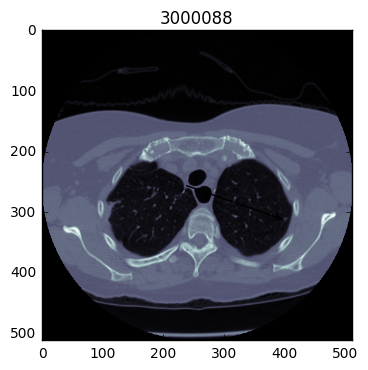

present = 3000707, next = 3000090
different number! 3000707
Lidc-Idri- 89
Slice no. 97
x = 368, y = 228


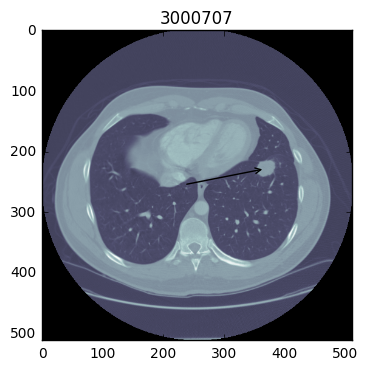

present = 3000090, next = 3000091
different number! 3000090
Lidc-Idri- 90
Slice no. 32
x = 119, y = 284


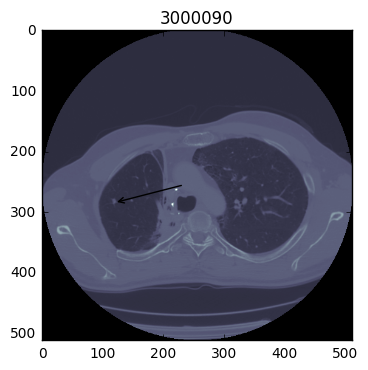

present = 3000091, next = 3000091
same number! 3000091
Lidc-Idri- 91
Slice no. 35
x = 176, y = 273


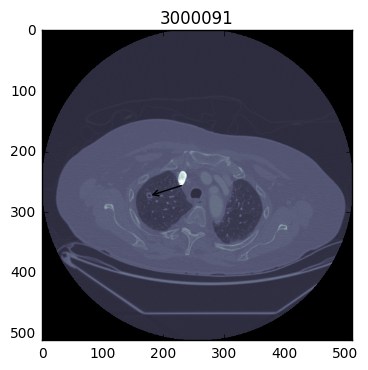

present = 3000091, next = 3000091
same number! 3000091
Lidc-Idri- 91
Slice no. 137
x = 393, y = 226


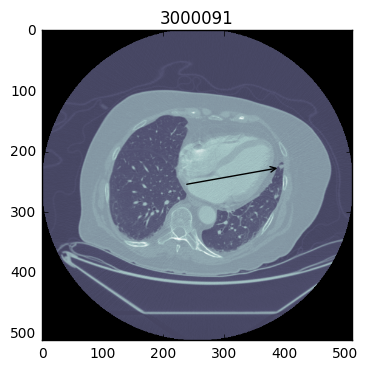

present = 3000091, next = 3000091
same number! 3000091
Lidc-Idri- 91
Slice no. 95
x = 179, y = 207


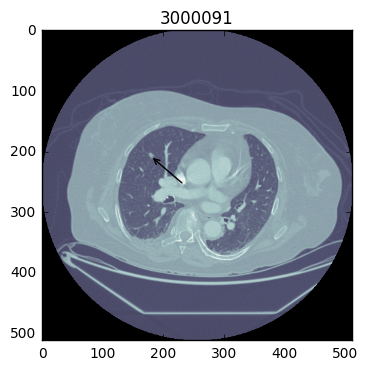

present = 3000091, next = 3000091
same number! 3000091
Lidc-Idri- 91
Slice no. 43
x = 195, y = 321


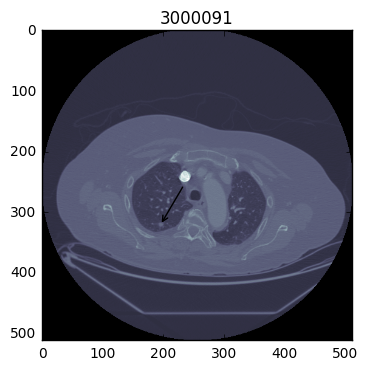

present = 3000091, next = 3000774
different number! 3000091
Lidc-Idri- 91
Slice no. 164
x = 304, y = 334


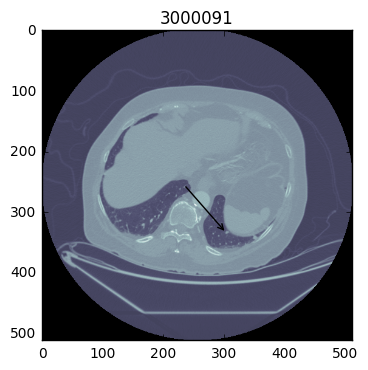

present = 3000774, next = 3000774
same number! 3000774
Lidc-Idri- 92
Slice no. 28
x = 348, y = 260


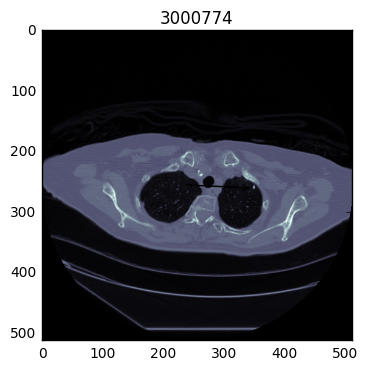

present = 3000774, next = 3000774
same number! 3000774
Lidc-Idri- 92
Slice no. 79
x = 213, y = 229


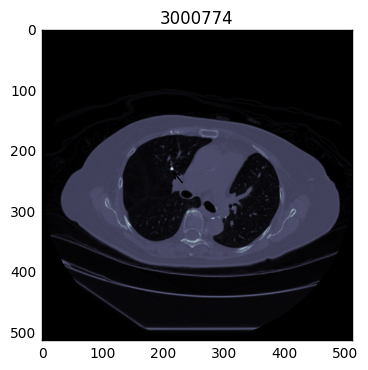

present = 3000774, next = 3000774
same number! 3000774
Lidc-Idri- 92
Slice no. 62
x = 204, y = 304


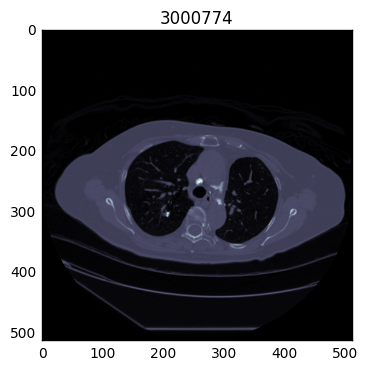

present = 3000774, next = 3000688
different number! 3000774
Lidc-Idri- 92
Slice no. 41
x = 173, y = 289


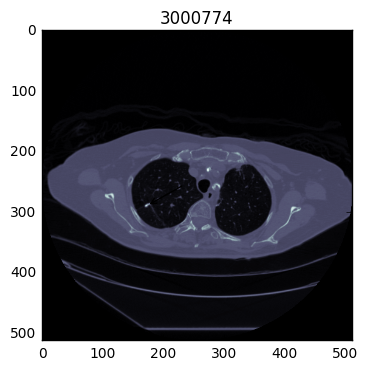

present = 3000688, next = 3000688
same number! 3000688
Lidc-Idri- 93
Slice no. 69
x = 371, y = 395


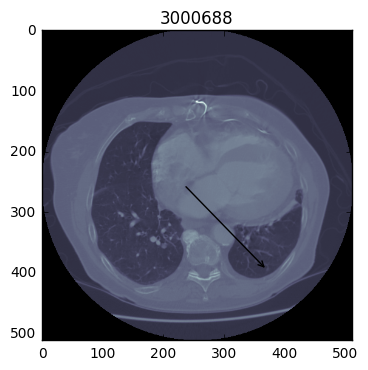

present = 3000688, next = 5587
different number! 3000688
Lidc-Idri- 93
Slice no. 68
x = 201, y = 356


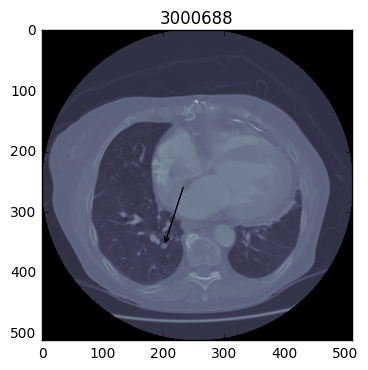

present = 5587, next = 5610
different number! 5587
Lidc-Idri- 94
Slice no. 82
x = 147, y = 279


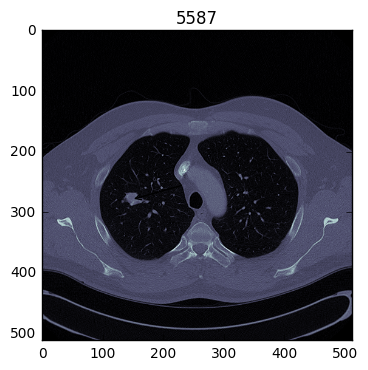

present = 5610, next = 5610
same number! 5610
Lidc-Idri- 95
Slice no. 135
x = 366, y = 234


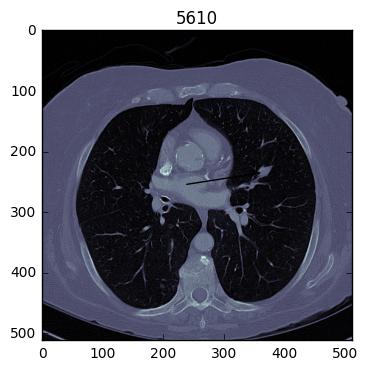

present = 5610, next = 5610
same number! 5610
Lidc-Idri- 95
Slice no. 149
x = 419, y = 197


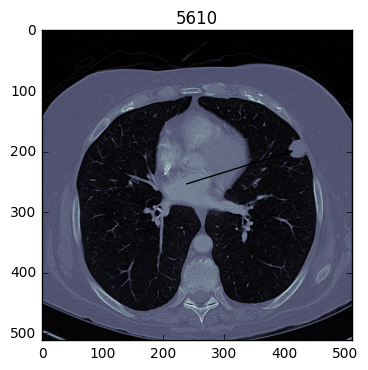

present = 5610, next = 3000693
different number! 5610
Lidc-Idri- 95
Slice no. 140
x = 401, y = 170


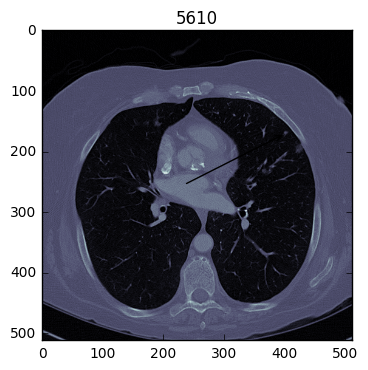

present = 3000693, next = 3000738
different number! 3000693
Lidc-Idri- 96
Slice no. 17
x = 218, y = 339


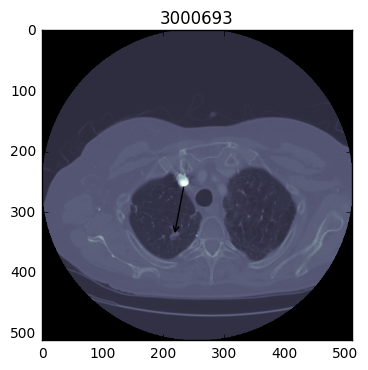

present = 3000738, next = 3094
different number! 3000738
Lidc-Idri- 97
Slice no. 131
x = 148, y = 279


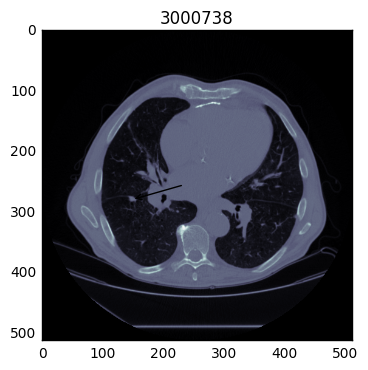

present = 3094, next = 3000655
different number! 3094
Lidc-Idri- 98
Slice no. 29
x = 282, y = 190


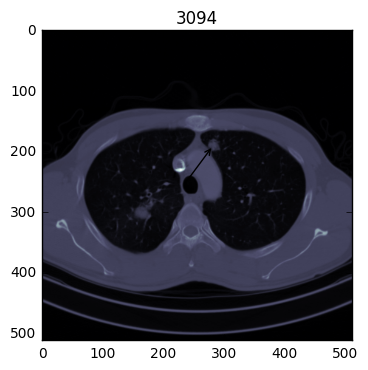

present = 3000655, next = 3000655
same number! 3000655
Lidc-Idri- 99
Slice no. 113
x = 154, y = 286


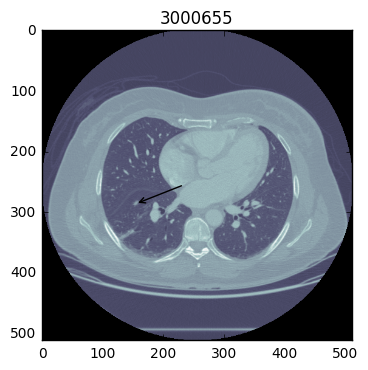

present = 3000655, next = 3000655
same number! 3000655
Lidc-Idri- 99
Slice no. 142
x = 125, y = 330


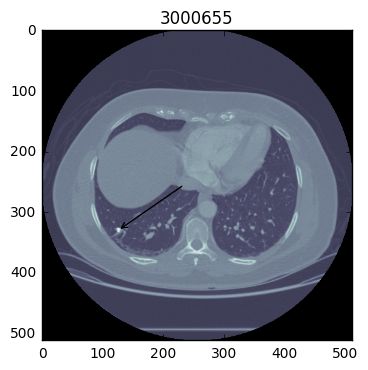

present = 3000655, next = 3000655
same number! 3000655
Lidc-Idri- 99
Slice no. 96
x = 183, y = 176


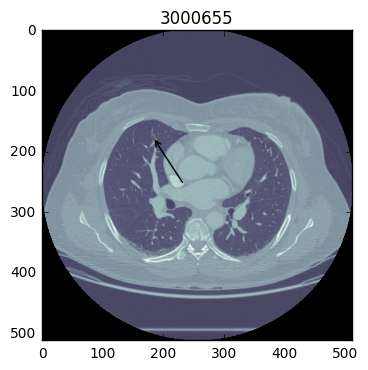

present = 3000655, next = 3000100
different number! 3000655
Lidc-Idri- 99
Slice no. 149
x = 295, y = 338


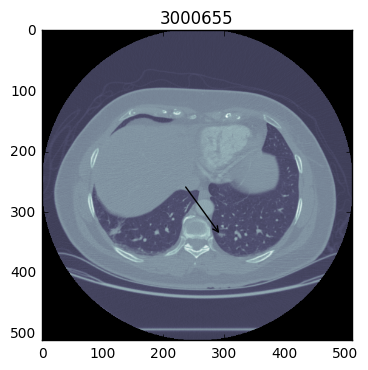

present = 3000100, next = 3192
different number! 3000100
Lidc-Idri- 100
Slice no. -1
x = 0, y = 0


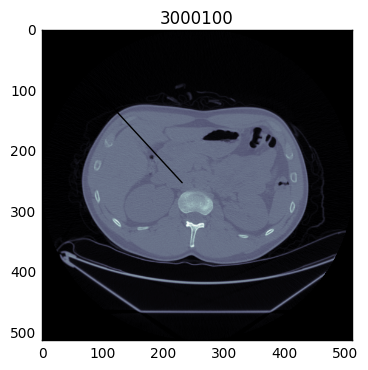

present = 3192, next = 3192
same number! 3192
Lidc-Idri- 101
Slice no. 58


IndexError: list index out of range

In [134]:
# Let's look at one of the patients
# 印出該資料夾所有 Hu 總和分佈
first_patient = load_scan(patients[2])
first_patient_pixels = get_pixels_hu(first_patient)
plt.hist(first_patient_pixels.flatten(), bins=80, color='c')
plt.title("All of then")
plt.xlabel("Hounsfield Units (HU)")
plt.ylabel("Frequency")
plt.show()


# 印出有結節在的那張 HU
nodule_patient = load_scan(patients[2])
nodule_patient_pixels = get_pixels_hu(nodule_patient)
nodule_slice_pixels = nodule_patient_pixels[56]
plt.hist(nodule_slice_pixels.flatten(), bins=80, color='c')
plt.title("Slice")
plt.xlabel("Hounsfield Units (HU)")
plt.ylabel("Frequency")
plt.show()


# list3.2的scan可以和meta['Series UID']的後五字做結合, 用來快速尋找肺部CT所在資料夾

import scipy
"""
# Show some slice in the middle
# data=scipy.ndimage.interpolation.zoom(first_patient_pixels[41],[200,200])
plt.figure()
plt.imshow(first_patient_pixels[56], cmap=plt.cm.bone) # cmap = 顏色圖譜
plt.annotate('', xy=(nodulelocations['x loc.'][2], nodulelocations['y loc.'][2]), xycoords='data',   
             xytext=(0.5, 0.5), textcoords='figure fraction',
             arrowprops=dict(arrowstyle="->"))
#plt.savefig("images/test.png",dpi=300)
plt.show()
"""

# 存在CT的每一位路徑 path_patients[i]
# 同個 path_patients[i], 但有不同編號切片的data

#temp = "3000566"
#print("temp = " + str(temp))

# 標出所有結節的圖片位置
for i in range(0,298):
    #plt.figure()
    # 如果下一個的編號 = temp, 則 i 維持不變繼續尋找 nodule, 直到下一個編號 != temp, 則 i 繼續計數
    present_scan = nodulelocations['scan'][i]
    next_scan = nodulelocations['scan'][i+1]
    print("present = " + str(present_scan) + ", "+ "next = " + str(next_scan))
    if str(next_scan) == str(present_scan):
        # path_patients["path"].str.split("/").str.get(8).str.title().str.split("-").str.get(0).str.title().loc[i]
        #print("LIDC number = " + str(path_patients["path"].str.split("/").str.get(8).str.title().str.split("-").str.get(0).str.title().loc[nodulelocations['case'][i]-1]))
        
        # 印出 path_patients 對應到的 number
        print("same number! " + str(present_scan))
        
        # 取該行的 'case'的 number-1, 當作 ct主資料夾路徑
        # 取該行的 'slice no.'的 number, 當作第幾個切片
        a = nodulelocations['case'][i]-1
        b = nodulelocations['slice no.'][i]-1
        print("Lidc-Idri- " + str(a+1) + "\n" + "Slice no. " + str(b))
        
        # 繪製箭頭在圖上
        plt.figure()
        nodule_patient2 = load_scan(patients[a])
        nodule_patient_pixels2 = get_pixels_hu(nodule_patient2)
        plt.imshow(nodule_patient_pixels2[b], cmap=plt.cm.bone)
        print("x = " + str(nodulelocations['x loc.'][i]) + ", " + "y = " + str(nodulelocations['y loc.'][i]))
        plt.annotate('', xy=(nodulelocations['x loc.'][i], nodulelocations['y loc.'][i]), xycoords='data',   
                 xytext=(0.5, 0.5), textcoords='figure fraction',
                 arrowprops=dict(arrowstyle="->"))
        plt.title(present_scan)
        plt.show()
    else:
        print("different number! " + str(present_scan))   
        
        # 取該行的 'case'的 number-1, 當作 ct主資料夾路徑
        # 取該行的 'slice no.'的 number, 當作第幾個切片
        a = nodulelocations['case'][i]-1
        b = nodulelocations['slice no.'][i]-1
        print("Lidc-Idri- " + str(a+1) + "\n" + "Slice no. " + str(b))
        
        # 繪製箭頭在圖上
        plt.figure()
        nodule_patient2 = load_scan(patients[a])
        nodule_patient_pixels2 = get_pixels_hu(nodule_patient2)
        plt.imshow(nodule_patient_pixels2[b], cmap=plt.cm.bone)
        print("x = " + str(nodulelocations['x loc.'][i]) + ", " + "y = " + str(nodulelocations['y loc.'][i]))
        plt.annotate('', xy=(nodulelocations['x loc.'][i], nodulelocations['y loc.'][i]), xycoords='data',   
                 xytext=(0.5, 0.5), textcoords='figure fraction',
                 arrowprops=dict(arrowstyle="->"))
        plt.title(present_scan)
        plt.show()

In [135]:
def processimage(img):
    #function sourced from https://www.kaggle.com/c/data-science-bowl-2017#tutorial
    #Standardize the pixel values
    mean = np.mean(img)
    std = np.std(img)
    img = img-mean
    img = img/std
    #plt.hist(img.flatten(),bins=200)
    #plt.show()
    #print(thresh_img[366][280:450])
    middle = img[100:400,100:400] 
    mean = np.mean(middle)  
    max = np.max(img)
    min = np.min(img)
    #move the underflow bins
    img[img==max]=mean
    img[img==min]=mean
    kmeans = KMeans(n_clusters=2).fit(np.reshape(middle,[np.prod(middle.shape),1]))
    centers = sorted(kmeans.cluster_centers_.flatten())
    threshold = np.mean(centers)
    thresh_img = np.where(img<threshold,1.0,0.0)  # threshold the image
    eroded = morphology.erosion(thresh_img,np.ones([4,4]))
    dilation = morphology.dilation(eroded,np.ones([10,10]))
    labels = measure.label(dilation)
    label_vals = np.unique(labels)
    #plt.imshow(labels)
    #plt.show()
    labels = measure.label(dilation)
    label_vals = np.unique(labels)
    regions = measure.regionprops(labels)
    good_labels = []
    for prop in regions:
        B = prop.bbox
        if B[2]-B[0]<475 and B[3]-B[1]<475 and B[0]>40 and B[2]<472:
            good_labels.append(prop.label)
    mask = np.ndarray([512,512],dtype=np.int8)
    mask[:] = 0
    #
    #  The mask here is the mask for the lungs--not the nodes
    #  After just the lungs are left, we do another large dilation
    #  in order to fill in and out the lung mask 
    #
    for N in good_labels:
        mask = mask + np.where(labels==N,1,0)
    mask = morphology.dilation(mask,np.ones([10,10])) # one last dilation
    return mask*img

def nodule_coordinates(nodulelocations,meta):
    slices=nodulelocations["slice no."][nodulelocations.index[nodulelocations["case"]==int(meta["Patient Id"][-4:])]]
    xlocs=nodulelocations["x loc."][nodulelocations.index[nodulelocations["case"]==int(meta["Patient Id"][-4:])]]
    ylocs=nodulelocations["y loc."][nodulelocations.index[nodulelocations["case"]==int(meta["Patient Id"][-4:])]]
    nodulecoord=[]
    for i in range(len(slices)):
        nodulecoord.append([slices.values[i]-1,xlocs.values[i]-1,ylocs.values[i]-1])
    return nodulecoord

In [136]:
#Generate and save nodule images for all samples
'''
for i in range(15,len(patients)):
    print(i)
    first_patient = load_scan(patients[i])
    first_patient_pixels = get_pixels_hu(first_patient)
    nodcord=nodule_coordinates(nodulelocations,meta.loc[i])
    for j in range(len(nodcord)):
        #plt.imsave("images/"+meta['Patient Id'].loc[i]+"slice"+str(slice)+".png",first_patient_pixels[slice])
        plt.figure()
        plt.imshow(first_patient_pixels[nodcord[j][0]])
        plt.annotate('', xy=(nodcord[j][1], nodcord[j][2]), xycoords='data',
             xytext=(0.5, 0.5), textcoords='figure fraction',
             arrowprops=dict(arrowstyle="->"))
        plt.savefig("images/"+meta['Patient Id'].loc[i]+"slice"+str(nodcord[j])+".png",dpi=300)
        plt.close()
'''

'\nfor i in range(15,len(patients)):\n    print(i)\n    first_patient = load_scan(patients[i])\n    first_patient_pixels = get_pixels_hu(first_patient)\n    nodcord=nodule_coordinates(nodulelocations,meta.loc[i])\n    for j in range(len(nodcord)):\n        #plt.imsave("images/"+meta[\'Patient Id\'].loc[i]+"slice"+str(slice)+".png",first_patient_pixels[slice])\n        plt.figure()\n        plt.imshow(first_patient_pixels[nodcord[j][0]])\n        plt.annotate(\'\', xy=(nodcord[j][1], nodcord[j][2]), xycoords=\'data\',\n             xytext=(0.5, 0.5), textcoords=\'figure fraction\',\n             arrowprops=dict(arrowstyle="->"))\n        plt.savefig("images/"+meta[\'Patient Id\'].loc[i]+"slice"+str(nodcord[j])+".png",dpi=300)\n        plt.close()\n'

In [137]:
noduleimages=np.ndarray([len(nodulelocations)*3,512,512],dtype=np.float32)
nodulemasks=np.ndarray([len(nodulelocations)*3,512,512],dtype=np.bool)
nodulemaskscircle=np.ndarray([len(nodulelocations)*3,512,512],dtype=np.bool)
index=0
totaltime=50000
start_time=time.time()
elapsed_time=0
nodulemeanhu=[]
nonnodulemeanhu=[]
thresh=-500
for i in range(len(patients)):
    print("Processing patient#",i,"ETA:",(totaltime-elapsed_time)/3600,"hrs")
    coord=nodule_coordinates(nodulelocations,meta.iloc[i])
    if len(coord)>0:
        patient=load_scan(patients[i])
        patient_pix=get_pixels_hu(patient)
        radius=nodulelocations["eq. diam."][nodulelocations.index[nodulelocations["case"]==int(meta["Patient Id"][i][-4:])]]
        nodulemask=np.ndarray([len(coord),512,512],dtype=np.bool)
        for j,cord in enumerate(coord):
            segmented_mask_fill=segment_lung_mask(patient_pix,True,False)
            if radius.iloc[j]>5:
                #slice nodulecenter-1
                noduleimages[index]=processimage(patient_pix[cord[0]-1])
                nodulemasks[index]=cmw.cell_magic_wand(-patient_pix[int(cord[0])-1],[int(cord[2]),int(cord[1])],2,int(radius.iloc[j])+2)
                rr,cc=circle(int(cord[2]),int(cord[1]),int(radius.iloc[j]))
                imgcircle = np.zeros((512, 512), dtype=np.int16)
                imgcircle[rr,cc]=1
                nodulepixcircle=imgcircle*patient_pix[cord[0]-1]
                nodulepixcircle[nodulepixcircle<thresh]=0
                nodulepixcircle[nodulepixcircle!=0]=1
                nodulemaskscircle[index]=nodulepixcircle.astype(np.bool)
                
                nodulepix=nodulemasks[index]*patient_pix[cord[0]-1]
                nodulepix[nodulepix<thresh]=0
                nodulepix[nodulepix!=0]=1
                nodulemasks[index]=nodulepix.astype(np.bool)
                index+=1
                
                #slice nodulecenter
                noduleimages[index]=processimage(patient_pix[cord[0]])
                nodulemasks[index]=cmw.cell_magic_wand(-patient_pix[int(cord[0])],[int(cord[2]),int(cord[1])],2,int(radius.iloc[j])+2)
                nodulepix=nodulemasks[index]*patient_pix[cord[0]]
                nodulepix[nodulepix<thresh]=0
                nodulepixcircle=imgcircle*patient_pix[cord[0]]
                nodulepixcircle[nodulepixcircle<thresh]=0
                
                #get mean nodule HU value

                #get mean non-nodule HU value
                nonnodule=(nodulemasks[index].astype(np.int16)-1)*-1*segmented_mask_fill[cord[0]]*patient_pix[cord[0]]
                nonnodule[nonnodule<thresh]=0
                nonnodulemeanhu.append(np.mean(nonnodule[nonnodule!=0]))
                plt.figure()
                #plt.hist(nodulepix[nodulepix!=0].flatten(),bins=80, alpha=0.5, color='blue')
                plt.hist(nonnodule[nonnodule!=0].flatten(),bins=80, alpha=0.5, color='orange')
                plt.hist(nodulepixcircle[nodulepix!=0].flatten(),bins=80,alpha=0.5, color='green')
                # 原本只有 "histplots/"
                plt.savefig("D:/Downloads/ALL_CANCER_NODULE_DETECTION_PROJECT_1/LungNoduleDetectionClassification-master/LIDC/histplots/"
                            +meta['Patient Id'].loc[i]+"slice"+str(cord)+".png",dpi=300)
                plt.close()
                nodulemeanhu.append(np.mean(nodulepix[nodulepix!=0]))
                nodulepix[nodulepix!=0]=1
                nodulemasks[index]=nodulepix.astype(np.bool)
                nodulepixcircle[nodulepixcircle!=0]=1
                nodulemaskscircle[index]=nodulepixcircle.astype(np.bool)
                index+=1
                
                #slice nodulecenter+1
                noduleimages[index]=processimage(patient_pix[cord[0]+1])
                nodulemasks[index]=cmw.cell_magic_wand(-patient_pix[int(cord[0])+1],[int(cord[2]),int(cord[1])],2,int(radius.iloc[j])+2)
                nodulepix=nodulemasks[index]*patient_pix[cord[0]+1]
                nodulepix[nodulepix<thresh]=0
                nodulepix[nodulepix!=0]=1
                nodulemasks[index]=nodulepix.astype(np.bool)
                nodulepixcircle=imgcircle*patient_pix[cord[0]+1]
                nodulepixcircle[nodulepixcircle<thresh]=0
                nodulepixcircle[nodulepixcircle!=0]=1
                nodulemaskscircle[index]=nodulepixcircle.astype(np.bool)
                index+=1
    elapsed_time=time.time()-start_time
    totaltime=elapsed_time/(i+1)*len(patients)
np.save(datafolder+'/noduleimages.npy',noduleimages)
np.save(datafolder+'/nodulemasks.npy',nodulemasks)
np.save(datafolder+'/nodulemaskscircle.npy',nodulemaskscircle)

Processing patient# 0 ETA: 13.88888888888889 hrs
Processing patient# 1 ETA: 0.30078063368797303 hrs
Processing patient# 2 ETA: 0.3659354165527556 hrs
Processing patient# 3 ETA: 0.5831419590667442 hrs
Processing patient# 4 ETA: 0.5175628646214803 hrs
Processing patient# 5 ETA: 0.5564033649365108 hrs
Processing patient# 6 ETA: 0.6076044075135832 hrs
Processing patient# 7 ETA: 0.592969154346557 hrs
Processing patient# 8 ETA: 0.5719789371887842 hrs
Processing patient# 9 ETA: 0.5731019197275609 hrs
Processing patient# 10 ETA: 0.6212961775064468 hrs
Processing patient# 11 ETA: 0.7148470230415613 hrs
Processing patient# 12 ETA: 0.847361195175736 hrs
Processing patient# 13 ETA: 0.8215039685597786 hrs
Processing patient# 14 ETA: 0.7686876088759257 hrs
Processing patient# 15 ETA: 0.7305982534311436 hrs
Processing patient# 16 ETA: 0.7538683077692986 hrs
Processing patient# 17 ETA: 0.7215446503723368 hrs


c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid va

Processing patient# 18 ETA: 0.7166514115716204 hrs
Processing patient# 19 ETA: 0.6925973623677304 hrs
Processing patient# 20 ETA: 0.6802435451083713 hrs
Processing patient# 21 ETA: 0.670145567188818 hrs
Processing patient# 22 ETA: 0.6412841781161047 hrs
Processing patient# 23 ETA: 0.6148134666278167 hrs
Processing patient# 24 ETA: 0.6114656309397133 hrs
Processing patient# 25 ETA: 0.5924737163384756 hrs


c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Processing patient# 26 ETA: 0.5840454666431133 hrs
Processing patient# 27 ETA: 0.5994098717562947 hrs
Processing patient# 28 ETA: 0.5750033169133322 hrs
Processing patient# 29 ETA: 0.5598691484343502 hrs
Processing patient# 30 ETA: 0.5441248186870857 hrs
Processing patient# 31 ETA: 0.544322228457338 hrs
Processing patient# 32 ETA: 0.5271983325812551 hrs
Processing patient# 33 ETA: 0.5146582059888326 hrs
Processing patient# 34 ETA: 0.4996751768098159 hrs
Processing patient# 35 ETA: 0.4829009275114725 hrs
Processing patient# 36 ETA: 0.47673386291221326 hrs
Processing patient# 37 ETA: 0.46552328182233343 hrs
Processing patient# 38 ETA: 0.4490153722804889 hrs
Processing patient# 39 ETA: 0.46198684587268063 hrs
Processing patient# 40 ETA: 0.45353558043638864 hrs
Processing patient# 41 ETA: 0.4457010979106432 hrs
Processing patient# 42 ETA: 0.4557313998540243 hrs


c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid va

Processing patient# 43 ETA: 0.44623351792956506 hrs
Processing patient# 44 ETA: 0.4420228393872579 hrs
Processing patient# 45 ETA: 0.4596354695970629 hrs
Processing patient# 46 ETA: 0.46042476933935417 hrs
Processing patient# 47 ETA: 0.44519761920538914 hrs
Processing patient# 48 ETA: 0.4428548908895916 hrs
Processing patient# 49 ETA: 0.4604326619988395 hrs
Processing patient# 50 ETA: 0.44535465346442316 hrs
Processing patient# 51 ETA: 0.4354706036615995 hrs
Processing patient# 52 ETA: 0.4273906459563817 hrs
Processing patient# 53 ETA: 0.4148014539492705 hrs
Processing patient# 54 ETA: 0.4009638919580131 hrs
Processing patient# 55 ETA: 0.3984345295754347 hrs
Processing patient# 56 ETA: 0.3909235119015452 hrs
Processing patient# 57 ETA: 0.3787995147995549 hrs
Processing patient# 58 ETA: 0.36914529081048636 hrs
Processing patient# 59 ETA: 0.35616376893556273 hrs


c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Processing patient# 60 ETA: 0.35072955325797756 hrs
Processing patient# 61 ETA: 0.3449757389878966 hrs
Processing patient# 62 ETA: 0.3317366247407852 hrs
Processing patient# 63 ETA: 0.32329472455082736 hrs
Processing patient# 64 ETA: 0.3125426620990038 hrs
Processing patient# 65 ETA: 0.30089314858628136 hrs


c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Processing patient# 66 ETA: 0.30320681471013866 hrs


c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid va

Processing patient# 67 ETA: 0.2971784609793431 hrs
Processing patient# 68 ETA: 0.2947463775460238 hrs
Processing patient# 69 ETA: 0.2845070798443136 hrs
Processing patient# 70 ETA: 0.2738875519661676 hrs
Processing patient# 71 ETA: 0.26245082551138316 hrs
Processing patient# 72 ETA: 0.25183424361326073 hrs
Processing patient# 73 ETA: 0.2421447830249185 hrs
Processing patient# 74 ETA: 0.230808333183552 hrs
Processing patient# 75 ETA: 0.22407001464455206 hrs
Processing patient# 76 ETA: 0.21519374458413382 hrs
Processing patient# 77 ETA: 0.20497518536590406 hrs
Processing patient# 78 ETA: 0.1955301779729348 hrs
Processing patient# 79 ETA: 0.18487339009212544 hrs
Processing patient# 80 ETA: 0.17592491587003073 hrs
Processing patient# 81 ETA: 0.16616468304223972 hrs
Processing patient# 82 ETA: 0.15640390060296872 hrs
Processing patient# 83 ETA: 0.14723178449085594 hrs
Processing patient# 84 ETA: 0.14013261088618517 hrs
Processing patient# 85 ETA: 0.13103945732116698 hrs
Processing patient# 

c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
c:\users\user\appdata\local\programs\python\python36\lib\site-packages\numpy\core\_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Processing patient# 88 ETA: 0.1038450097044309 hrs
Processing patient# 89 ETA: 0.09445516922947175 hrs
Processing patient# 90 ETA: 0.08520032634705671 hrs
Processing patient# 91 ETA: 0.07733631618075315 hrs
Processing patient# 92 ETA: 0.06924967777325909 hrs
Processing patient# 93 ETA: 0.060243319860495984 hrs
Processing patient# 94 ETA: 0.05148494709890782 hrs
Processing patient# 95 ETA: 0.04324593986335546 hrs
Processing patient# 96 ETA: 0.034335697147029505 hrs
Processing patient# 97 ETA: 0.025612908675498654 hrs
Processing patient# 98 ETA: 0.016945007523171147 hrs
Processing patient# 99 ETA: 0.008510376798317213 hrs


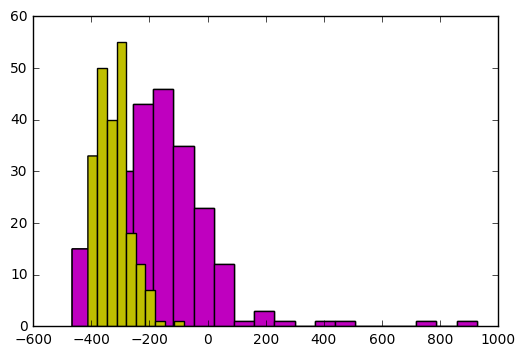

In [145]:
"""
#Exploratory analysis
# 原 plt.hist(nodulemeanhu, bins=20)
plt.hist(nodulemeanhu.dropna().values, bins=20)
plt.hist(nonnodulemeanhu)
plt.show()
"""
# transfer to dataframe
# 會有空值問題, 所以先轉為dataframe後刪除 na 值印出
df2 = pd.DataFrame(nodulemeanhu)
df3 = pd.DataFrame(nonnodulemeanhu)

plt.hist(df2.dropna().values, bins=20)
plt.hist(df3.dropna().values)
plt.show()

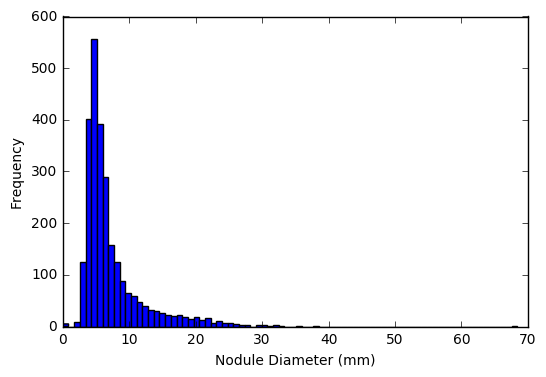

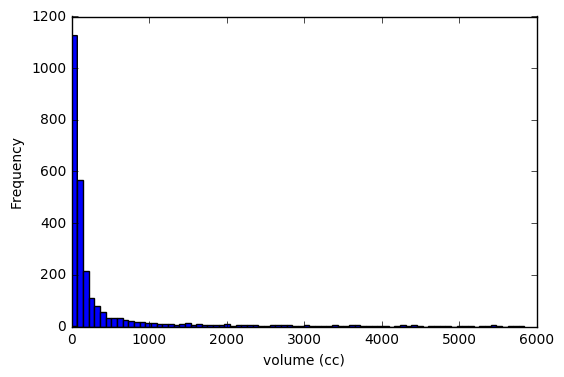

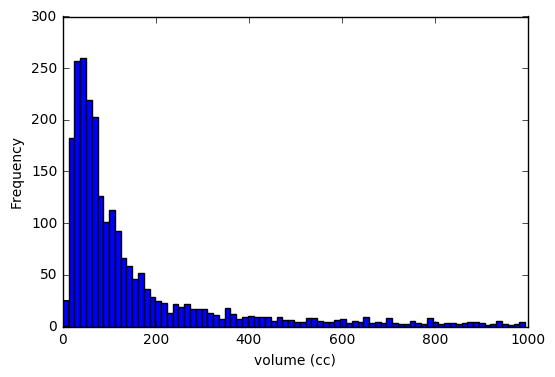

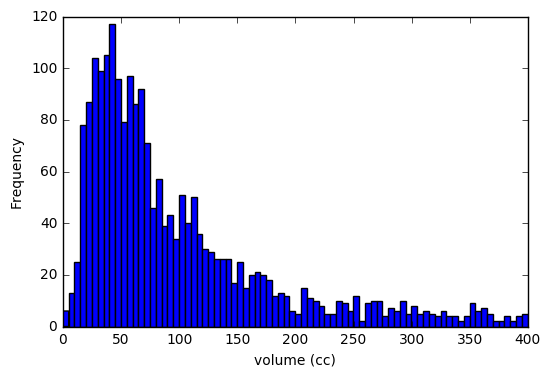

In [146]:
plt.hist(nodulelocations['eq. diam.'], bins=80)
plt.xlabel("Nodule Diameter (mm)")
plt.ylabel("Frequency")
plt.show()

plt.hist(nodulelocations['volume'].loc[nodulelocations['volume']<6000], bins=80)
plt.xlabel("volume (cc)")
plt.ylabel("Frequency")
plt.show()
plt.hist(nodulelocations['volume'].loc[nodulelocations['volume']<1000], bins=80)
plt.xlabel("volume (cc)")
plt.ylabel("Frequency")
plt.show()
plt.hist(nodulelocations['volume'].loc[nodulelocations['volume']<400], bins=80)
plt.xlabel("volume (cc)")
plt.ylabel("Frequency")
plt.show()

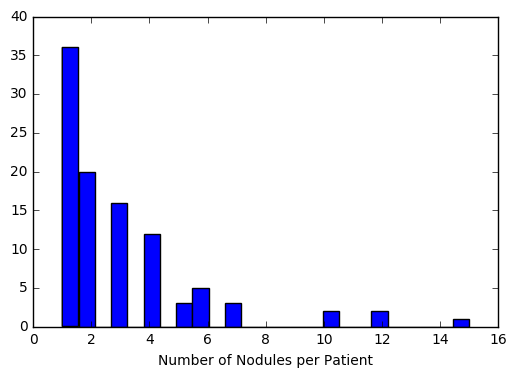

In [147]:
nodcount=[]
for i in range(len(patients)):
    coord=nodule_coordinates(nodulelocations,meta.iloc[i])
    nodcount.append(len(coord))
    
plt.hist(nodcount, bins=25)
plt.xlabel("Number of Nodules per Patient")
plt.show()